## Gestion Jour feries

In [24]:
import pandas as pd
import holidays
import locale

# Définir la locale en français
locale.setlocale(locale.LC_TIME, 'fr_FR')
# Définir la plage de dates
start_date = '2021-01-01'
end_date = '2023-06-01'


# Obtenir les jours fériés pour la France
fr_holidays = holidays.France()

# Liste des jours fériés entre les dates spécifiées
jours_feries = pd.to_datetime([date for date in fr_holidays[start_date:end_date]])

In [25]:
df_combinations = pd.MultiIndex.from_product([ pd.date_range(start_date, end_date)])
df_data = pd.DataFrame(index=df_combinations).reset_index(names='date')


# Ajouter une colonne avec le nom du jour en français
df_data['jour'] = df_data['date'].dt.strftime('%d').astype(int)

df_data['joursemaine'] = df_data['date'].dt.dayofweek

df_data['mois'] = df_data['date'].dt.month

df_data['annee'] = df_data['date'].dt.year

df_data['semaine'] = df_data['date'].dt.strftime('%W').astype(int)


# df_all_data.iloc[80:100,:]
df_data['Ferie']=0
# Vérifier si la date est un jour férié et ajouter un label correspondant
df_data.loc[df_data['date'].isin(jours_feries), 'Ferie'] = 1


# Créer une liste pour les jours précédents et suivants les jours fériés
jours_precedents = [date - pd.DateOffset(days=1) for date in df_data['date'] if date in jours_feries]
jours_suivants = [date + pd.DateOffset(days=1) for date in df_data['date'] if date in jours_feries]
    
# Ajouter les labels pour les jours précédents et suivants dans la colonne "jour"

df_data['avant_Ferie']=0
df_data['après_Ferie']=0
df_data.loc[df_data['date'].isin(jours_precedents), 'avant_Ferie'] = 1
df_data.loc[df_data['date'].isin(jours_suivants), 'après_Ferie'] = 1

df_data

,date,jour,joursemaine,mois,annee,semaine,Ferie,avant_Ferie,après_Ferie
0,2021-01-01,1,4,1,2021,0,1,0,0
1,2021-01-02,2,5,1,2021,0,0,0,1
2,2021-01-03,3,6,1,2021,0,0,0,0
3,2021-01-04,4,0,1,2021,1,0,0,0
4,2021-01-05,5,1,1,2021,1,0,0,0
...,...,...,...,...,...,...,...,...,...
877,2023-05-28,28,6,5,2023,21,0,1,0
878,2023-05-29,29,0,5,2023,22,1,0,0
879,2023-05-30,30,1,5,2023,22,0,0,1
880,2023-05-31,31,2,5,2023,22,0,0,0


## Gestion jours soldes 

In [26]:
import pandas as pd
import datetime

# Définir les dates de début et de fin des soldes d'hiver pour chaque année
soldes_hiver_dates = {
    2019: (datetime.date(2019, 1, 9), datetime.date(2019, 2, 19)),
    2020: (datetime.date(2020, 1, 8), datetime.date(2020, 2, 4)),
    2021: (datetime.date(2021, 1, 20), datetime.date(2021, 2, 16)),
    2022: (datetime.date(2022, 1, 12), datetime.date(2022, 2, 8)),
    2023: (datetime.date(2023, 1, 11), datetime.date(2023, 2, 7))
}

# Définir les dates de début et de fin des soldes d'été pour chaque année
soldes_ete_dates = {
    2019: (datetime.date(2019, 6, 26), datetime.date(2019, 8, 6)),
    2020: (datetime.date(2020, 7, 15), datetime.date(2020, 8, 11)),
    2021: (datetime.date(2021, 6, 30), datetime.date(2021, 7, 27)),
    2022: (datetime.date(2022, 6, 22), datetime.date(2022, 7, 19)),
    2023: (datetime.date(2023, 6, 28), datetime.date(2023, 7, 25))
}
def label_solde_ete(row):
    date = row['date']
    year = date.year
    debut_ete, fin_ete = soldes_ete_dates.get(year, (None, None))

    if debut_ete and fin_ete and debut_ete <= date <= fin_ete:
        delta = (date - pd.Timestamp(debut_ete)).days
        semaine_solde = delta // 7  # Diviser le nombre de jours par 7 pour obtenir le numéro de la semaine
        row['solde_ete'] = semaine_solde 
    else:
        row['solde_ete'] = 0
    return row

# Fonction pour attribuer le label de la semaine de solde
def label_solde_hiver(row):
    date = row['date']
    year = date.year
    debut_hiver, fin_hiver = soldes_hiver_dates.get(year, (None, None))

    if debut_hiver and fin_hiver and debut_hiver <= date <= fin_hiver:
        delta = (date - pd.Timestamp(debut_hiver) ).days
        semaine_solde = delta // 7  # Diviser le nombre de jours par 7 pour obtenir le numéro de la semaine
        row['solde_hiver'] = semaine_solde 
        
    else:
        row['solde_hiver'] = 0
    return row

# Appliquer la fonction à chaque ligne du dataframe
df_data['solde_ete'] = 0
df_data['solde_hiver'] = 0
df_data = df_data.apply(label_solde_hiver, axis=1)
df_data = df_data.apply(label_solde_ete, axis=1)
df_data


/var/folders/py/4rt338cj1ks4z3332m7l3f880000gp/T/ipykernel_11277/1976678666.py:40: FutureWarning: Comparison of Timestamp with datetime.date is deprecated in order to match the standard library behavior. In a future version these will be considered non-comparable. Use 'ts == pd.Timestamp(date)' or 'ts.date() == date' instead.
  if debut_hiver and fin_hiver and debut_hiver <= date <= fin_hiver:
/var/folders/py/4rt338cj1ks4z3332m7l3f880000gp/T/ipykernel_11277/1976678666.py:26: FutureWarning: Comparison of Timestamp with datetime.date is deprecated in order to match the standard library behavior. In a future version these will be considered non-comparable. Use 'ts == pd.Timestamp(date)' or 'ts.date() == date' instead.
  if debut_ete and fin_ete and debut_ete <= date <= fin_ete:


,date,jour,joursemaine,mois,annee,semaine,Ferie,avant_Ferie,après_Ferie,solde_ete,solde_hiver
0,2021-01-01,1,4,1,2021,0,1,0,0,0,0
1,2021-01-02,2,5,1,2021,0,0,0,1,0,0
2,2021-01-03,3,6,1,2021,0,0,0,0,0,0
3,2021-01-04,4,0,1,2021,1,0,0,0,0,0
4,2021-01-05,5,1,1,2021,1,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...
877,2023-05-28,28,6,5,2023,21,0,1,0,0,0
878,2023-05-29,29,0,5,2023,22,1,0,0,0,0
879,2023-05-30,30,1,5,2023,22,0,0,1,0,0
880,2023-05-31,31,2,5,2023,22,0,0,0,0,0


In [28]:
df_data.solde_hiver.value_counts()

0    819
1     21
2     21
3     21
Name: solde_hiver, dtype: int64

In [29]:
df_data.to_csv('data/ferie_solde.csv', index=False)

In [31]:
df_tel = pd.read_csv('data/telephonie_clean.csv', index_col="date_appel", parse_dates = True)

df_tel = df_tel.loc[ "2021-01-01":,:]

df = df_tel[(df_tel["Entite"] == 'Entite 1') & (df_tel["Famille"] == 'F2')]
df = df.reset_index(names="date")


In [32]:
df.merge(df_data,on="date",how="left")

,date,Entite,Famille,Nombre_entrants_corrige,jour,joursemaine,mois,annee,semaine,Ferie,avant_Ferie,après_Ferie,solde_ete,solde_hiver
0,2021-01-02,Entite 1,F2,13.200000,2,5,1,2021,0,0,0,1,0,0
1,2021-01-04,Entite 1,F2,171.637875,4,0,1,2021,1,0,0,0,0,0
2,2021-01-05,Entite 1,F2,139.823805,5,1,1,2021,1,0,0,0,0,0
3,2021-01-06,Entite 1,F2,186.613478,6,2,1,2021,1,0,0,0,0,0
4,2021-01-07,Entite 1,F2,143.625028,7,3,1,2021,1,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
642,2023-02-10,Entite 1,F2,62.526316,10,4,2,2023,6,0,0,0,0,0
643,2023-02-11,Entite 1,F2,16.170000,11,5,2,2023,6,0,0,0,0,0
644,2023-02-13,Entite 1,F2,75.822353,13,0,2,2023,7,0,0,0,0,0
645,2023-02-14,Entite 1,F2,65.276712,14,1,2,2023,7,0,0,0,0,0


In [33]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 647 entries, 0 to 646
Data columns (total 4 columns):
 #   Column                   Non-Null Count  Dtype         
---  ------                   --------------  -----         
 0   date                     647 non-null    datetime64[ns]
 1   Entite                   647 non-null    object        
 2   Famille                  647 non-null    object        
 3   Nombre_entrants_corrige  647 non-null    float64       
dtypes: datetime64[ns](1), float64(1), object(2)
memory usage: 20.3+ KB


## gestion de Noel 

In [ ]:
import pandas as pd
import datetime

# Définir les dates de début et de fin des soldes d'hiver pour chaque année
Noel_dates = {
    2019: (datetime.date(2019, 11, 1), datetime.date(2019, 12, 31)),
    2020: (datetime.date(2020, 11, 1), datetime.date(2020, 12, 31)),
    2021: (datetime.date(2021, 11, 1), datetime.date(2021, 12, 31)),
    2022: (datetime.date(2022, 11, 1), datetime.date(2022, 12, 31)),
    2023: (datetime.date(2023, 11, 1), datetime.date(2023, 12, 31))
}

# Définir les labels pour les semaines de soldes
labels = ['premiere_semaine', 'deuxieme_semaine', 'troisieme_semaine', 'quatrieme_semaine','ciquieme_semaine', 'sixieme_semaine', 'setieme_semaine','huite_semaine','neufieme_semaine']

# Fonction pour attribuer le label de la semaine de solde
def label_solde(row):
    date = row['date']
    year = date.year
    debut_Noel, fin_Noel = Noel_dates.get(year, (None, None))

    if debut_Noel and fin_Noel and debut_Noel <= date <= fin_Noel:
        delta = (date - pd.Timestamp(debut_Noel) ).days
        semaine_solde = delta // 7  # Diviser le nombre de jours par 7 pour obtenir le numéro de la semaine
        row['Noel'] = f"{labels[semaine_solde]}" 
    else:
        row['Noel'] = 'None'
    return row

# Appliquer la fonction à chaque ligne du dataframe
df_all_data['Noel'] = 'None'
df_all_data = df_all_data.apply(label_solde, axis=1)


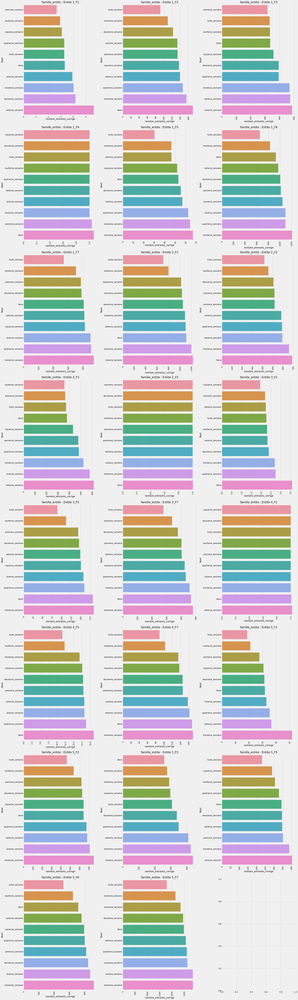

In [ ]:
import holidays
import matplotlib.pyplot as plt 
import seaborn as sns 

# Définir la plage de dates
start_date = '2019-01-02'
end_date = '2019-02-15'

# Obtenir les jours fériés pour la France
fr_holidays = holidays.France()

# Liste des jours fériés entre les dates spécifiées
jours_feries = [pd.to_datetime(date.strftime('%Y-%m-%d')) for date in fr_holidays[start_date:end_date]]

df_phone_entite_instance=df_all_data.groupby('famille_entite')
import locale

# Définir la locale en français
locale.setlocale(locale.LC_TIME, 'fr_FR')

# Créer la grille de sous-tracés avec une taille de 3x3
fig, axes = plt.subplots(8, 3, figsize=(30, 100), sharex=False, sharey=False)

# Parcourir chaque entité et instance
for i, (famille_entite , group_df) in enumerate(df_phone_entite_instance):
    # Déterminer les indices de sous-tracé
    row = i // 3
    col = i % 3

    # Compter le nombre d'appels par jour et par type (jour ou jour férié)
    group_df = group_df[['Noel','nombre_entrants_corrige']].groupby('Noel').mean().reset_index()
    
    # Trier les données par le nombre d'appels
    group_df = group_df.sort_values(by='nombre_entrants_corrige', ascending=True)
    # print(group_df)
    # Tracer le graphique en barres empilées
    sns.barplot(data=group_df, x='nombre_entrants_corrige', y='Noel', ax=axes[row, col])

    axes[row, col].tick_params(axis='x', rotation=90)

    # Ajouter un titre pour chaque sous-tracé
    axes[row, col].set_title(f"famille_entite : {famille_entite}")

# Ajuster les espacements entre les sous-tracés
plt.tight_layout()

# Afficher le graphe
plt.show()


In [ ]:
import datetime
import pandas as pd
import xgboost as xgb
import matplotlib.pyplot as plt
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import OneHotEncoder, OrdinalEncoder, StandardScaler
from sklearn.metrics import r2_score, mean_absolute_error, mean_absolute_percentage_error, mean_squared_error
import mlflow
import mlflow.sklearn
import os 
# Convertir la colonne "date" en objets datetime
df_all_data['date'] = pd.to_datetime(df_all_data['date'])
# df_all_data[df_all_data['']]
# Définir la date initiale
date_initiale = datetime.datetime(2022, 10, 15)
# Parcourir chaque groupe de famille_entite
for famille_entite, group_df in df_all_data.groupby('famille_entite'):
    mlflow.set_experiment(f"{famille_entite}")
    with mlflow.start_run(run_name='run_Desc_Nov',nested=True):

        # Séparer les données en ensemble d'entraînement et ensemble de test
        train_df = group_df.loc[group_df['date'] <= date_initiale]
        test_df = group_df.loc[group_df['date'] > date_initiale]

        # Séparer les caractéristiques et la variable cible
        X_train = train_df.drop(['date', 'nombre_entrants_corrige'], axis=1)
        X_test = test_df.drop(['date', 'nombre_entrants_corrige'], axis=1)
        y_train = train_df['nombre_entrants_corrige']
        y_test = test_df['nombre_entrants_corrige']

        cols_cat = X_train.select_dtypes('object').columns  # Ajoutez d'autres colonnes catégorielles si nécessaire
        cols_num = X_train.select_dtypes(exclude='object').columns

        # Créer un pipeline pour l'encodage des colonnes catégorielles et l'entraînement du modèle
        pipeline = Pipeline([
            ('encoding', ColumnTransformer([
                ('onehot', OneHotEncoder(), cols_cat),
                ('scaler', StandardScaler(with_mean=False), cols_num)
            ])),
            ('regressor', xgb.XGBRegressor())
        ])

        # Entraîner le modèle
        pipeline.fit(X_train, y_train)

        # Obtenir les noms des features après l'encodage
        encoded_feature_names = []
        encoded_feature_names += list(pipeline.named_steps['encoding'].transformers_[0][1].get_feature_names_out(cols_cat))
        encoded_feature_names += list(cols_num)

        # Obtenir l'importance des caractéristiques
        importance = pipeline.named_steps['regressor'].feature_importances_

        # Créer un DataFrame avec les noms des features et leur importance
        feature_importance_df = pd.DataFrame({'Feature': encoded_feature_names, 'Importance': importance})

        # Trier les features par importance décroissante
        feature_importance_df = feature_importance_df.sort_values('Importance', ascending=True).reset_index(drop=True)

        # Prédire les valeurs pour l'ensemble de test
        y_pred = pipeline.predict(X_test)

        # Afficher les noms des features les plus importants
        print(f"Les noms des features les plus importants pour la famille_entite '{famille_entite}':")

        # Afficher le meilleur score
        print('R2:', r2_score(y_pred=y_pred, y_true=y_test))
        print('MAE:', mean_absolute_error(y_pred=y_pred, y_true=y_test))
        print('MAPE:', mean_absolute_percentage_error(y_pred=y_pred, y_true=y_test))
        print('MSE:', mean_squared_error(y_pred=y_pred, y_true=y_test))

        # Tracer le barplot des features les plus importants
        plt.figure(figsize=(14, 14))
        plt.barh(feature_importance_df['Feature'][:20], feature_importance_df['Importance'][:20])
        plt.xlabel('Importance')
        plt.ylabel('Feature')
        plt.title(f"Importance des variables pour la famille_entite '{famille_entite}'")
        # Ajouter une distance marginale de 0.2 du côté de l'axe X
        plt.subplots_adjust(left=0.3)
        plt.savefig("barplot.png")
        plt.close()

        # Enregistrer le barplot sur MLflow
        mlflow.log_artifact("barplot.png")

        df_test.plot(figsize=(15, 15))
        plt.xlabel('Date')
        plt.ylabel('Valeurs')
        plt.title('Comparaison entre nombre_entrants_corrige et Prediction')
        plt.savefig("comparaison.png")
        plt.close()

        # Enregistrer la comparaison sur MLflow
        mlflow.log_artifact("comparaison.png")

        # Supprimer les fichiers locaux après les avoir enregistrés sur MLflow
        os.remove("barplot.png")
        os.remove("comparaison.png")

        # Enregistrer les métriques et les paramètres dans MLflow
        mlflow.log_metric('R2', r2_score(y_pred=y_pred, y_true=y_test))
        mlflow.log_metric('MAE', mean_absolute_error(y_pred=y_pred, y_true=y_test))
        mlflow.log_metric('MAPE', mean_absolute_percentage_error(y_pred=y_pred, y_true=y_test))
        mlflow.log_metric('MSE', mean_squared_error(y_pred=y_pred, y_true=y_test))
        mlflow.log_params({
            'famille_entite': famille_entite,
            'encoding_cols_cat': list(cols_cat),
            'encoding_cols_num': list(cols_num)
        })

        # Terminer l'enregistrement MLflow
        mlflow.end_run()


Les noms des features les plus importants pour la famille_entite 'Entite 1_F1':
R2: 0.02093910548299982
MAE: 4.315460046570907
MAPE: 0.8536669360385127
MSE: 35.93267201840899
Les noms des features les plus importants pour la famille_entite 'Entite 1_F2':
R2: -5.384684107773168
MAE: 68.2342579939848
MAPE: 4.413254807857803
MSE: 7602.191402293356
Les noms des features les plus importants pour la famille_entite 'Entite 1_F3':
R2: 0.7462212972128732
MAE: 70.51224618691231
MAPE: 10.784395573232525
MSE: 15792.24923863655
Les noms des features les plus importants pour la famille_entite 'Entite 1_F4':
R2: -0.27850560095441
MAE: 0.029187019278363483
MAPE: 0.02107956545139716
MSE: 0.020450681170663447
Les noms des features les plus importants pour la famille_entite 'Entite 1_F5':
R2: 0.4788735013984161
MAE: 10.842607897196572
MAPE: 1.5715211891890508
MSE: 256.58401412780813
Les noms des features les plus importants pour la famille_entite 'Entite 1_F6':
R2: 0.727824606678296
MAE: 155.490673268345

## vacance d'été 

In [ ]:
import pandas as pd
import datetime

# Définir les dates de début et de fin des soldes d'hiver pour chaque année
Noel_dates = {
    2019: (datetime.date(2019, 7, 1), datetime.date(2019, 8, 31)),
    2020: (datetime.date(2020, 7, 1), datetime.date(2020, 8, 31)),
    2021: (datetime.date(2021, 7, 1), datetime.date(2021, 8, 31)),
    2022: (datetime.date(2022, 7, 1), datetime.date(2022, 8, 31)),
    2023: (datetime.date(2023, 7, 1), datetime.date(2023, 8, 31))
}

# Définir les labels pour les semaines de soldes
labels = ['premiere_semaine', 'deuxieme_semaine', 'troisieme_semaine', 'quatrieme_semaine','ciquieme_semaine', 'sixieme_semaine', 'setieme_semaine','huite_semaine','neufieme_semaine','dixieme_semaine']

# Fonction pour attribuer le label de la semaine de solde
def label_solde(row):
    date = row['date']
    year = date.year
    debut_Noel, fin_Noel = Noel_dates.get(year, (None, None))

    if debut_Noel and fin_Noel and debut_Noel <= date <= fin_Noel:
        delta = (date - pd.Timestamp(debut_Noel) ).days
        semaine_solde = delta // 7  # Diviser le nombre de jours par 7 pour obtenir le numéro de la semaine
        print
        row['ETE'] = f"{labels[semaine_solde]}" 
    else:
        row['ETE'] = 'None'
    return row

# Appliquer la fonction à chaque ligne du dataframe
df_all_data['ETE'] = 'None'
df_all_data = df_all_data.apply(label_solde, axis=1)



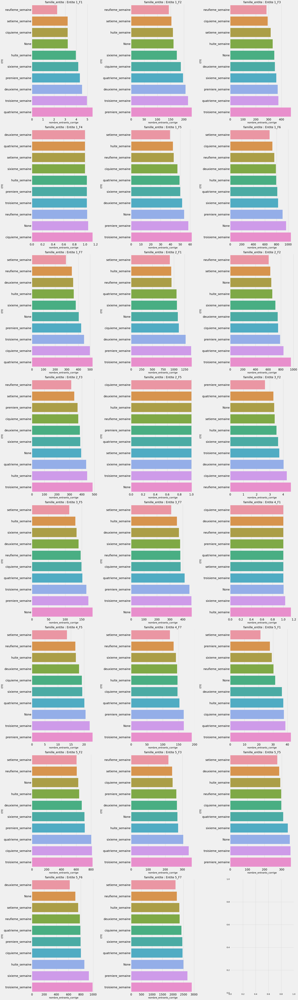

In [ ]:
import holidays
import matplotlib.pyplot as plt 
import seaborn as sns 

# Définir la plage de dates
start_date = '2019-01-02'
end_date = '2019-02-15'

# Obtenir les jours fériés pour la France
fr_holidays = holidays.France()

# Liste des jours fériés entre les dates spécifiées
jours_feries = [pd.to_datetime(date.strftime('%Y-%m-%d')) for date in fr_holidays[start_date:end_date]]

df_phone_entite_instance=df_all_data.groupby('famille_entite')
import locale

# Définir la locale en français
locale.setlocale(locale.LC_TIME, 'fr_FR')

# Créer la grille de sous-tracés avec une taille de 3x3
fig, axes = plt.subplots(8, 3, figsize=(30, 100), sharex=False, sharey=False)

# Parcourir chaque entité et instance
for i, (famille_entite , group_df) in enumerate(df_phone_entite_instance):
    # Déterminer les indices de sous-tracé
    row = i // 3
    col = i % 3

    # Compter le nombre d'appels par jour et par type (jour ou jour férié)
    group_df = group_df[['ETE','nombre_entrants_corrige']].groupby('ETE').mean().reset_index()
    
    # Trier les données par le nombre d'appels
    group_df = group_df.sort_values(by='nombre_entrants_corrige', ascending=True)
    # print(group_df)
    # Tracer le graphique en barres empilées
    sns.barplot(data=group_df, x='nombre_entrants_corrige', y='ETE', ax=axes[row, col])

    axes[row, col].tick_params(axis='x',labelsize=20)
    axes[row,col].tick_params(axis='y', labelsize=20)

    # Ajouter un titre pour chaque sous-tracé
    axes[row, col].set_title(f"famille_entite : {famille_entite}")

# Ajuster les espacements entre les sous-tracés
plt.tight_layout()

# Afficher le graphe
plt.show()


In [ ]:
import datetime
import pandas as pd
import xgboost as xgb
import matplotlib.pyplot as plt
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import OneHotEncoder, OrdinalEncoder, StandardScaler
from sklearn.metrics import r2_score, mean_absolute_error, mean_absolute_percentage_error, mean_squared_error
import mlflow
import mlflow.sklearn
import os 
# Convertir la colonne "date" en objets datetime
df_all_data['date'] = pd.to_datetime(df_all_data['date'])
# df_all_data[df_all_data['']]
# Définir la date initiale
date_initiale = datetime.datetime(2022, 10, 15)
# Parcourir chaque groupe de famille_entite
for famille_entite, group_df in df_all_data.groupby('famille_entite'):
    mlflow.set_experiment(f"{famille_entite}")
    with mlflow.start_run(run_name='run_jour_ete',nested=True):

        # Séparer les données en ensemble d'entraînement et ensemble de test
        train_df = group_df.loc[group_df['date'] <= date_initiale]
        test_df = group_df.loc[group_df['date'] > date_initiale]

        # Séparer les caractéristiques et la variable cible
        X_train = train_df.drop(['date', 'nombre_entrants_corrige'], axis=1)
        X_test = test_df.drop(['date', 'nombre_entrants_corrige'], axis=1)
        y_train = train_df['nombre_entrants_corrige']
        y_test = test_df['nombre_entrants_corrige']

        cols_cat = X_train.select_dtypes('object').columns  # Ajoutez d'autres colonnes catégorielles si nécessaire
        cols_num = X_train.select_dtypes(exclude='object').columns

        # Créer un pipeline pour l'encodage des colonnes catégorielles et l'entraînement du modèle
        pipeline = Pipeline([
            ('encoding', ColumnTransformer([
                ('onehot', OneHotEncoder(), cols_cat),
                ('scaler', StandardScaler(with_mean=False), cols_num)
            ])),
            ('regressor', xgb.XGBRegressor())
        ])

        # Entraîner le modèle
        pipeline.fit(X_train, y_train)

        # Obtenir les noms des features après l'encodage
        encoded_feature_names = []
        encoded_feature_names += list(pipeline.named_steps['encoding'].transformers_[0][1].get_feature_names_out(cols_cat))
        encoded_feature_names += list(cols_num)

        # Obtenir l'importance des caractéristiques
        importance = pipeline.named_steps['regressor'].feature_importances_

        # Créer un DataFrame avec les noms des features et leur importance
        feature_importance_df = pd.DataFrame({'Feature': encoded_feature_names, 'Importance': importance})

        # Trier les features par importance décroissante
        feature_importance_df = feature_importance_df.sort_values('Importance', ascending=True).reset_index(drop=True)

        # Prédire les valeurs pour l'ensemble de test
        y_pred = pipeline.predict(X_test)

        # Afficher les noms des features les plus importants
        print(f"Les noms des features les plus importants pour la famille_entite '{famille_entite}':")

        # Afficher le meilleur score
        print('R2:', r2_score(y_pred=y_pred, y_true=y_test))
        print('MAE:', mean_absolute_error(y_pred=y_pred, y_true=y_test))
        print('MAPE:', mean_absolute_percentage_error(y_pred=y_pred, y_true=y_test))
        print('MSE:', mean_squared_error(y_pred=y_pred, y_true=y_test))

        # Tracer le barplot des features les plus importants
        plt.figure(figsize=(14, 16))
        plt.barh(feature_importance_df['Feature'][:20], feature_importance_df['Importance'][:20])
        plt.xlabel('Importance')
        plt.ylabel('Feature')
        plt.title(f"Importance des variables pour la famille_entite '{famille_entite}'")
        # Ajouter une distance marginale de 0.2 du côté de l'axe X
        plt.subplots_adjust(left=0.3)
        plt.savefig("barplot.png")
        plt.close()

        # Enregistrer le barplot sur MLflow
        mlflow.log_artifact("barplot.png")

        df_test.plot(figsize=(15, 15))
        plt.xlabel('Date')
        plt.ylabel('Valeurs')
        plt.title('Comparaison entre nombre_entrants_corrige et Prediction')
        plt.savefig("comparaison.png")
        plt.close()

        # Enregistrer la comparaison sur MLflow
        mlflow.log_artifact("comparaison.png")

        # Supprimer les fichiers locaux après les avoir enregistrés sur MLflow
        os.remove("barplot.png")
        os.remove("comparaison.png")

        # Enregistrer les métriques et les paramètres dans MLflow
        mlflow.log_metric('R2', r2_score(y_pred=y_pred, y_true=y_test))
        mlflow.log_metric('MAE', mean_absolute_error(y_pred=y_pred, y_true=y_test))
        mlflow.log_metric('MAPE', mean_absolute_percentage_error(y_pred=y_pred, y_true=y_test))
        mlflow.log_metric('MSE', mean_squared_error(y_pred=y_pred, y_true=y_test))
        mlflow.log_params({
            'famille_entite': famille_entite,
            'encoding_cols_cat': list(cols_cat),
            'encoding_cols_num': list(cols_num)
        })

        # Terminer l'enregistrement MLflow
        mlflow.end_run()


Les noms des features les plus importants pour la famille_entite 'Entite 1_F1':
R2: 0.0557296474434934
MAE: 4.123476282234053
MAPE: 0.7390259925672734
MSE: 34.655818718874606
Les noms des features les plus importants pour la famille_entite 'Entite 1_F2':
R2: -4.98164502723358
MAE: 64.38953575258687
MAPE: 4.303261780877202
MSE: 7122.296049422888
Les noms des features les plus importants pour la famille_entite 'Entite 1_F3':
R2: 0.7374424254225528
MAE: 69.41344241915127
MAPE: 9.877552402108785
MSE: 16338.544612614674
Les noms des features les plus importants pour la famille_entite 'Entite 1_F4':
R2: -0.37296860355981565
MAE: 0.02773805071667927
MAPE: 0.019608602048904914
MSE: 0.021961689606813103
Les noms des features les plus importants pour la famille_entite 'Entite 1_F5':
R2: 0.46350276924940914
MAE: 10.724192358372733
MAPE: 1.5622716078514354
MSE: 264.1520118509306
Les noms des features les plus importants pour la famille_entite 'Entite 1_F6':
R2: 0.6920997973390146
MAE: 165.50446937

In [ ]:
import datetime
import pandas as pd
import xgboost as xgb
import matplotlib.pyplot as plt
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import OneHotEncoder, OrdinalEncoder, StandardScaler
from sklearn.metrics import r2_score, mean_absolute_error, mean_absolute_percentage_error, mean_squared_error
import mlflow
import mlflow.sklearn
import os 
# Convertir la colonne "date" en objets datetime
df_all_data['date'] = pd.to_datetime(df_all_data['date'])
# df_all_data[df_all_data['']]
# Définir la date initiale
date_initiale = datetime.datetime(2022, 10, 15)
# Parcourir chaque groupe de famille_entite
for famille_entite, group_df in df_all_data.groupby('famille_entite'):
    mlflow.set_experiment(f"{famille_entite}")
    with mlflow.start_run(run_name='run_jour_ferie',nested=True):

        # Séparer les données en ensemble d'entraînement et ensemble de test
        train_df = group_df.loc[group_df['date'] <= date_initiale]
        test_df = group_df.loc[group_df['date'] > date_initiale]

        # Séparer les caractéristiques et la variable cible
        X_train = train_df.drop(['date', 'nombre_entrants_corrige'], axis=1)
        X_test = test_df.drop(['date', 'nombre_entrants_corrige'], axis=1)
        y_train = train_df['nombre_entrants_corrige']
        y_test = test_df['nombre_entrants_corrige']

        cols_cat = X_train.select_dtypes('object').columns  # Ajoutez d'autres colonnes catégorielles si nécessaire
        cols_num = X_train.select_dtypes(exclude='object').columns

        # Créer un pipeline pour l'encodage des colonnes catégorielles et l'entraînement du modèle
        pipeline = Pipeline([
            ('encoding', ColumnTransformer([
                ('onehot', OneHotEncoder(), cols_cat),
                ('scaler', StandardScaler(with_mean=False), cols_num)
            ])),
            ('regressor', xgb.XGBRegressor())
        ])

        # Entraîner le modèle
        pipeline.fit(X_train, y_train)

        # Obtenir les noms des features après l'encodage
        encoded_feature_names = []
        encoded_feature_names += list(pipeline.named_steps['encoding'].transformers_[0][1].get_feature_names_out(cols_cat))
        encoded_feature_names += list(cols_num)

        # Obtenir l'importance des caractéristiques
        importance = pipeline.named_steps['regressor'].feature_importances_

        # Créer un DataFrame avec les noms des features et leur importance
        feature_importance_df = pd.DataFrame({'Feature': encoded_feature_names, 'Importance': importance})

        # Trier les features par importance décroissante
        feature_importance_df = feature_importance_df.sort_values('Importance', ascending=True).reset_index(drop=True)

        # Prédire les valeurs pour l'ensemble de test
        y_pred = pipeline.predict(X_test)

        # Afficher les noms des features les plus importants
        print(f"Les noms des features les plus importants pour la famille_entite '{famille_entite}':")

        # Afficher le meilleur score
        print('R2:', r2_score(y_pred=y_pred, y_true=y_test))
        print('MAE:', mean_absolute_error(y_pred=y_pred, y_true=y_test))
        print('MAPE:', mean_absolute_percentage_error(y_pred=y_pred, y_true=y_test))
        print('MSE:', mean_squared_error(y_pred=y_pred, y_true=y_test))

        # Tracer le barplot des features les plus importants
        plt.figure(figsize=(14, 16))
        plt.barh(feature_importance_df['Feature'][:20], feature_importance_df['Importance'][:20])
        plt.xlabel('Importance')
        plt.ylabel('Feature')
        plt.title(f"Importance des variables pour la famille_entite '{famille_entite}'")
                # Ajouter une distance marginale de 0.2 du côté de l'axe X
        plt.subplots_adjust(left=0.3)
        plt.savefig("barplot.png")
        plt.close()

        # Enregistrer le barplot sur MLflow
        mlflow.log_artifact("barplot.png")

        df_test.plot(figsize=(15, 15))
        plt.xlabel('Date')
        plt.ylabel('Valeurs')
        plt.title('Comparaison entre nombre_entrants_corrige et Prediction')
        plt.savefig("comparaison.png")
        plt.close()

        # Enregistrer la comparaison sur MLflow
        mlflow.log_artifact("comparaison.png")

        # Supprimer les fichiers locaux après les avoir enregistrés sur MLflow
        os.remove("barplot.png")
        os.remove("comparaison.png")

        # Enregistrer les métriques et les paramètres dans MLflow
        mlflow.log_metric('R2', r2_score(y_pred=y_pred, y_true=y_test))
        mlflow.log_metric('MAE', mean_absolute_error(y_pred=y_pred, y_true=y_test))
        mlflow.log_metric('MAPE', mean_absolute_percentage_error(y_pred=y_pred, y_true=y_test))
        mlflow.log_metric('MSE', mean_squared_error(y_pred=y_pred, y_true=y_test))
        mlflow.log_params({
            'famille_entite': famille_entite,
            'encoding_cols_cat': list(cols_cat),
            'encoding_cols_num': list(cols_num)
        })

        # Terminer l'enregistrement MLflow
        mlflow.end_run()
    

Les noms des features les plus importants pour la famille_entite 'Entite 1_F1':
R2: 0.0557296474434934
MAE: 4.123476282234053
MAPE: 0.7390259925672734
MSE: 34.655818718874606
Les noms des features les plus importants pour la famille_entite 'Entite 1_F2':
R2: -4.98164502723358
MAE: 64.38953575258687
MAPE: 4.303261780877202
MSE: 7122.296049422888
Les noms des features les plus importants pour la famille_entite 'Entite 1_F3':
R2: 0.7374424254225528
MAE: 69.41344241915127
MAPE: 9.877552402108785
MSE: 16338.544612614674
Les noms des features les plus importants pour la famille_entite 'Entite 1_F4':
R2: -0.37296860355981565
MAE: 0.02773805071667927
MAPE: 0.019608602048904914
MSE: 0.021961689606813103
Les noms des features les plus importants pour la famille_entite 'Entite 1_F5':
R2: 0.46350276924940914
MAE: 10.724192358372733
MAPE: 1.5622716078514354
MSE: 264.1520118509306
Les noms des features les plus importants pour la famille_entite 'Entite 1_F6':
R2: 0.6920997973390146
MAE: 165.50446937

## vacance  Noel 

In [ ]:
import pandas as pd
import datetime

# Définir les dates de début et de fin des soldes d'hiver pour chaque année
vacance_Noel_desc = {
    2019: (datetime.date(2019, 12, 21), datetime.date(2019, 12, 31)),
    2020: (datetime.date(2020, 12, 19), datetime.date(2020, 12, 31)),
    2021: (datetime.date(2021, 12, 18), datetime.date(2021, 12, 31)),
    2022: (datetime.date(2022, 12, 18), datetime.date(2022, 12, 31)),
    2023: (datetime.date(2023, 12, 23), datetime.date(2023, 12, 31))
}

# Définir les dates de début et de fin des soldes d'été pour chaque année
Vacance_Noel_Jan = {
    2019: (datetime.date(2019, 1, 1), datetime.date(2019, 1, 6)),
    2020: (datetime.date(2020, 1, 1), datetime.date(2020, 1, 4)),
    2021: (datetime.date(2021, 1, 1), datetime.date(2021, 1, 3)),
    2022: (datetime.date(2022, 1, 1), datetime.date(2022, 1, 3)),
    2023: (datetime.date(2023, 1, 1), datetime.date(2023, 1, 6))
}

# Définir les labels pour les semaines de soldes
labels_des = ['premiere_semaine', 'deuxieme_semaine']
labels_Jan = [ 'deuxieme_semaine']

# , 'troisieme_semaine', 'quatrieme_semaine','ciquieme_semaine', 'sixieme_semaine', 'setieme_semaine','huite_semaine']

# Fonction pour attribuer le label de la semaine de solde
def label_solde(row):
    date = row['date']
    year = date.year
    debut_Noel_desc, fin_Noel_desc = vacance_Noel_desc.get(year, (None, None))
    debut_Noel_Jan, fin_Noel_Jan = Vacance_Noel_Jan.get(year, (None, None))

    if debut_Noel_desc and fin_Noel_desc and debut_Noel_desc <= date <= fin_Noel_desc:
        delta = (date - pd.Timestamp(debut_Noel_desc) ).days
        semaine_Noel_des = delta // 7  # Diviser le nombre de jours par 7 pour obtenir le numéro de la semaine
        row['Vacance_Noel'] = f"{labels_des[semaine_Noel_des]}" 
        
    elif debut_Noel_Jan and fin_Noel_Jan and debut_Noel_Jan <= date <= fin_Noel_Jan:
        delta = (date - pd.Timestamp(debut_Noel_Jan)).days
        semaine_Noel_Jan = delta // 7  # Diviser le nombre de jours par 7 pour obtenir le numéro de la semaine
        row['Vacance_Noel'] = f"{labels_Jan[semaine_Noel_Jan]}"
    else:
        row['Vacance_Noel']='None'
    return row

# Appliquer la fonction à chaque ligne du dataframe
df_all_data['Vacance_Noel']= 'None'
df_all_data = df_all_data.apply(label_solde, axis=1)



In [ ]:
import datetime
import pandas as pd
import xgboost as xgb
import matplotlib.pyplot as plt
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import OneHotEncoder, OrdinalEncoder, StandardScaler
from sklearn.metrics import r2_score, mean_absolute_error, mean_absolute_percentage_error, mean_squared_error
import mlflow
import mlflow.sklearn
import os 
# Convertir la colonne "date" en objets datetime
df_all_data['date'] = pd.to_datetime(df_all_data['date'])
# df_all_data[df_all_data['']]
# Définir la date initiale
date_initiale = datetime.datetime(2022, 10, 15)
# Parcourir chaque groupe de famille_entite
for famille_entite, group_df in df_all_data.groupby('famille_entite'):
    mlflow.set_experiment(f"{famille_entite}")
    with mlflow.start_run(run_name='run_jour_Noel',nested=True):

        # Séparer les données en ensemble d'entraînement et ensemble de test
        train_df = group_df.loc[group_df['date'] <= date_initiale]
        test_df = group_df.loc[group_df['date'] > date_initiale]

        # Séparer les caractéristiques et la variable cible
        X_train = train_df.drop(['date', 'nombre_entrants_corrige'], axis=1)
        X_test = test_df.drop(['date', 'nombre_entrants_corrige'], axis=1)
        y_train = train_df['nombre_entrants_corrige']
        y_test = test_df['nombre_entrants_corrige']

        cols_cat = X_train.select_dtypes('object').columns  # Ajoutez d'autres colonnes catégorielles si nécessaire
        cols_num = X_train.select_dtypes(exclude='object').columns

        # Créer un pipeline pour l'encodage des colonnes catégorielles et l'entraînement du modèle
        pipeline = Pipeline([
            ('encoding', ColumnTransformer([
                ('onehot', OneHotEncoder(), cols_cat),
                ('scaler', StandardScaler(with_mean=False), cols_num)
            ])),
            ('regressor', xgb.XGBRegressor())
        ])

        # Entraîner le modèle
        pipeline.fit(X_train, y_train)

        # Obtenir les noms des features après l'encodage
        encoded_feature_names = []
        encoded_feature_names += list(pipeline.named_steps['encoding'].transformers_[0][1].get_feature_names_out(cols_cat))
        encoded_feature_names += list(cols_num)

        # Obtenir l'importance des caractéristiques
        importance = pipeline.named_steps['regressor'].feature_importances_

        # Créer un DataFrame avec les noms des features et leur importance
        feature_importance_df = pd.DataFrame({'Feature': encoded_feature_names, 'Importance': importance})

        # Trier les features par importance décroissante
        feature_importance_df = feature_importance_df.sort_values('Importance', ascending=True).reset_index(drop=True)

        # Prédire les valeurs pour l'ensemble de test
        y_pred = pipeline.predict(X_test)

        # Afficher les noms des features les plus importants
        print(f"Les noms des features les plus importants pour la famille_entite '{famille_entite}':")

        # Afficher le meilleur score
        print('R2:', r2_score(y_pred=y_pred, y_true=y_test))
        print('MAE:', mean_absolute_error(y_pred=y_pred, y_true=y_test))
        print('MAPE:', mean_absolute_percentage_error(y_pred=y_pred, y_true=y_test))
        print('MSE:', mean_squared_error(y_pred=y_pred, y_true=y_test))

        # Tracer le barplot des features les plus importants
        plt.figure(figsize=(14, 14))
        plt.barh(feature_importance_df['Feature'][:20], feature_importance_df['Importance'][:20])
        plt.xlabel('Importance')
        plt.ylabel('Feature')
        plt.title(f"Importance des variables pour la famille_entite '{famille_entite}'")
        # Ajouter une distance marginale de 0.2 du côté de l'axe X
        plt.subplots_adjust(left=0.3)
        plt.savefig("barplot.png")
        plt.close()

        # Enregistrer le barplot sur MLflow
        mlflow.log_artifact("barplot.png")

        df_test.plot(figsize=(15, 15))
        plt.xlabel('Date')
        plt.ylabel('Valeurs')
        plt.title('Comparaison entre nombre_entrants_corrige et Prediction')
        plt.savefig("comparaison.png")
        plt.close()

        # Enregistrer la comparaison sur MLflow
        mlflow.log_artifact("comparaison.png")

        # Supprimer les fichiers locaux après les avoir enregistrés sur MLflow
        os.remove("barplot.png")
        os.remove("comparaison.png")

        # Enregistrer les métriques et les paramètres dans MLflow
        mlflow.log_metric('R2', r2_score(y_pred=y_pred, y_true=y_test))
        mlflow.log_metric('MAE', mean_absolute_error(y_pred=y_pred, y_true=y_test))
        mlflow.log_metric('MAPE', mean_absolute_percentage_error(y_pred=y_pred, y_true=y_test))
        mlflow.log_metric('MSE', mean_squared_error(y_pred=y_pred, y_true=y_test))
        mlflow.log_params({
            'famille_entite': famille_entite,
            'encoding_cols_cat': list(cols_cat),
            'encoding_cols_num': list(cols_num)
        })

        # Terminer l'enregistrement MLflow
        mlflow.end_run()


Les noms des features les plus importants pour la famille_entite 'Entite 1_F1':
R2: -0.00914799804125388
MAE: 4.294153643771347
MAPE: 0.8006781013697489
MSE: 37.036903664239624
Les noms des features les plus importants pour la famille_entite 'Entite 1_F2':
R2: -5.148809877506963
MAE: 66.02945766633232
MAPE: 5.5816161026648325
MSE: 7321.337876091616
Les noms des features les plus importants pour la famille_entite 'Entite 1_F3':
R2: 0.7178471863057896
MAE: 70.8202671460071
MAPE: 9.364726553125186
MSE: 17557.92550086115
Les noms des features les plus importants pour la famille_entite 'Entite 1_F4':
R2: -0.37296860355981565
MAE: 0.02773805071667927
MAPE: 0.019608602048904914
MSE: 0.021961689606813103
Les noms des features les plus importants pour la famille_entite 'Entite 1_F5':
R2: 0.44025240727797266
MAE: 11.061256969241441
MAPE: 1.5880476861511192
MSE: 275.599656943944
Les noms des features les plus importants pour la famille_entite 'Entite 1_F6':
R2: 0.7292306537194384
MAE: 160.2921810

## Vacance Toussaint 

In [ ]:
import pandas as pd
import datetime


# Définir les dates de début et de fin des soldes d'été pour chaque année
Vacance_Toussaint_dates = {
    2019: (datetime.date(2019, 10, 19), datetime.date(2019, 11, 4)),
    2020: (datetime.date(2020, 10, 17), datetime.date(2020, 11, 2)),
    2021: (datetime.date(2021, 10, 23), datetime.date(2021, 11, 8)),
    2022: (datetime.date(2022, 10, 22), datetime.date(2022, 11, 7)),
    2023: (datetime.date(2023, 10, 21), datetime.date(2023, 11, 6))
}

# Définir les labels pour les semaines de soldes
labels = ['premiere_semaine', 'deuxieme_semaine', 'troisieme_semaine', ]
        #   'quatrieme_semaine','ciquieme_semaine', 'sixieme_semaine', 'setieme_semaine','huite_semaine']

# Fonction pour attribuer le label de la semaine de solde
def label_solde(row):
    date = row['date']
    year = date.year
    debut_Toussaint, fin_Toussaint = Vacance_Toussaint_dates.get(year, (None, None))
 
        
    if debut_Toussaint and fin_Toussaint and debut_Toussaint <= date <= fin_Toussaint:
        delta = (date - pd.Timestamp(debut_Toussaint)).days
        semaine_Toussaint = delta // 7  # Diviser le nombre de jours par 7 pour obtenir le numéro de la semaine
        row['Vacance_Toussaint'] = f"{labels[semaine_Toussaint]}"
    else:
        row['Vacance_Toussaint']='None'
    return row

# Appliquer la fonction à chaque ligne du dataframe
df_all_data['Vacance_Toussaint']= 'None'
df_all_data = df_all_data.apply(label_solde, axis=1)



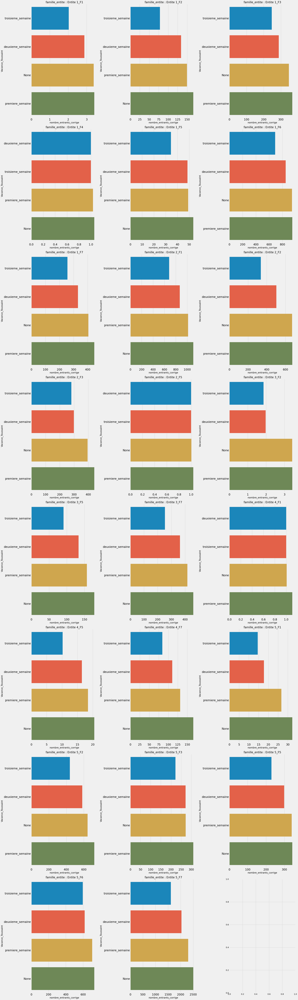

In [ ]:
import holidays
import matplotlib.pyplot as plt 
import seaborn as sns 

# Définir la plage de dates
start_date = '2019-01-02'
end_date = '2019-02-15'

# Obtenir les jours fériés pour la France
fr_holidays = holidays.France()

# Liste des jours fériés entre les dates spécifiées
jours_feries = [pd.to_datetime(date.strftime('%Y-%m-%d')) for date in fr_holidays[start_date:end_date]]

df_phone_entite_instance=df_all_data.groupby('famille_entite')
import locale

# Définir la locale en français
locale.setlocale(locale.LC_TIME, 'fr_FR')

# Créer la grille de sous-tracés avec une taille de 3x3
fig, axes = plt.subplots(8, 3, figsize=(30, 100), sharex=False, sharey=False)

# Parcourir chaque entité et instance
for i, (famille_entite , group_df) in enumerate(df_phone_entite_instance):
    # Déterminer les indices de sous-tracé
    row = i // 3
    col = i % 3

    # Compter le nombre d'appels par jour et par type (jour ou jour férié)
    group_df = group_df[['Vacance_Toussaint','nombre_entrants_corrige']].groupby('Vacance_Toussaint').mean().reset_index()
    
    # Trier les données par le nombre d'appels
    group_df = group_df.sort_values(by='nombre_entrants_corrige', ascending=True)
    # print(group_df)
    # Tracer le graphique en barres empilées
    sns.barplot(data=group_df, x='nombre_entrants_corrige', y='Vacance_Toussaint', ax=axes[row, col])

    axes[row, col].tick_params(axis='x',labelsize=20)
    axes[row,col].tick_params(axis='y', labelsize=20)

    # Ajouter un titre pour chaque sous-tracé
    axes[row, col].set_title(f"famille_entite : {famille_entite}")

# Ajuster les espacements entre les sous-tracés
plt.tight_layout()

# Afficher le graphe
plt.show()


In [ ]:
import datetime
import pandas as pd
import xgboost as xgb
import matplotlib.pyplot as plt
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import OneHotEncoder, OrdinalEncoder, StandardScaler
from sklearn.metrics import r2_score, mean_absolute_error, mean_absolute_percentage_error, mean_squared_error
import mlflow
import mlflow.sklearn
import os 
# Convertir la colonne "date" en objets datetime
df_all_data['date'] = pd.to_datetime(df_all_data['date'])
# df_all_data[df_all_data['']]
# Définir la date initiale
date_initiale = datetime.datetime(2022, 10, 15)
# Parcourir chaque groupe de famille_entite
for famille_entite, group_df in df_all_data.groupby('famille_entite'):
    mlflow.set_experiment(f"{famille_entite}")
    with mlflow.start_run(run_name='run_vacance_Toussaint',nested=True):

        # Séparer les données en ensemble d'entraînement et ensemble de test
        train_df = group_df.loc[group_df['date'] <= date_initiale]
        test_df = group_df.loc[group_df['date'] > date_initiale]

        # Séparer les caractéristiques et la variable cible
        X_train = train_df.drop(['date', 'nombre_entrants_corrige'], axis=1)
        X_test = test_df.drop(['date', 'nombre_entrants_corrige'], axis=1)
        y_train = train_df['nombre_entrants_corrige']
        y_test = test_df['nombre_entrants_corrige']

        cols_cat = X_train.select_dtypes('object').columns  # Ajoutez d'autres colonnes catégorielles si nécessaire
        cols_num = X_train.select_dtypes(exclude='object').columns

        # Créer un pipeline pour l'encodage des colonnes catégorielles et l'entraînement du modèle
        pipeline = Pipeline([
            ('encoding', ColumnTransformer([
                ('onehot', OneHotEncoder(), cols_cat),
                ('scaler', StandardScaler(with_mean=False), cols_num)
            ])),
            ('regressor', xgb.XGBRegressor())
        ])

        # Entraîner le modèle
        pipeline.fit(X_train, y_train)

        # Obtenir les noms des features après l'encodage
        encoded_feature_names = []
        encoded_feature_names += list(pipeline.named_steps['encoding'].transformers_[0][1].get_feature_names_out(cols_cat))
        encoded_feature_names += list(cols_num)

        # Obtenir l'importance des caractéristiques
        importance = pipeline.named_steps['regressor'].feature_importances_

        # Créer un DataFrame avec les noms des features et leur importance
        feature_importance_df = pd.DataFrame({'Feature': encoded_feature_names, 'Importance': importance})

        # Trier les features par importance décroissante
        feature_importance_df = feature_importance_df.sort_values('Importance', ascending=True).reset_index(drop=True)

        # Prédire les valeurs pour l'ensemble de test
        y_pred = pipeline.predict(X_test)

        # Afficher les noms des features les plus importants
        print(f"Les noms des features les plus importants pour la famille_entite '{famille_entite}':")

        # Afficher le meilleur score
        print('R2:', r2_score(y_pred=y_pred, y_true=y_test))
        print('MAE:', mean_absolute_error(y_pred=y_pred, y_true=y_test))
        print('MAPE:', mean_absolute_percentage_error(y_pred=y_pred, y_true=y_test))
        print('MSE:', mean_squared_error(y_pred=y_pred, y_true=y_test))

        # Tracer le barplot des features les plus importants
        plt.figure(figsize=(14, 14))
        plt.barh(feature_importance_df['Feature'][:20], feature_importance_df['Importance'][:20])
        plt.xlabel('Importance')
        plt.ylabel('Feature')
        plt.title(f"Importance des variables pour la famille_entite '{famille_entite}'")
         # Ajouter une distance marginale de 0.2 du côté de l'axe X
        plt.subplots_adjust(left=0.3)
        plt.savefig("barplot.png")
        plt.close()

        # Enregistrer le barplot sur MLflow
        mlflow.log_artifact("barplot.png")

        df_test.plot(figsize=(15, 15))
        plt.xlabel('Date')
        plt.ylabel('Valeurs')
        plt.title('Comparaison entre nombre_entrants_corrige et Prediction')
        plt.savefig("comparaison.png")
        plt.close()

        # Enregistrer la comparaison sur MLflow
        mlflow.log_artifact("comparaison.png")

        # Supprimer les fichiers locaux après les avoir enregistrés sur MLflow
        os.remove("barplot.png")
        os.remove("comparaison.png")

        # Enregistrer les métriques et les paramètres dans MLflow
        mlflow.log_metric('R2', r2_score(y_pred=y_pred, y_true=y_test))
        mlflow.log_metric('MAE', mean_absolute_error(y_pred=y_pred, y_true=y_test))
        mlflow.log_metric('MAPE', mean_absolute_percentage_error(y_pred=y_pred, y_true=y_test))
        mlflow.log_metric('MSE', mean_squared_error(y_pred=y_pred, y_true=y_test))
        mlflow.log_params({
            'famille_entite': famille_entite,
            'encoding_cols_cat': list(cols_cat),
            'encoding_cols_num': list(cols_num)
        })

        # Terminer l'enregistrement MLflow
        mlflow.end_run()


Les noms des features les plus importants pour la famille_entite 'Entite 1_F1':
R2: -0.016346100280332232
MAE: 4.425825894229719
MAPE: 0.96591016074657
MSE: 37.30108237708606
Les noms des features les plus importants pour la famille_entite 'Entite 1_F2':
R2: -4.7394694199844825
MAE: 65.3012882086804
MAPE: 6.179955675484792
MSE: 6833.939524934414
Les noms des features les plus importants pour la famille_entite 'Entite 1_F3':
R2: 0.7763957082653133
MAE: 70.83997877873617
MAPE: 9.887124863435098
MSE: 13914.543131954635
Les noms des features les plus importants pour la famille_entite 'Entite 1_F4':
R2: -0.44595679971423197
MAE: 0.0322039219422069
MAPE: 0.024072788352888775
MSE: 0.02312919198432442
Les noms des features les plus importants pour la famille_entite 'Entite 1_F5':
R2: 0.46510661041544055
MAE: 10.756104098358017
MAPE: 1.5373382698868694
MSE: 263.3623379320106
Les noms des features les plus importants pour la famille_entite 'Entite 1_F6':
R2: 0.7585684834921316
MAE: 149.588385362

## Vacance Hiver 

## zone A

In [ ]:
import pandas as pd
import datetime


# Définir les dates de début et de fin des soldes d'été pour chaque année
Vacance_Hiver_dates_ZA = {
    2019: (datetime.date(2019, 2, 16), datetime.date(2019, 3, 4)),
    2020: (datetime.date(2020, 2, 22), datetime.date(2020, 3, 9)),
    2021: (datetime.date(2021, 2, 6), datetime.date(2021, 2, 22)),
    2022: (datetime.date(2022, 2, 12), datetime.date(2022, 2, 28)),
    2023: (datetime.date(2023, 2, 4), datetime.date(2023, 2, 20))
}

# Définir les labels pour les semaines de soldes
labels = ['premiere_semaine', 'deuxieme_semaine', 'troisieme_semaine', ]
        #   'quatrieme_semaine','ciquieme_semaine', 'sixieme_semaine', 'setieme_semaine','huite_semaine']

# Fonction pour attribuer le label de la semaine de solde
def label_solde(row):
    date = row['date']
    year = date.year
    debut_hiver_ZA, fin_hiver_ZA = Vacance_Hiver_dates_ZA.get(year, (None, None))
 
        
    if debut_hiver_ZA and fin_hiver_ZA and debut_hiver_ZA <= date <= fin_hiver_ZA:
        delta = (date - pd.Timestamp(debut_hiver_ZA)).days
        semaine_hiver_ZA = delta // 7  # Diviser le nombre de jours par 7 pour obtenir le numéro de la semaine
        row['Vacance_hiver_ZA'] = f"{labels[semaine_hiver_ZA]}"
    else:
        row['Vacance_hiver_ZA']='None'
    return row

# Appliquer la fonction à chaque ligne du dataframe
df_all_data['Vacance_hiver_ZA']= 'None'
df_all_data = df_all_data.apply(label_solde, axis=1)


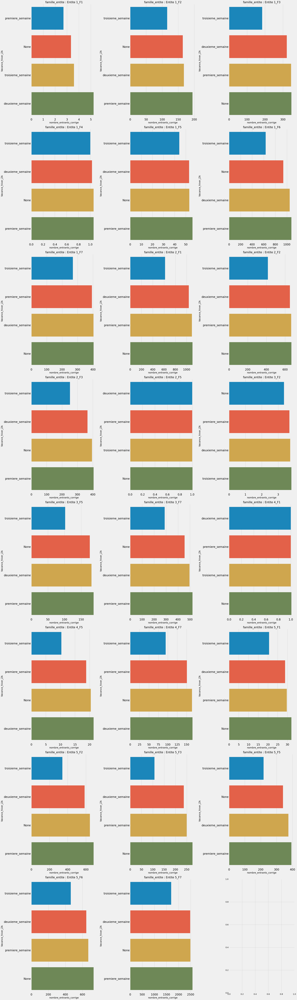

In [ ]:
import holidays
import matplotlib.pyplot as plt 
import seaborn as sns 

# Définir la plage de dates
start_date = '2019-01-02'
end_date = '2019-02-15'

# Obtenir les jours fériés pour la France
fr_holidays = holidays.France()

# Liste des jours fériés entre les dates spécifiées
jours_feries = [pd.to_datetime(date.strftime('%Y-%m-%d')) for date in fr_holidays[start_date:end_date]]

df_phone_entite_instance=df_all_data.groupby('famille_entite')
import locale

# Définir la locale en français
locale.setlocale(locale.LC_TIME, 'fr_FR')

# Créer la grille de sous-tracés avec une taille de 3x3
fig, axes = plt.subplots(8, 3, figsize=(30, 100), sharex=False, sharey=False)

# Parcourir chaque entité et instance
for i, (famille_entite , group_df) in enumerate(df_phone_entite_instance):
    # Déterminer les indices de sous-tracé
    row = i // 3
    col = i % 3

    # Compter le nombre d'appels par jour et par type (jour ou jour férié)
    group_df = group_df[['Vacance_hiver_ZA','nombre_entrants_corrige']].groupby('Vacance_hiver_ZA').mean().reset_index()
    
    # Trier les données par le nombre d'appels
    group_df = group_df.sort_values(by='nombre_entrants_corrige', ascending=True)
    # print(group_df)
    # Tracer le graphique en barres empilées
    sns.barplot(data=group_df, x='nombre_entrants_corrige', y='Vacance_hiver_ZA', ax=axes[row, col])

    axes[row, col].tick_params(axis='x',labelsize=20)
    axes[row,col].tick_params(axis='y', labelsize=20)

    # Ajouter un titre pour chaque sous-tracé
    axes[row, col].set_title(f"famille_entite : {famille_entite}")

# Ajuster les espacements entre les sous-tracés
plt.tight_layout()

# Afficher le graphe
plt.show()


## Zone B 

In [ ]:
import pandas as pd
import datetime


# Définir les dates de début et de fin des soldes d'été pour chaque année
Vacance_Hiver_dates_ZB = {
    2019: (datetime.date(2019, 2, 9), datetime.date(2019, 2, 25)),
    2020: (datetime.date(2020, 2, 15), datetime.date(2020, 3, 2)),
    2021: (datetime.date(2021, 2, 20), datetime.date(2021, 3, 8)),
    2022: (datetime.date(2022, 2, 5), datetime.date(2022, 2, 21)),
    2023: (datetime.date(2023, 2, 11), datetime.date(2023, 2, 27))
}

# Définir les labels pour les semaines de soldes
labels = ['premiere_semaine', 'deuxieme_semaine', 'troisieme_semaine', ]
        #   'quatrieme_semaine','ciquieme_semaine', 'sixieme_semaine', 'setieme_semaine','huite_semaine']

# Fonction pour attribuer le label de la semaine de solde
def label_solde(row):
    date = row['date']
    year = date.year
    debut_hiver_ZB, fin_hiver_ZB = Vacance_Hiver_dates_ZB.get(year, (None, None))
 
        
    if debut_hiver_ZB and fin_hiver_ZB and debut_hiver_ZB <= date <= fin_hiver_ZB:
        delta = (date - pd.Timestamp(debut_hiver_ZB)).days
        semaine_hiver_ZB = delta // 7  # Diviser le nombre de jours par 7 pour obtenir le numéro de la semaine
        row['Vacance_hiver_ZB'] = f"{labels[semaine_hiver_ZB]}"
    else:
        row['Vacance_hiver_ZB']='None'
    return row

# Appliquer la fonction à chaque ligne du dataframe
df_all_data['Vacance_hiver_ZB']= 'None'
df_all_data = df_all_data.apply(label_solde, axis=1)


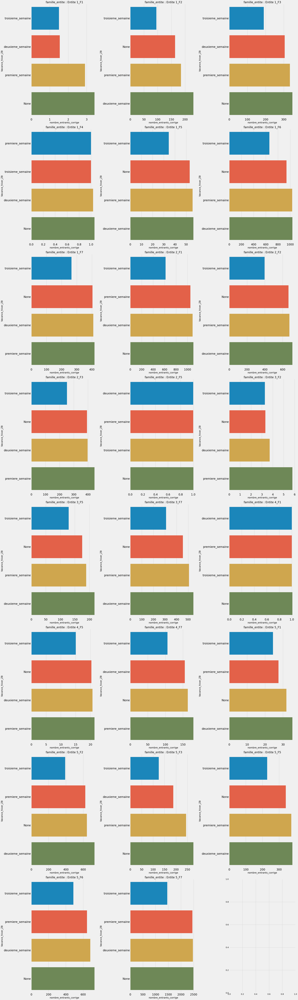

In [ ]:
import holidays
import matplotlib.pyplot as plt 
import seaborn as sns 

# Définir la plage de dates
start_date = '2019-01-02'
end_date = '2019-02-15'

# Obtenir les jours fériés pour la France
fr_holidays = holidays.France()

# Liste des jours fériés entre les dates spécifiées
jours_feries = [pd.to_datetime(date.strftime('%Y-%m-%d')) for date in fr_holidays[start_date:end_date]]

df_phone_entite_instance=df_all_data.groupby('famille_entite')
import locale

# Définir la locale en français
locale.setlocale(locale.LC_TIME, 'fr_FR')

# Créer la grille de sous-tracés avec une taille de 3x3
fig, axes = plt.subplots(8, 3, figsize=(30, 100), sharex=False, sharey=False)

# Parcourir chaque entité et instance
for i, (famille_entite , group_df) in enumerate(df_phone_entite_instance):
    # Déterminer les indices de sous-tracé
    row = i // 3
    col = i % 3

    # Compter le nombre d'appels par jour et par type (jour ou jour férié)
    group_df = group_df[['Vacance_hiver_ZB','nombre_entrants_corrige']].groupby('Vacance_hiver_ZB').mean().reset_index()
    
    # Trier les données par le nombre d'appels
    group_df = group_df.sort_values(by='nombre_entrants_corrige', ascending=True)
    # print(group_df)
    # Tracer le graphique en barres empilées
    sns.barplot(data=group_df, x='nombre_entrants_corrige', y='Vacance_hiver_ZB', ax=axes[row, col])

    axes[row, col].tick_params(axis='x',labelsize=20)
    axes[row,col].tick_params(axis='y', labelsize=20)

    # Ajouter un titre pour chaque sous-tracé
    axes[row, col].set_title(f"famille_entite : {famille_entite}")

# Ajuster les espacements entre les sous-tracés
plt.tight_layout()

# Afficher le graphe
plt.show()

## Zone C 

In [ ]:
import pandas as pd
import datetime


# Définir les dates de début et de fin des soldes d'été pour chaque année
Vacance_Hiver_dates_ZC = {
    2019: (datetime.date(2019, 2, 23), datetime.date(2019, 3, 11)),
    2020: (datetime.date(2020, 2, 8), datetime.date(2020, 2, 24)),
    2021: (datetime.date(2021, 2, 13), datetime.date(2021, 3, 1)),
    2022: (datetime.date(2022, 2, 19), datetime.date(2022, 3, 7)),
    2023: (datetime.date(2023, 2, 18), datetime.date(2023, 3, 6))
}

# Définir les labels pour les semaines de soldes
labels = ['premiere_semaine', 'deuxieme_semaine', 'troisieme_semaine', ]
        #   'quatrieme_semaine','ciquieme_semaine', 'sixieme_semaine', 'setieme_semaine','huite_semaine']

# Fonction pour attribuer le label de la semaine de solde
def label_solde(row):
    date = row['date']
    year = date.year
    debut_hiver_ZC, fin_hiver_ZC = Vacance_Hiver_dates_ZC.get(year, (None, None))
 
        
    if debut_hiver_ZC and fin_hiver_ZC and debut_hiver_ZC <= date <= fin_hiver_ZC:
        delta = (date - pd.Timestamp(debut_hiver_ZC)).days
        semaine_hiver_ZC = delta // 7  # Diviser le nombre de jours par 7 pour obtenir le numéro de la semaine
        row['Vacance_hiver_ZC'] = f"{labels[semaine_hiver_ZC]}"
    else:
        row['Vacance_hiver_ZC']='None'
    return row

# Appliquer la fonction à chaque ligne du dataframe
df_all_data['Vacance_hiver_ZC']= 'None'
df_all_data = df_all_data.apply(label_solde, axis=1)

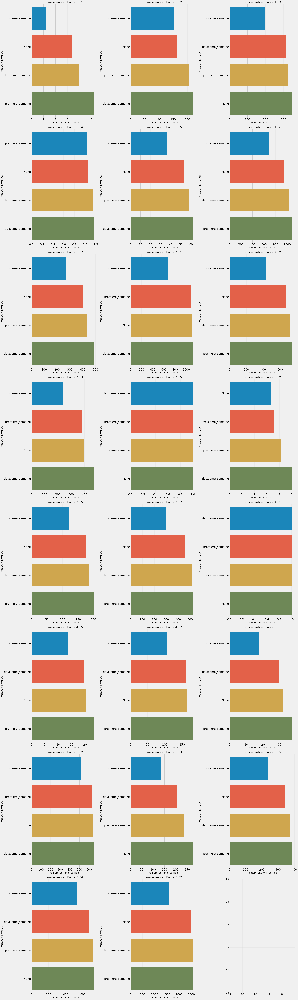

In [ ]:
import holidays
import matplotlib.pyplot as plt 
import seaborn as sns 

# Définir la plage de dates
start_date = '2019-01-02'
end_date = '2019-02-15'

# Obtenir les jours fériés pour la France
fr_holidays = holidays.France()

# Liste des jours fériés entre les dates spécifiées
jours_feries = [pd.to_datetime(date.strftime('%Y-%m-%d')) for date in fr_holidays[start_date:end_date]]

df_phone_entite_instance=df_all_data.groupby('famille_entite')
import locale

# Définir la locale en français
locale.setlocale(locale.LC_TIME, 'fr_FR')

# Créer la grille de sous-tracés avec une taille de 3x3
fig, axes = plt.subplots(8, 3, figsize=(30, 100), sharex=False, sharey=False)

# Parcourir chaque entité et instance
for i, (famille_entite , group_df) in enumerate(df_phone_entite_instance):
    # Déterminer les indices de sous-tracé
    row = i // 3
    col = i % 3

    # Compter le nombre d'appels par jour et par type (jour ou jour férié)
    group_df = group_df[['Vacance_hiver_ZC','nombre_entrants_corrige']].groupby('Vacance_hiver_ZC').mean().reset_index()
    
    # Trier les données par le nombre d'appels
    group_df = group_df.sort_values(by='nombre_entrants_corrige', ascending=True)
    # print(group_df)
    # Tracer le graphique en barres empilées
    sns.barplot(data=group_df, x='nombre_entrants_corrige', y='Vacance_hiver_ZC', ax=axes[row, col])

    axes[row, col].tick_params(axis='x',labelsize=20)
    axes[row,col].tick_params(axis='y', labelsize=20)

    # Ajouter un titre pour chaque sous-tracé
    axes[row, col].set_title(f"famille_entite : {famille_entite}")

# Ajuster les espacements entre les sous-tracés
plt.tight_layout()

# Afficher le graphe
plt.show()

In [ ]:
import datetime
import pandas as pd
import xgboost as xgb
import matplotlib.pyplot as plt
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import OneHotEncoder, OrdinalEncoder, StandardScaler
from sklearn.metrics import r2_score, mean_absolute_error, mean_absolute_percentage_error, mean_squared_error
import mlflow
import mlflow.sklearn
import os 
# Convertir la colonne "date" en objets datetime
df_all_data['date'] = pd.to_datetime(df_all_data['date'])
# df_all_data[df_all_data['']]
# Définir la date initiale
date_initiale = datetime.datetime(2022, 10, 15)
# Parcourir chaque groupe de famille_entite
for famille_entite, group_df in df_all_data.groupby('famille_entite'):
    mlflow.set_experiment(f"{famille_entite}")
    with mlflow.start_run(run_name='run_vacance_hiver',nested=True):

        # Séparer les données en ensemble d'entraînement et ensemble de test
        train_df = group_df.loc[group_df['date'] <= date_initiale]
        test_df = group_df.loc[group_df['date'] > date_initiale]

        # Séparer les caractéristiques et la variable cible
        X_train = train_df.drop(['date', 'nombre_entrants_corrige'], axis=1)
        X_test = test_df.drop(['date', 'nombre_entrants_corrige'], axis=1)
        y_train = train_df['nombre_entrants_corrige']
        y_test = test_df['nombre_entrants_corrige']

        cols_cat = X_train.select_dtypes('object').columns  # Ajoutez d'autres colonnes catégorielles si nécessaire
        cols_num = X_train.select_dtypes(exclude='object').columns

        # Créer un pipeline pour l'encodage des colonnes catégorielles et l'entraînement du modèle
        pipeline = Pipeline([
            ('encoding', ColumnTransformer([
                ('onehot', OneHotEncoder(), cols_cat),
                ('scaler', StandardScaler(with_mean=False), cols_num)
            ])),
            ('regressor', xgb.XGBRegressor())
        ])

        # Entraîner le modèle
        pipeline.fit(X_train, y_train)

        # Obtenir les noms des features après l'encodage
        encoded_feature_names = []
        encoded_feature_names += list(pipeline.named_steps['encoding'].transformers_[0][1].get_feature_names_out(cols_cat))
        encoded_feature_names += list(cols_num)

        # Obtenir l'importance des caractéristiques
        importance = pipeline.named_steps['regressor'].feature_importances_

        # Créer un DataFrame avec les noms des features et leur importance
        feature_importance_df = pd.DataFrame({'Feature': encoded_feature_names, 'Importance': importance})

        # Trier les features par importance décroissante
        feature_importance_df = feature_importance_df.sort_values('Importance', ascending=True).reset_index(drop=True)

        # Prédire les valeurs pour l'ensemble de test
        y_pred = pipeline.predict(X_test)

        # Afficher les noms des features les plus importants
        print(f"Les noms des features les plus importants pour la famille_entite '{famille_entite}':")

        # Afficher le meilleur score
        print('R2:', r2_score(y_pred=y_pred, y_true=y_test))
        print('MAE:', mean_absolute_error(y_pred=y_pred, y_true=y_test))
        print('MAPE:', mean_absolute_percentage_error(y_pred=y_pred, y_true=y_test))
        print('MSE:', mean_squared_error(y_pred=y_pred, y_true=y_test))

        # Tracer le barplot des features les plus importants
        plt.figure(figsize=(14, 16))
        plt.barh(feature_importance_df['Feature'][:20], feature_importance_df['Importance'][:20])
        plt.xlabel('Importance')
        plt.ylabel('Feature')
        plt.title(f"Importance des variables pour la famille_entite '{famille_entite}'")
        # Ajouter une distance marginale de 0.2 du côté de l'axe X
        plt.subplots_adjust(left=0.2)
        plt.savefig("barplot.png")
        plt.close()

        # Enregistrer le barplot sur MLflow
        mlflow.log_artifact("barplot.png")

        df_test.plot(figsize=(15, 15))
        plt.xlabel('Date')
        plt.ylabel('Valeurs')
        plt.title('Comparaison entre nombre_entrants_corrige et Prediction')
        plt.savefig("comparaison.png")
        plt.close()

        # Enregistrer la comparaison sur MLflow
        mlflow.log_artifact("comparaison.png")

        # Supprimer les fichiers locaux après les avoir enregistrés sur MLflow
        os.remove("barplot.png")
        os.remove("comparaison.png")

        # Enregistrer les métriques et les paramètres dans MLflow
        mlflow.log_metric('R2', r2_score(y_pred=y_pred, y_true=y_test))
        mlflow.log_metric('MAE', mean_absolute_error(y_pred=y_pred, y_true=y_test))
        mlflow.log_metric('MAPE', mean_absolute_percentage_error(y_pred=y_pred, y_true=y_test))
        mlflow.log_metric('MSE', mean_squared_error(y_pred=y_pred, y_true=y_test))
        mlflow.log_params({
            'famille_entite': famille_entite,
            'encoding_cols_cat': list(cols_cat),
            'encoding_cols_num': list(cols_num)
        })

        # Terminer l'enregistrement MLflow
        mlflow.end_run()


Les noms des features les plus importants pour la famille_entite 'Entite 1_F1':
R2: -0.026891072072397826
MAE: 4.37288053138657
MAPE: 0.8314176717546213
MSE: 37.68809508995168
Les noms des features les plus importants pour la famille_entite 'Entite 1_F2':
R2: -5.43518303879171
MAE: 70.14970268954532
MAPE: 5.2677837180049
MSE: 7662.320068447219
Les noms des features les plus importants pour la famille_entite 'Entite 1_F3':
R2: 0.7869756391565224
MAE: 68.93707929464068
MAPE: 9.875224709201387
MSE: 13256.170684910985
Les noms des features les plus importants pour la famille_entite 'Entite 1_F4':
R2: -0.45908751989260854
MAE: 0.030223041530547102
MAPE: 0.02206891872049347
MSE: 0.023339227960474013
Les noms des features les plus importants pour la famille_entite 'Entite 1_F5':
R2: 0.47983166953540957
MAE: 10.847533838010389
MAPE: 1.5528467959513668
MSE: 256.1122464716654
Les noms des features les plus importants pour la famille_entite 'Entite 1_F6':
R2: 0.7847018317312797
MAE: 151.581682419

## Vacance Printemps 

## zone A

In [ ]:
import pandas as pd
import datetime


# Définir les dates de début et de fin des soldes d'été pour chaque année
Vacance_printemp_dates_ZA = {
    2019: (datetime.date(2019, 4, 13), datetime.date(2019, 4, 29)),
    2020: (datetime.date(2020, 4, 18), datetime.date(2020, 5, 4)),
    2021: (datetime.date(2021, 4, 10), datetime.date(2021, 4, 26)),
    2022: (datetime.date(2022, 4, 16), datetime.date(2022, 5, 2)),
    2023: (datetime.date(2023, 4, 8), datetime.date(2023, 4, 24))
}

# Définir les labels pour les semaines de soldes
labels = ['premiere_semaine', 'deuxieme_semaine', 'troisieme_semaine', ]
        #   'quatrieme_semaine','ciquieme_semaine', 'sixieme_semaine', 'setieme_semaine','huite_semaine']

# Fonction pour attribuer le label de la semaine de solde
def label_solde(row):
    date = row['date']
    year = date.year
    debut_printemp_ZA, fin_printemp_ZA = Vacance_printemp_dates_ZA.get(year, (None, None))
 
        
    if debut_printemp_ZA and fin_printemp_ZA and debut_printemp_ZA <= date <= fin_printemp_ZA:
        delta = (date - pd.Timestamp(debut_printemp_ZA)).days
        semaine_printemp_ZA = delta // 7  # Diviser le nombre de jours par 7 pour obtenir le numéro de la semaine
        row['Vacance_printemp_ZA'] = f"{labels[semaine_printemp_ZA]}"
    else:
        row['Vacance_printemp_ZA']='None'
    return row

# Appliquer la fonction à chaque ligne du dataframe
df_all_data['Vacance_printemp_ZA']= 'None'
df_all_data = df_all_data.apply(label_solde, axis=1)


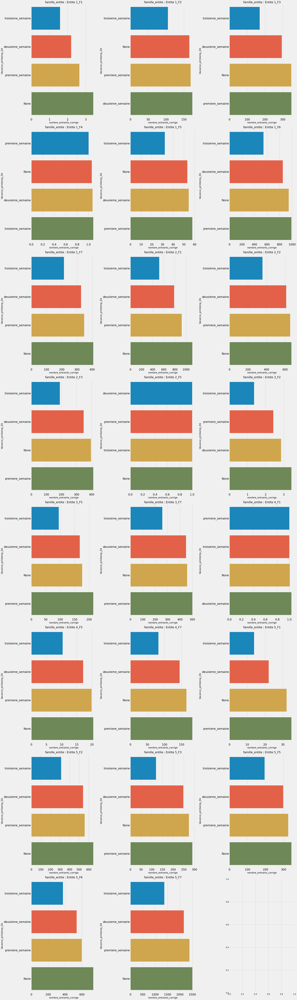

In [ ]:
import holidays
import matplotlib.pyplot as plt 
import seaborn as sns 

# Définir la plage de dates
start_date = '2019-01-02'
end_date = '2019-02-15'

# Obtenir les jours fériés pour la France
fr_holidays = holidays.France()

# Liste des jours fériés entre les dates spécifiées
jours_feries = [pd.to_datetime(date.strftime('%Y-%m-%d')) for date in fr_holidays[start_date:end_date]]

df_phone_entite_instance=df_all_data.groupby('famille_entite')
import locale

# Définir la locale en français
locale.setlocale(locale.LC_TIME, 'fr_FR')

# Créer la grille de sous-tracés avec une taille de 3x3
fig, axes = plt.subplots(8, 3, figsize=(30, 100), sharex=False, sharey=False)

# Parcourir chaque entité et instance
for i, (famille_entite , group_df) in enumerate(df_phone_entite_instance):
    # Déterminer les indices de sous-tracé
    row = i // 3
    col = i % 3

    # Compter le nombre d'appels par jour et par type (jour ou jour férié)
    group_df = group_df[['Vacance_printemp_ZA','nombre_entrants_corrige']].groupby('Vacance_printemp_ZA').mean().reset_index()
    
    # Trier les données par le nombre d'appels
    group_df = group_df.sort_values(by='nombre_entrants_corrige', ascending=True)
    # print(group_df)
    # Tracer le graphique en barres empilées
    sns.barplot(data=group_df, x='nombre_entrants_corrige', y='Vacance_printemp_ZA', ax=axes[row, col])

    axes[row, col].tick_params(axis='x',labelsize=20)
    axes[row,col].tick_params(axis='y', labelsize=20)

    # Ajouter un titre pour chaque sous-tracé
    axes[row, col].set_title(f"famille_entite : {famille_entite}")

# Ajuster les espacements entre les sous-tracés
plt.tight_layout()

# Afficher le graphe
plt.show()


## Zone B 

In [ ]:
import pandas as pd
import datetime


# Définir les dates de début et de fin des soldes d'été pour chaque année
Vacance_printemp_dates_ZB = {
    2019: (datetime.date(2019, 4, 6), datetime.date(2019, 4, 23)),
    2020: (datetime.date(2020, 4, 11), datetime.date(2020, 4, 27)),
    2021: (datetime.date(2021, 4, 24), datetime.date(2021, 5, 10)),
    2022: (datetime.date(2022, 4, 9), datetime.date(2022, 4, 25)),
    2023: (datetime.date(2023, 4, 15), datetime.date(2023, 5, 2))
}

# Définir les labels pour les semaines de soldes
labels = ['premiere_semaine', 'deuxieme_semaine', 'troisieme_semaine', ]
        #   'quatrieme_semaine','ciquieme_semaine', 'sixieme_semaine', 'setieme_semaine','huite_semaine']

# Fonction pour attribuer le label de la semaine de solde
def label_solde(row):
    date = row['date']
    year = date.year
    debut_printemp_ZB, fin_printemp_ZB = Vacance_printemp_dates_ZB.get(year, (None, None))
 
        
    if debut_printemp_ZB and fin_printemp_ZB and debut_printemp_ZB <= date <= fin_printemp_ZB:
        delta = (date - pd.Timestamp(debut_printemp_ZB)).days
        semaine_printemp_ZB = delta // 7  # Diviser le nombre de jours par 7 pour obtenir le numéro de la semaine
        row['Vacance_printemp_ZB'] = f"{labels[semaine_printemp_ZB]}"
    else:
        row['Vacance_printemp_ZB']='None'
    return row

# Appliquer la fonction à chaque ligne du dataframe
df_all_data['Vacance_printemp_ZB']= 'None'
df_all_data = df_all_data.apply(label_solde, axis=1)


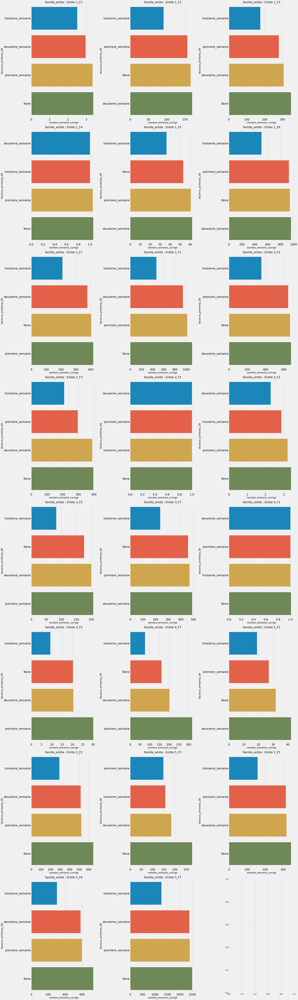

In [ ]:
import holidays
import matplotlib.pyplot as plt 
import seaborn as sns 

# Définir la plage de dates
start_date = '2019-01-02'
end_date = '2019-02-15'

# Obtenir les jours fériés pour la France
fr_holidays = holidays.France()

# Liste des jours fériés entre les dates spécifiées
jours_feries = [pd.to_datetime(date.strftime('%Y-%m-%d')) for date in fr_holidays[start_date:end_date]]

df_phone_entite_instance=df_all_data.groupby('famille_entite')
import locale

# Définir la locale en français
locale.setlocale(locale.LC_TIME, 'fr_FR')

# Créer la grille de sous-tracés avec une taille de 3x3
fig, axes = plt.subplots(8, 3, figsize=(30, 100), sharex=False, sharey=False)

# Parcourir chaque entité et instance
for i, (famille_entite , group_df) in enumerate(df_phone_entite_instance):
    # Déterminer les indices de sous-tracé
    row = i // 3
    col = i % 3

    # Compter le nombre d'appels par jour et par type (jour ou jour férié)
    group_df = group_df[['Vacance_printemp_ZB','nombre_entrants_corrige']].groupby('Vacance_printemp_ZB').mean().reset_index()
    
    # Trier les données par le nombre d'appels
    group_df = group_df.sort_values(by='nombre_entrants_corrige', ascending=True)
    # print(group_df)
    # Tracer le graphique en barres empilées
    sns.barplot(data=group_df, x='nombre_entrants_corrige', y='Vacance_printemp_ZB', ax=axes[row, col])

    axes[row, col].tick_params(axis='x',labelsize=20)
    axes[row,col].tick_params(axis='y', labelsize=20)

    # Ajouter un titre pour chaque sous-tracé
    axes[row, col].set_title(f"famille_entite : {famille_entite}")

# Ajuster les espacements entre les sous-tracés
plt.tight_layout()

# Afficher le graphe
plt.show()

## Zone C 

In [ ]:
import pandas as pd
import datetime


# Définir les dates de début et de fin des soldes d'été pour chaque année
Vacance_printemp_dates_ZC = {
    2019: (datetime.date(2019, 4, 20), datetime.date(2019, 5, 6)),
    2020: (datetime.date(2020, 4, 4), datetime.date(2020, 4, 20)),
    2021: (datetime.date(2021, 4, 17), datetime.date(2021, 5, 3)),
    2022: (datetime.date(2022, 4, 23), datetime.date(2022, 5, 9)),
    2023: (datetime.date(2023, 4, 15), datetime.date(2023, 5, 2))
}

# Définir les labels pour les semaines de soldes
labels = ['premiere_semaine', 'deuxieme_semaine', 'troisieme_semaine', ]
        #   'quatrieme_semaine','ciquieme_semaine', 'sixieme_semaine', 'setieme_semaine','huite_semaine']

# Fonction pour attribuer le label de la semaine de solde
def label_solde(row):
    date = row['date']
    year = date.year
    debut_printemp_ZC, fin_printemp_ZC = Vacance_printemp_dates_ZC.get(year, (None, None))
 
        
    if debut_printemp_ZC and fin_printemp_ZC and debut_printemp_ZC <= date <= fin_printemp_ZC:
        delta = (date - pd.Timestamp(debut_printemp_ZC)).days
        semaine_printemp_ZC = delta // 7  # Diviser le nombre de jours par 7 pour obtenir le numéro de la semaine
        row['Vacance_printemp_ZC'] = f"{labels[semaine_printemp_ZC]}"
    else:
        row['Vacance_printemp_ZC']='None'
    return row

# Appliquer la fonction à chaque ligne du dataframe
df_all_data['Vacance_printemp_ZC']= 'None'
df_all_data = df_all_data.apply(label_solde, axis=1)

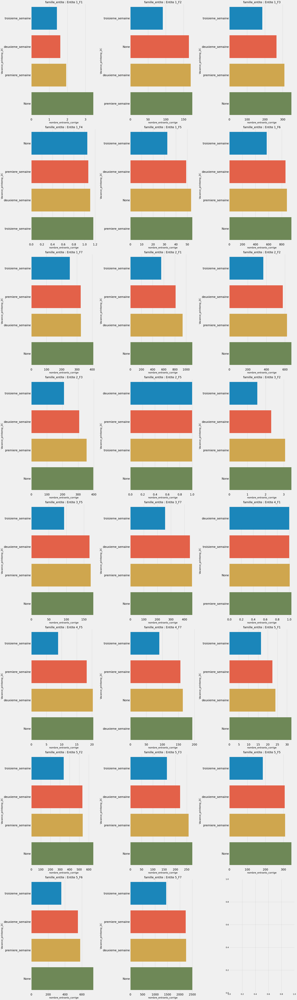

In [ ]:
import holidays
import matplotlib.pyplot as plt 
import seaborn as sns 

# Définir la plage de dates
start_date = '2019-01-02'
end_date = '2019-02-15'

# Obtenir les jours fériés pour la France
fr_holidays = holidays.France()

# Liste des jours fériés entre les dates spécifiées
jours_feries = [pd.to_datetime(date.strftime('%Y-%m-%d')) for date in fr_holidays[start_date:end_date]]

df_phone_entite_instance=df_all_data.groupby('famille_entite')
import locale

# Définir la locale en français
locale.setlocale(locale.LC_TIME, 'fr_FR')

# Créer la grille de sous-tracés avec une taille de 3x3
fig, axes = plt.subplots(8, 3, figsize=(30, 100), sharex=False, sharey=False)

# Parcourir chaque entité et instance
for i, (famille_entite , group_df) in enumerate(df_phone_entite_instance):
    # Déterminer les indices de sous-tracé
    row = i // 3
    col = i % 3

    # Compter le nombre d'appels par jour et par type (jour ou jour férié)
    group_df = group_df[['Vacance_printemp_ZC','nombre_entrants_corrige']].groupby('Vacance_printemp_ZC').mean().reset_index()
    
    # Trier les données par le nombre d'appels
    group_df = group_df.sort_values(by='nombre_entrants_corrige', ascending=True)
    # print(group_df)
    # Tracer le graphique en barres empilées
    sns.barplot(data=group_df, x='nombre_entrants_corrige', y='Vacance_printemp_ZC', ax=axes[row, col])

    axes[row, col].tick_params(axis='x',labelsize=20)
    axes[row,col].tick_params(axis='y', labelsize=20)

    # Ajouter un titre pour chaque sous-tracé
    axes[row, col].set_title(f"famille_entite : {famille_entite}")

# Ajuster les espacements entre les sous-tracés
plt.tight_layout()

# Afficher le graphe
plt.show()

In [ ]:
import datetime
import pandas as pd
import xgboost as xgb
import matplotlib.pyplot as plt
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import OneHotEncoder, OrdinalEncoder, StandardScaler
from sklearn.metrics import r2_score, mean_absolute_error, mean_absolute_percentage_error, mean_squared_error
import mlflow
import mlflow.sklearn
import os 
# Convertir la colonne "date" en objets datetime
df_all_data['date'] = pd.to_datetime(df_all_data['date'])
# df_all_data[df_all_data['']]
# Définir la date initiale
date_initiale = datetime.datetime(2022, 10, 15)
# Parcourir chaque groupe de famille_entite
for famille_entite, group_df in df_all_data.groupby('famille_entite'):
    mlflow.set_experiment(f"{famille_entite}")
    with mlflow.start_run(run_name='run_vacance_printemp',nested=True):

        # Séparer les données en ensemble d'entraînement et ensemble de test
        train_df = group_df.loc[group_df['date'] <= date_initiale]
        test_df = group_df.loc[group_df['date'] > date_initiale]

        # Séparer les caractéristiques et la variable cible
        X_train = train_df.drop(['date', 'nombre_entrants_corrige'], axis=1)
        X_test = test_df.drop(['date', 'nombre_entrants_corrige'], axis=1)
        y_train = train_df['nombre_entrants_corrige']
        y_test = test_df['nombre_entrants_corrige']

        cols_cat = X_train.select_dtypes('object').columns  # Ajoutez d'autres colonnes catégorielles si nécessaire
        cols_num = X_train.select_dtypes(exclude='object').columns

        # Créer un pipeline pour l'encodage des colonnes catégorielles et l'entraînement du modèle
        pipeline = Pipeline([
            ('encoding', ColumnTransformer([
                ('onehot', OneHotEncoder(), cols_cat),
                ('scaler', StandardScaler(with_mean=False), cols_num)
            ])),
            ('regressor', xgb.XGBRegressor())
        ])

        # Entraîner le modèle
        pipeline.fit(X_train, y_train)

        # Obtenir les noms des features après l'encodage
        encoded_feature_names = []
        encoded_feature_names += list(pipeline.named_steps['encoding'].transformers_[0][1].get_feature_names_out(cols_cat))
        encoded_feature_names += list(cols_num)

        # Obtenir l'importance des caractéristiques
        importance = pipeline.named_steps['regressor'].feature_importances_

        # Créer un DataFrame avec les noms des features et leur importance
        feature_importance_df = pd.DataFrame({'Feature': encoded_feature_names, 'Importance': importance})

        # Trier les features par importance décroissante
        feature_importance_df = feature_importance_df.sort_values('Importance', ascending=True).reset_index(drop=True)

        # Prédire les valeurs pour l'ensemble de test
        y_pred = pipeline.predict(X_test)

        # Afficher les noms des features les plus importants
        print(f"Les noms des features les plus importants pour la famille_entite '{famille_entite}':")

        # Afficher le meilleur score
        print('R2:', r2_score(y_pred=y_pred, y_true=y_test))
        print('MAE:', mean_absolute_error(y_pred=y_pred, y_true=y_test))
        print('MAPE:', mean_absolute_percentage_error(y_pred=y_pred, y_true=y_test))
        print('MSE:', mean_squared_error(y_pred=y_pred, y_true=y_test))

        # Tracer le barplot des features les plus importants
        plt.figure(figsize=(10, 6))
        plt.barh(feature_importance_df['Feature'][:20], feature_importance_df['Importance'][:20])
        plt.xlabel('Importance')
        plt.ylabel('Feature')
        plt.title(f"Importance des variables pour la famille_entite '{famille_entite}'")
                # Ajouter une distance marginale de 0.2 du côté de l'axe X
        plt.subplots_adjust(left=0.3)
        plt.savefig("barplot.png")
        plt.close()

        # Enregistrer le barplot sur MLflow
        mlflow.log_artifact("barplot.png")

        df_test.plot(figsize=(15, 15))
        plt.xlabel('Date')
        plt.ylabel('Valeurs')
        plt.title('Comparaison entre nombre_entrants_corrige et Prediction')
        plt.savefig("comparaison.png")
        plt.close()

        # Enregistrer la comparaison sur MLflow
        mlflow.log_artifact("comparaison.png")

        # Supprimer les fichiers locaux après les avoir enregistrés sur MLflow
        os.remove("barplot.png")
        os.remove("comparaison.png")

        # Enregistrer les métriques et les paramètres dans MLflow
        mlflow.log_metric('R2', r2_score(y_pred=y_pred, y_true=y_test))
        mlflow.log_metric('MAE', mean_absolute_error(y_pred=y_pred, y_true=y_test))
        mlflow.log_metric('MAPE', mean_absolute_percentage_error(y_pred=y_pred, y_true=y_test))
        mlflow.log_metric('MSE', mean_squared_error(y_pred=y_pred, y_true=y_test))
        mlflow.log_params({
            'famille_entite': famille_entite,
            'encoding_cols_cat': list(cols_cat),
            'encoding_cols_num': list(cols_num)
        })

        # Terminer l'enregistrement MLflow
        mlflow.end_run()


Les noms des features les plus importants pour la famille_entite 'Entite 1_F1':
R2: 0.013830906689748845
MAE: 4.145166137220353
MAPE: 0.6608180020955401
MSE: 36.193551170369744
Les noms des features les plus importants pour la famille_entite 'Entite 1_F2':
R2: -5.24269680707263
MAE: 68.81293547140704
MAPE: 5.668050648309085
MSE: 7433.1282789813795
Les noms des features les plus importants pour la famille_entite 'Entite 1_F3':
R2: 0.7833658562176439
MAE: 66.91281182595272
MAPE: 10.037826039609971
MSE: 13480.801795567913
Les noms des features les plus importants pour la famille_entite 'Entite 1_F4':
R2: -0.45637636516777214
MAE: 0.031607592978128575
MAPE: 0.02346976210431355
MSE: 0.023295860953837063
Les noms des features les plus importants pour la famille_entite 'Entite 1_F5':
R2: 0.46208095858496057
MAE: 10.785590460304018
MAPE: 1.5438886535617617
MSE: 264.8520604736602
Les noms des features les plus importants pour la famille_entite 'Entite 1_F6':
R2: 0.760286896269597
MAE: 148.28963

## Vacance blackfriday 

In [ ]:
import pandas as pd
import datetime


# Définir les dates de début et de fin des soldes d'été pour chaque année
Vacance_blackfriday_dates = {
    2019: (datetime.date(2019, 11, 29), datetime.date(2019, 11, 29)),
    2020: (datetime.date(2020, 12, 4), datetime.date(2020, 12, 4)),
    2021: (datetime.date(2021, 11, 26), datetime.date(2021, 11, 26)),
    2022: (datetime.date(2022, 11, 25), datetime.date(2022, 11, 25)),
    2023: (datetime.date(2023, 11, 24), datetime.date(2023, 11, 24))
}

# Définir les labels pour les semaines de soldes
labels = ['True' ]
        #   'quatrieme_semaine','ciquieme_semaine', 'sixieme_semaine', 'setieme_semaine','huite_semaine']

# Fonction pour attribuer le label de la semaine de solde
def label_solde(row):
    date = row['date']
    year = date.year
    debut_blackfriday, fin_blackfriday = Vacance_blackfriday_dates.get(year, (None, None))
 
        
    if debut_blackfriday and fin_blackfriday and debut_blackfriday <= date <= fin_blackfriday:
        delta = (date - pd.Timestamp(debut_blackfriday)).days
        semaine_blackfriday = delta // 7  # Diviser le nombre de jours par 7 pour obtenir le numéro de la semaine
        row['blackfriday'] = f"{labels[semaine_blackfriday]}"
    else:
        row['blackfriday']='None'
    return row

# Appliquer la fonction à chaque ligne du dataframe
df_all_data['blackfriday']= 'None'
df_all_data = df_all_data.apply(label_solde, axis=1)

In [ ]:
import datetime
import pandas as pd
import xgboost as xgb
import matplotlib.pyplot as plt
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import OneHotEncoder, OrdinalEncoder, StandardScaler
from sklearn.metrics import r2_score, mean_absolute_error, mean_absolute_percentage_error, mean_squared_error
import mlflow
import mlflow.sklearn
import os 
# Convertir la colonne "date" en objets datetime
df_all_data['date'] = pd.to_datetime(df_all_data['date'])
# df_all_data[df_all_data['']]
# Définir la date initiale
date_initiale = datetime.datetime(2022, 10, 15)
# Parcourir chaque groupe de famille_entite
for famille_entite, group_df in df_all_data.groupby('famille_entite'):
    mlflow.set_experiment(f"{famille_entite}")
    with mlflow.start_run(run_name='run_vacance_black',nested=True):

        # Séparer les données en ensemble d'entraînement et ensemble de test
        train_df = group_df.loc[group_df['date'] <= date_initiale]
        test_df = group_df.loc[group_df['date'] > date_initiale]

        # Séparer les caractéristiques et la variable cible
        X_train = train_df.drop(['date', 'nombre_entrants_corrige'], axis=1)
        X_test = test_df.drop(['date', 'nombre_entrants_corrige'], axis=1)
        y_train = train_df['nombre_entrants_corrige']
        y_test = test_df['nombre_entrants_corrige']

        cols_cat = X_train.select_dtypes('object').columns  # Ajoutez d'autres colonnes catégorielles si nécessaire
        cols_num = X_train.select_dtypes(exclude='object').columns

        # Créer un pipeline pour l'encodage des colonnes catégorielles et l'entraînement du modèle
        pipeline = Pipeline([
            ('encoding', ColumnTransformer([
                ('onehot', OneHotEncoder(), cols_cat),
                ('scaler', StandardScaler(with_mean=False), cols_num)
            ])),
            ('regressor', xgb.XGBRegressor())
        ])

        # Entraîner le modèle
        pipeline.fit(X_train, y_train)

        # Obtenir les noms des features après l'encodage
        encoded_feature_names = []
        encoded_feature_names += list(pipeline.named_steps['encoding'].transformers_[0][1].get_feature_names_out(cols_cat))
        encoded_feature_names += list(cols_num)

        # Obtenir l'importance des caractéristiques
        importance = pipeline.named_steps['regressor'].feature_importances_

        # Créer un DataFrame avec les noms des features et leur importance
        feature_importance_df = pd.DataFrame({'Feature': encoded_feature_names, 'Importance': importance})

        # Trier les features par importance décroissante
        feature_importance_df = feature_importance_df.sort_values('Importance', ascending=True).reset_index(drop=True)

        # Prédire les valeurs pour l'ensemble de test
        y_pred = pipeline.predict(X_test)

        # Afficher les noms des features les plus importants
        print(f"Les noms des features les plus importants pour la famille_entite '{famille_entite}':")

        # Afficher le meilleur score
        print('R2:', r2_score(y_pred=y_pred, y_true=y_test))
        print('MAE:', mean_absolute_error(y_pred=y_pred, y_true=y_test))
        print('MAPE:', mean_absolute_percentage_error(y_pred=y_pred, y_true=y_test))
        print('MSE:', mean_squared_error(y_pred=y_pred, y_true=y_test))

        # Tracer le barplot des features les plus importants
        plt.figure(figsize=(10, 6))
        plt.barh(feature_importance_df['Feature'][:20], feature_importance_df['Importance'][:20])
        plt.xlabel('Importance')
        plt.ylabel('Feature')
        plt.title(f"Importance des variables pour la famille_entite '{famille_entite}'")
        plt.savefig("barplot.png")
        plt.close()

        # Enregistrer le barplot sur MLflow
        mlflow.log_artifact("barplot.png")

        df_test.plot(figsize=(15, 5))
        plt.xlabel('Date')
        plt.ylabel('Valeurs')
        plt.title('Comparaison entre nombre_entrants_corrige et Prediction')
        plt.savefig("comparaison.png")
        plt.close()

        # Enregistrer la comparaison sur MLflow
        mlflow.log_artifact("comparaison.png")

        # Supprimer les fichiers locaux après les avoir enregistrés sur MLflow
        os.remove("barplot.png")
        os.remove("comparaison.png")

        # Enregistrer les métriques et les paramètres dans MLflow
        mlflow.log_metric('R2', r2_score(y_pred=y_pred, y_true=y_test))
        mlflow.log_metric('MAE', mean_absolute_error(y_pred=y_pred, y_true=y_test))
        mlflow.log_metric('MAPE', mean_absolute_percentage_error(y_pred=y_pred, y_true=y_test))
        mlflow.log_metric('MSE', mean_squared_error(y_pred=y_pred, y_true=y_test))
        mlflow.log_params({
            'famille_entite': famille_entite,
            'encoding_cols_cat': list(cols_cat),
            'encoding_cols_num': list(cols_num)
        })

        # Terminer l'enregistrement MLflow
        mlflow.end_run()


Les noms des features les plus importants pour la famille_entite 'Entite 1_F1':
R2: 0.06416173514914592
MAE: 4.158590729994441
MAPE: 0.7902208022619769
MSE: 34.34635130611767
Les noms des features les plus importants pour la famille_entite 'Entite 1_F2':
R2: -5.372217510666613
MAE: 69.61219364586262
MAPE: 5.538363821198135
MSE: 7587.347526583997
Les noms des features les plus importants pour la famille_entite 'Entite 1_F3':
R2: 0.7674386583817285
MAE: 66.28146375508113
MAPE: 10.238458796020943
MSE: 14471.926248232608
Les noms des features les plus importants pour la famille_entite 'Entite 1_F4':
R2: -0.45637636516777214
MAE: 0.031607592978128575
MAPE: 0.02346976210431355
MSE: 0.023295860953837063
Les noms des features les plus importants pour la famille_entite 'Entite 1_F5':
R2: 0.4762681221300221
MAE: 10.549059551965478
MAPE: 1.570961639675068
MSE: 257.8668095197212
Les noms des features les plus importants pour la famille_entite 'Entite 1_F6':
R2: 0.7786119077431556
MAE: 145.15663805

## DataFrame finale 

In [ ]:
xx

NameError: name 'xx' is not defined

## Modelisation

In [ ]:
import xgboost as xgb
from xgboost import plot_importance, plot_tree
from sklearn.metrics import mean_squared_error, mean_absolute_error
plt.style.use('fivethirtyeight')

In [ ]:
import pandas as pd

# Supprimer les lignes correspondant à la plage de dates spécifique
# df_all_data = df_all_data[~df_all_data['date'].between('2019-01-02', '2020-11-01')]
df_all= df_all_data.drop(df_all_data[(df_all_data['jour'] == 'Dimanche') | (df_all_data['nombre_entrants_corrige'] < 1)|(df_all_data['famille_entite'] == 'Entite 2_F5')|(df_all_data['famille_entite'] == 'Entite 3_F5')|(df_all_data['famille_entite'] == 'Entite 4_F1')|(df_all_data['famille_entite'] == 'Entite 1_F4')].index)
# df_all.drop(['Ferie','semaine','blackfriday','solde'], axis=1, inplace=True) 
df_all.drop(['annee','Ferie','blackfriday'],axis=1,inplace=True)


In [ ]:
# Ajouter une colonne "nombre_appels_jour_precedent" avec les valeurs décalées d'un jour
df_all['nombre_appels_jour_precedent'] = df_all['nombre_entrants_corrige'].shift()
df_all.dropna(subset=['nombre_appels_jour_precedent'], inplace=True)

### Model Naive Xgboost

In [ ]:
import datetime
import pandas as pd
import xgboost as xgb
import matplotlib.pyplot as plt
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import OneHotEncoder, OrdinalEncoder

from sklearn.metrics import accuracy_score, r2_score

from sklearn.metrics import mean_squared_error, mean_absolute_error, mean_absolute_percentage_error
from sklearn.model_selection import train_test_split
from sklearn.model_selection import TimeSeriesSplit
from sklearn.preprocessing import StandardScaler


# Convertir la colonne "date" en objets datetime
df_all['date'] = pd.to_datetime(df_all['date'])
# df_all_data[df_all_data['']]
# Définir la date initiale
date_initiale = datetime.datetime(2022, 10, 15)
# Parcourir chaque groupe de famille_entite
for famille_entite, group_df in df_all.groupby('famille_entite'):
    # Séparer les données en ensemble d'entraînement et ensemble de test
    train_df = group_df.loc[group_df['date'] <= date_initiale]
    test_df = group_df.loc[group_df['date'] > date_initiale]

    # tss = TimeSeriesSplit(n_splits = 2)

    group_df.set_index('date', inplace=True)
    group_df.sort_index(inplace=True)
    X = group_df.drop(labels=['nombre_entrants_corrige'], axis=1)
    y = group_df['nombre_entrants_corrige']
    X_train, X_test = X.loc[group_df.index <= date_initiale, :], X.loc[group_df.index > date_initiale,:]
    y_train, y_test = y.loc[group_df.index <= date_initiale], y.loc[group_df.index > date_initiale]
   
    cols = X_train.columns  # Ajoutez d'autres colonnes catégorielles si nécessaire

    # Créer un pipeline pour l'encodage des colonnes catégorielles et l'entraînement du modèle
    pipeline = Pipeline([
    ('encoding', ColumnTransformer([
        ('onehot', OneHotEncoder(), cols)], remainder='passthrough')),
    ('scaler', StandardScaler(with_mean=False)), 
    ('regressor', xgb.XGBRegressor( n_estimators=100, max_depth=2,
            learning_rate=0.1))
])

    # Entraîner le modèle
    pipeline.fit(X_train, y_train)
    
    # Obtenir les noms des features après l'encodage
    encoded_feature_names = pipeline.named_steps['encoding'].transformers_[0][1].get_feature_names_out(cols)
    

    # Obtenir l'importance des caractéristiques
    importance = pipeline.named_steps['regressor'].feature_importances_
    # Créer un DataFrame avec les noms des features et leur importance
    feature_importance_df = pd.DataFrame({'Feature': encoded_feature_names, 'Importance': importance})
    
    # Trier les features par importance décroissante
    feature_importance_df = feature_importance_df.sort_values('Importance', ascending=True).reset_index(drop=True)
    
    # Afficher les noms des features les plus importants
    # # test_df=test_df.set_index('date')
    X_test['Prediction'] = pipeline.predict(X_test)



    # Prédire les valeurs pour l'ensemble de test
    y_pred = pipeline.predict(X_test)
    # Afficher les noms des features les plus importants


    print(f"Les noms des features les plus importants pour la famille_entite '{famille_entite}':")
   # Afficher le meilleur score
    print('R2: ', r2_score(y_pred = y_pred, y_true = y_test ))
    print('MAE: ', mean_absolute_error(y_pred = y_pred, y_true = y_test ))
    print('MAPE: ', mean_absolute_percentage_error(y_pred =  y_pred, y_true = y_test ))
    print('MSE: ', mean_squared_error(y_pred = y_pred, y_true = y_test ))

    df_test=pd.DataFrame({'nombre_entrants_corrige': y_test, 'Prediction': pipeline.predict(X_test)},index=X_test.index)

    # df_test.plot(figsize=(15, 5))

    df_test.plot( figsize=(15, 5))
    plt.xlabel('Date')
    plt.ylabel('Valeurs')
    plt.title('Comparaison entre nombre_entrants_corrige et Prediction')
    plt.show()
    # Tracer le barplot des features les plus importants
    plt.figure(figsize=(10, 6))
    plt.barh(feature_importance_df['Feature'][:20], feature_importance_df['Importance'][:20])
    plt.xlabel('Importance')
    plt.ylabel('Feature')
    plt.title(f"Importance des variables pour la famille_entite '{famille_entite}'")
    plt.show()


ValueError: Found unknown categories [2206.0490231, 2476.0200927, 2588.3562992, 2591.8493333, 2596.0897281, 2604.7894465, 2621.1945205, 2628.2368421, 2664.2783076, 2715.0993884, 2741.1563877, 2785.4295199, 2800.8927757, 2808.4720061, 2811.6117389, 2817.0548045, 2842.1673077, 2896.3521848, 2900.7970588, 2920.5985075, 2925.0633794, 2966.5198167, 3030.6687191, 3045.8103948, 3050.3048592, 3055.610119, 3123.7938286, 3136.6018622, 3144.9033249, 3147.9434166, 3149.620554, 3159.9661572, 3160.5683646, 3161.377659, 3166.109375, 3183.4535897, 3214.0764273, 3243.0737991, 3248.4803695, 3279.9046715, 3280.3700748, 3308.9980984, 3312.4886667, 3354.9591078, 3376.5071465, 3387.3014768, 3401.8048338, 3419.4679186, 3520.2443806, 3522.3279746, 3540.0453097, 3546.4, 3559.6505747, 3572.4639321, 3616.3775362, 3629.4247227, 3653.3480226, 3654.4258748, 3663.2461462, 3668.4165517, 3686.2739174, 3712.0119718, 3725.6302239, 3757.7572842, 3787.7959962, 3800.253031, 3910.4257282, 3917.65, 3972.3632715, 4003.467156, 4010.2410165, 4037.3635772, 4047.4178273, 4074.8470152, 4165.7713217, 4186.4585062, 4246.8624679, 4280.3756659, 4294.1528889, 4318.2466321, 4431.1786695, 4462.2391357, 4466.2181883, 4610.1416216, 4667.2867356] in column 17 during transform

## Ajouter a mon dataframe les nombres des d'appeles des jours d'avant 

In [ ]:

# Ajouter une colonne "nombre_appels_jour_precedent" avec les valeurs décalées d'un jour
df_all['nombre_appels_jour_precedent'] = df_all['nombre_entrants_corrige'].shift()
df_all.dropna(subset=['nombre_appels_jour_precedent'], inplace=True)

## MLFlow version 

Les noms des features les plus importants pour la famille_entite 'Entite 1_F1':
R2: -1.9182780636230592
MAE: 7.267932848867177
MAPE: 0.7323931499972631
MSE: 82.3247752187745


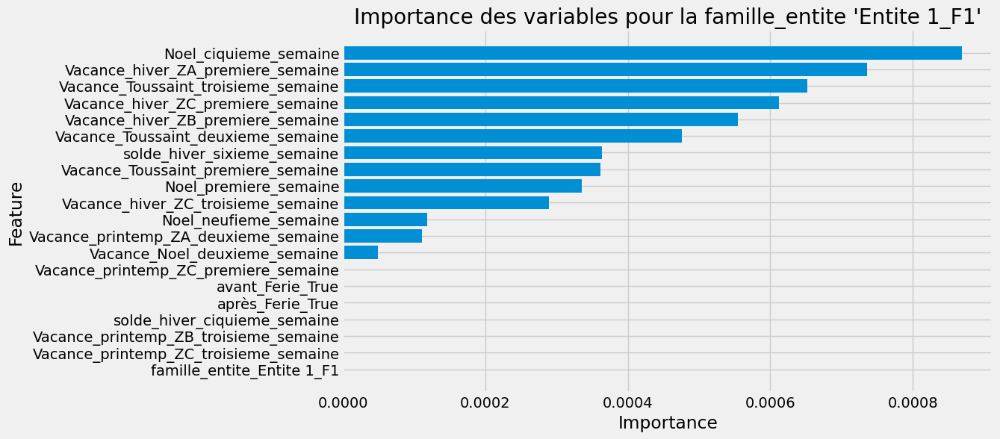

2023/05/27 12:27:23 INFO mlflow.tracking.fluent: Experiment with name 'Entite 1_F2' does not exist. Creating a new experiment.


Les noms des features les plus importants pour la famille_entite 'Entite 1_F2':
R2: -26.09246455136502
MAE: 134.03454585445076
MAPE: 2.4548481555295285
MSE: 22444.291186775543


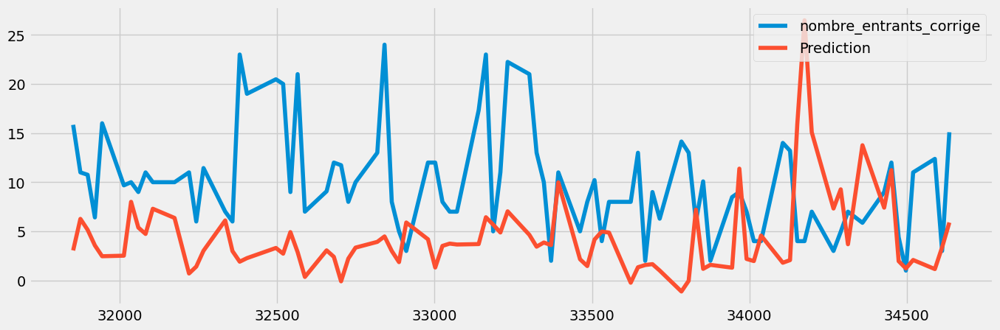

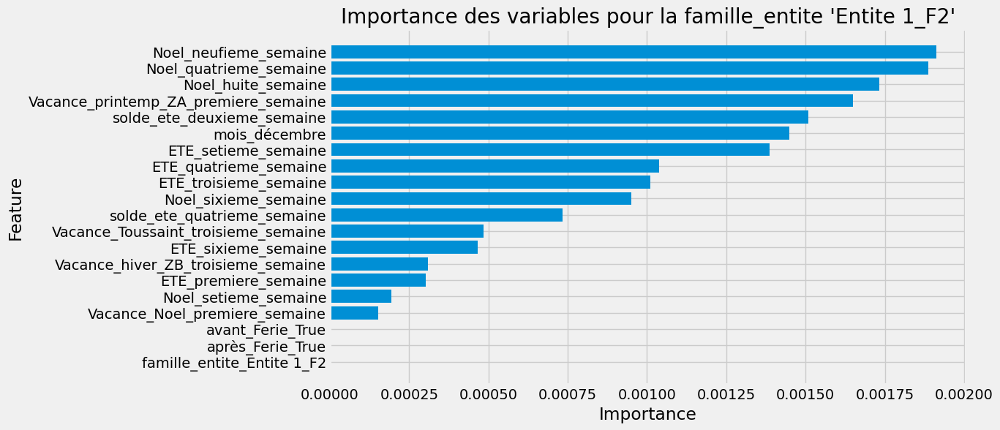

2023/05/27 12:27:24 INFO mlflow.tracking.fluent: Experiment with name 'Entite 1_F3' does not exist. Creating a new experiment.


Les noms des features les plus importants pour la famille_entite 'Entite 1_F3':
R2: 0.3547381037681159
MAE: 118.5610175031032
MAPE: 0.23027878042118036
MSE: 23412.211138454586


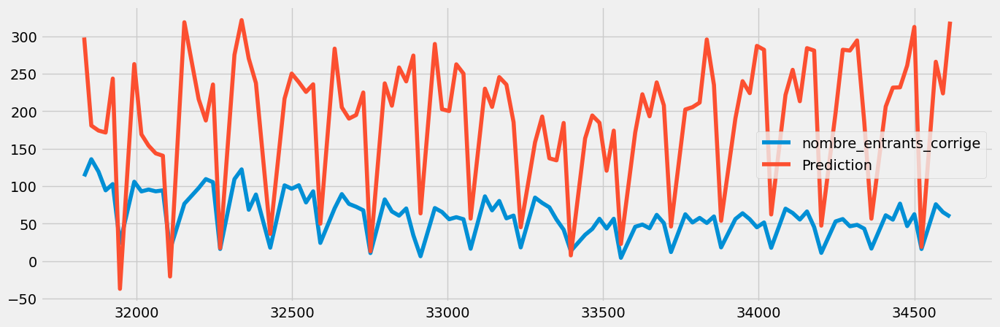

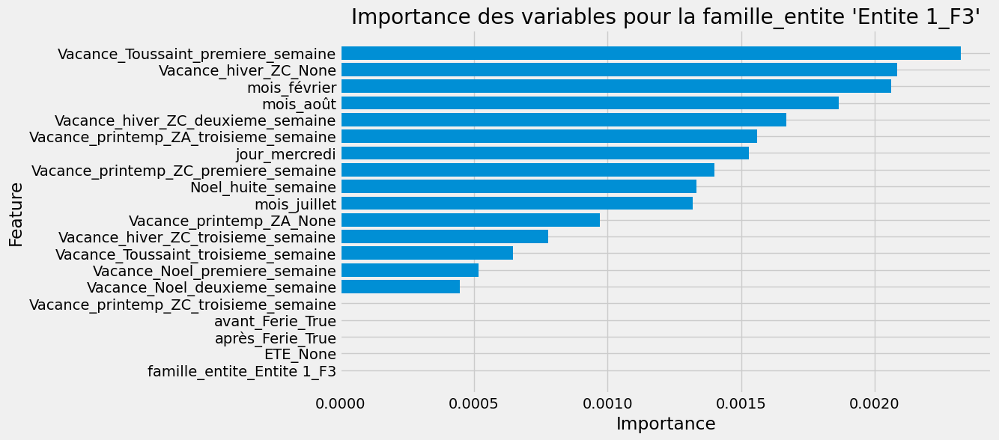

2023/05/27 12:27:25 INFO mlflow.tracking.fluent: Experiment with name 'Entite 1_F5' does not exist. Creating a new experiment.


Les noms des features les plus importants pour la famille_entite 'Entite 1_F5':
R2: -2.4643137482247064
MAE: 25.08390635865036
MAPE: 0.6992744247472588
MSE: 1096.5111260544243


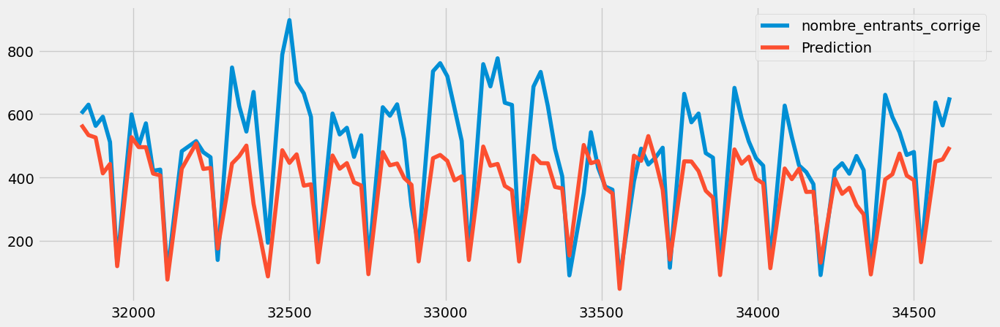

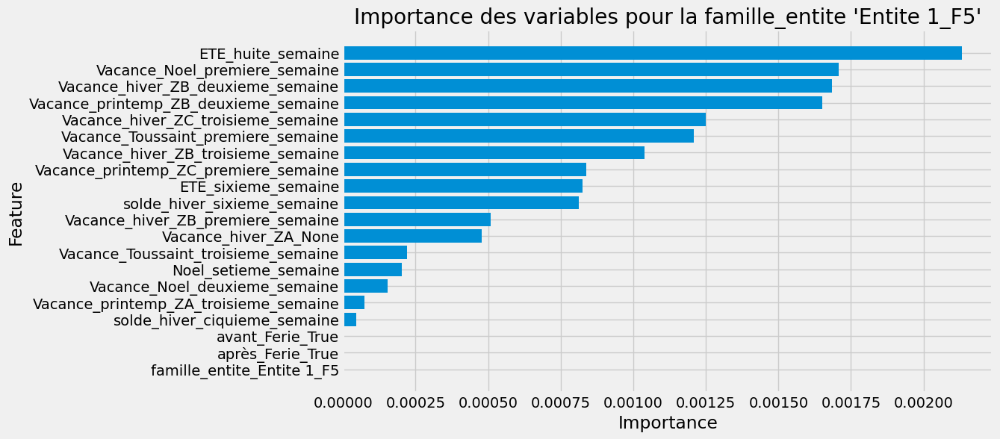

2023/05/27 12:27:25 INFO mlflow.tracking.fluent: Experiment with name 'Entite 1_F6' does not exist. Creating a new experiment.


Les noms des features les plus importants pour la famille_entite 'Entite 1_F6':
R2: 0.8213183924230006
MAE: 131.1048357485972
MAPE: 0.11491091044337161
MSE: 34508.63599889981


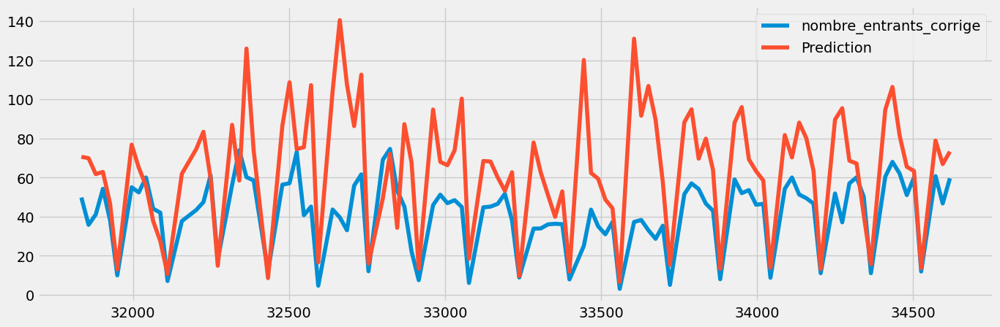

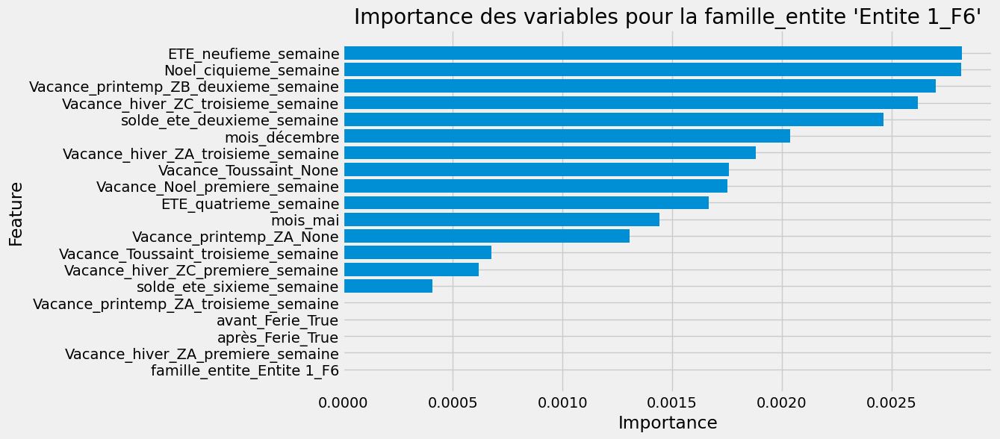

2023/05/27 12:27:26 INFO mlflow.tracking.fluent: Experiment with name 'Entite 1_F7' does not exist. Creating a new experiment.


Les noms des features les plus importants pour la famille_entite 'Entite 1_F7':
R2: -0.6214848836896301
MAE: 121.02145509006225
MAPE: 0.3689294778164938
MSE: 33542.03648140541


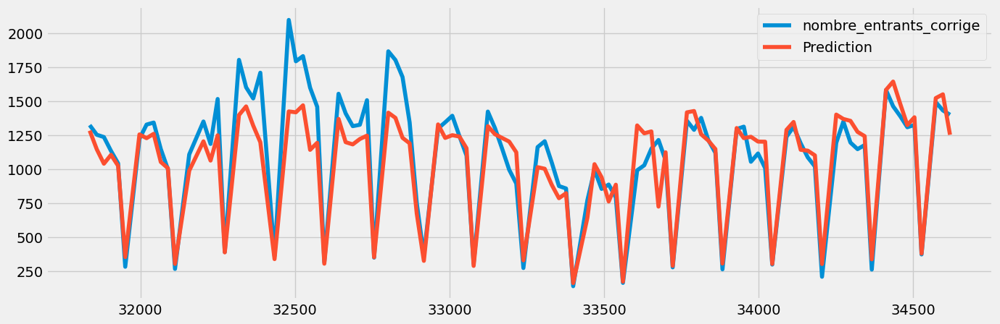

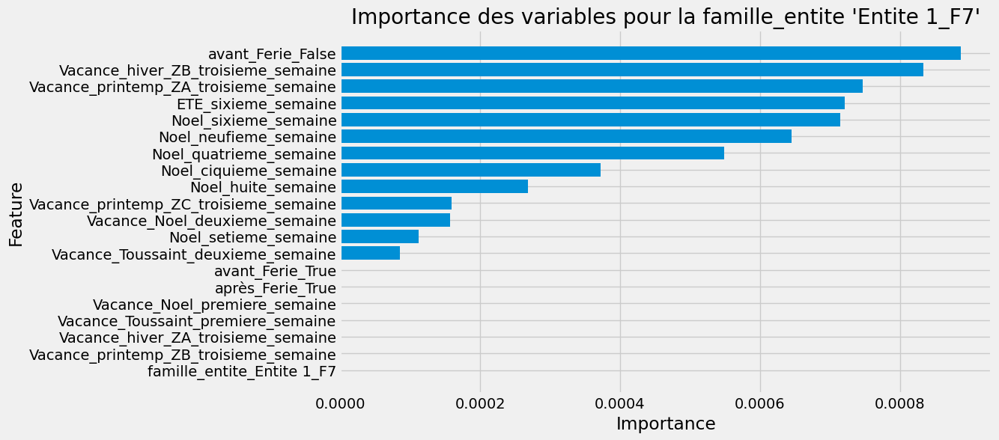

2023/05/27 12:27:28 INFO mlflow.tracking.fluent: Experiment with name 'Entite 2_F1' does not exist. Creating a new experiment.


Les noms des features les plus importants pour la famille_entite 'Entite 2_F1':
R2: 0.7915437009209665
MAE: 160.82390371052452
MAPE: 0.15097353246724138
MSE: 37468.66422940425


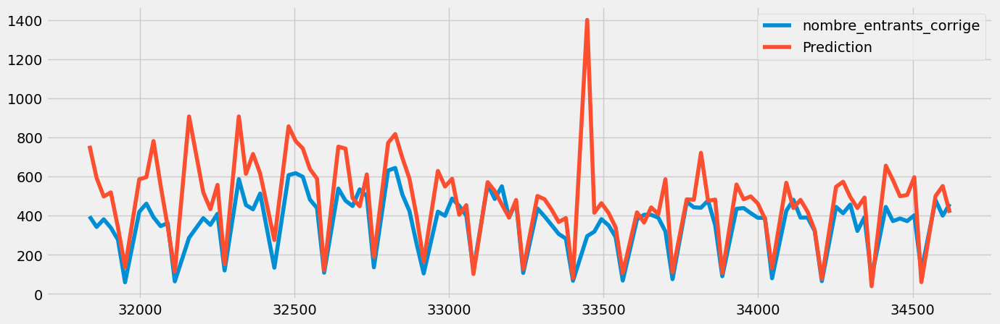

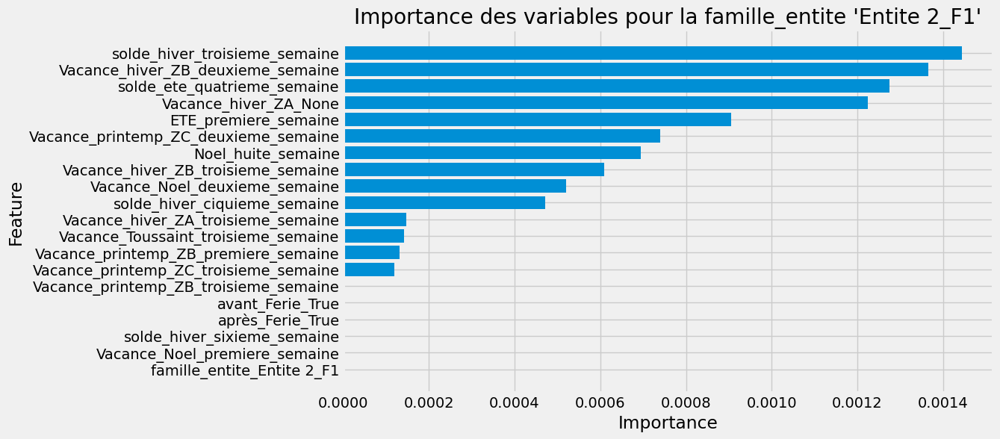

2023/05/27 12:27:29 INFO mlflow.tracking.fluent: Experiment with name 'Entite 2_F2' does not exist. Creating a new experiment.


Les noms des features les plus importants pour la famille_entite 'Entite 2_F2':
R2: -0.017499240683031436
MAE: 181.72118680702744
MAPE: 0.3804117530835876
MSE: 45611.45122224361


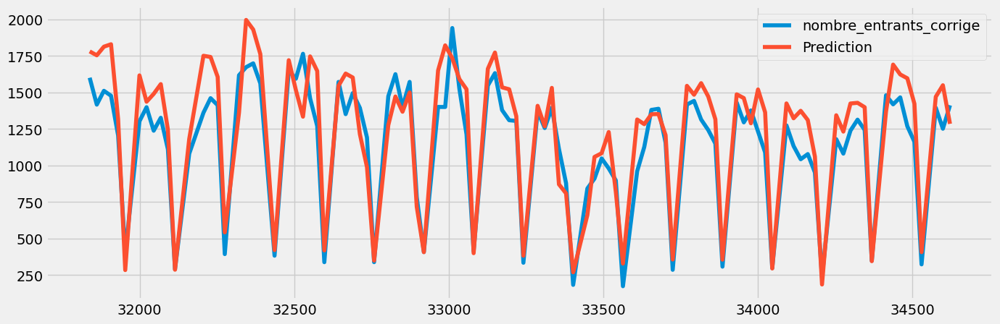

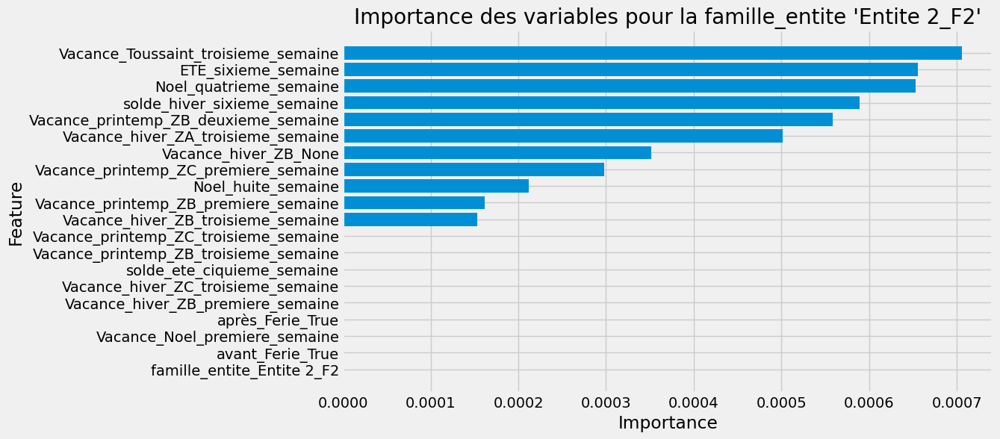

2023/05/27 12:27:30 INFO mlflow.tracking.fluent: Experiment with name 'Entite 2_F3' does not exist. Creating a new experiment.


Les noms des features les plus importants pour la famille_entite 'Entite 2_F3':
R2: 0.26264876652187885
MAE: 133.72402157139638
MAPE: 0.3210224728098022
MSE: 33534.71428747944


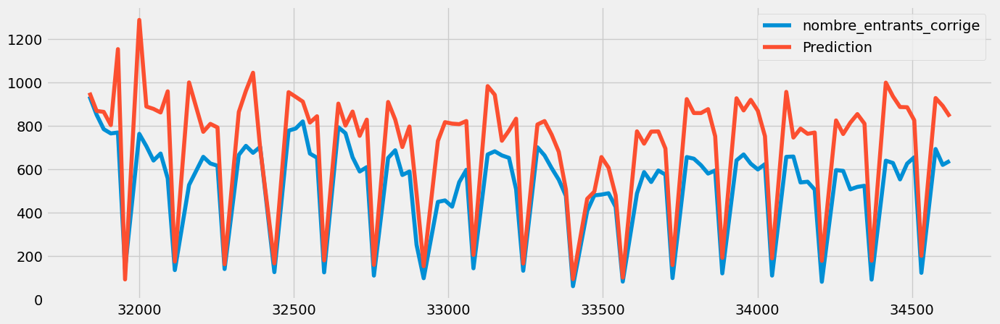

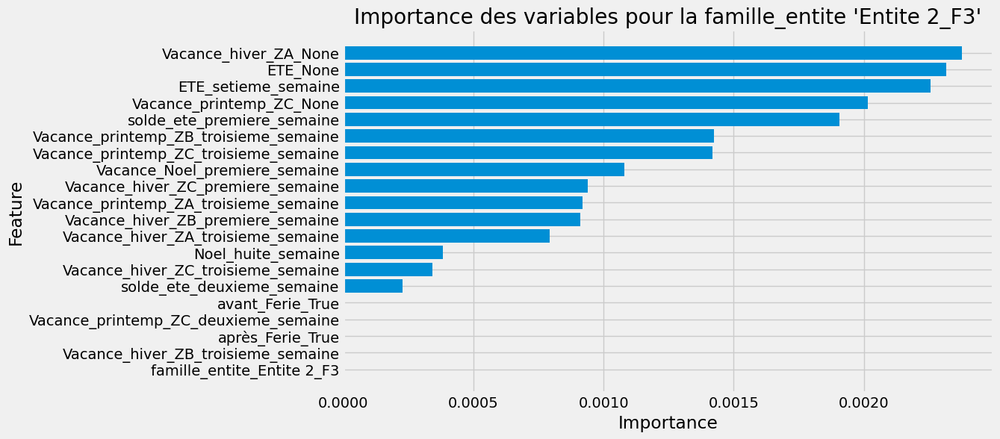

2023/05/27 12:27:31 INFO mlflow.tracking.fluent: Experiment with name 'Entite 3_F2' does not exist. Creating a new experiment.


Les noms des features les plus importants pour la famille_entite 'Entite 3_F2':
R2: -3.7182658707886516
MAE: 2.62236517643487
MAPE: 1.4005237664378414
MSE: 15.324959651179425


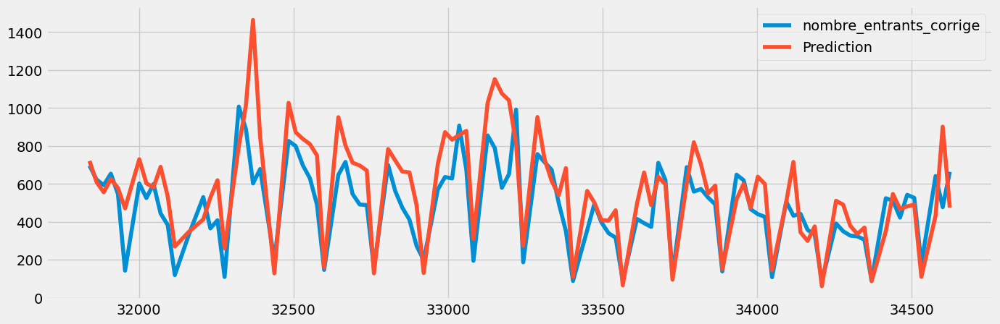

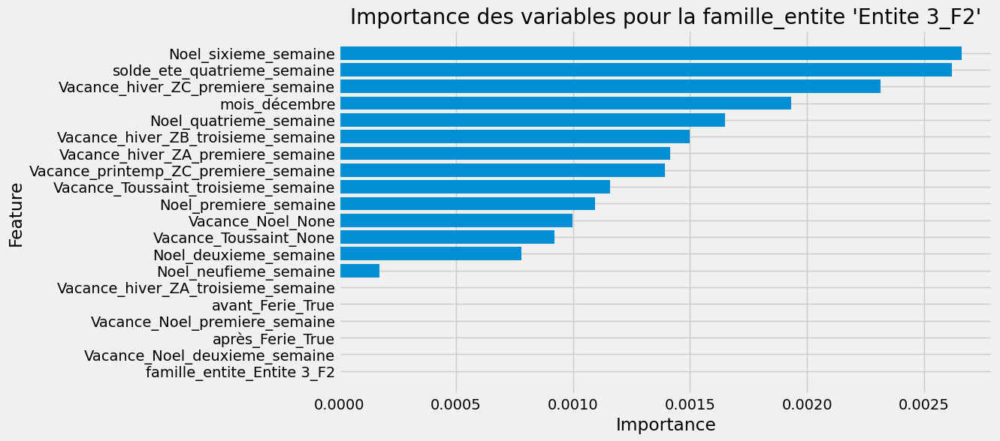

2023/05/27 12:27:32 INFO mlflow.tracking.fluent: Experiment with name 'Entite 3_F7' does not exist. Creating a new experiment.


Les noms des features les plus importants pour la famille_entite 'Entite 3_F7':
R2: 0.02961371767954346
MAE: 146.33392778558803
MAPE: 0.5999026005892664
MSE: 34140.405734600725


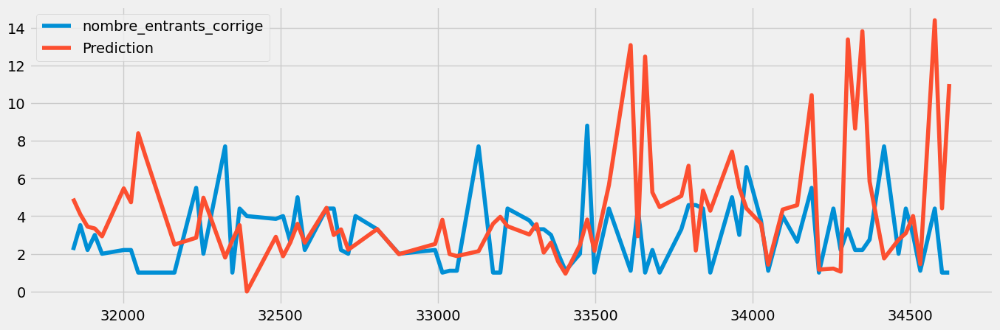

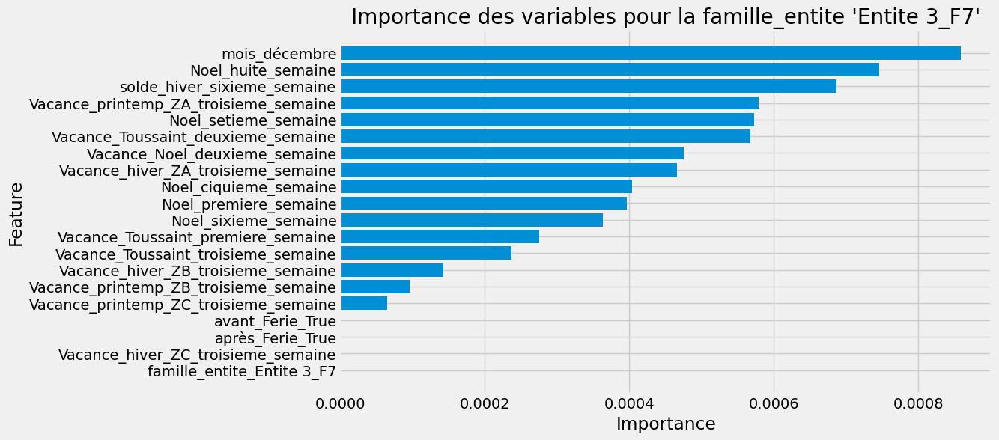

2023/05/27 12:27:33 INFO mlflow.tracking.fluent: Experiment with name 'Entite 4_F5' does not exist. Creating a new experiment.


Les noms des features les plus importants pour la famille_entite 'Entite 4_F5':
R2: -0.8747765201826281
MAE: 7.075913385847706
MAPE: 0.4802342421112933
MSE: 71.64290524343791


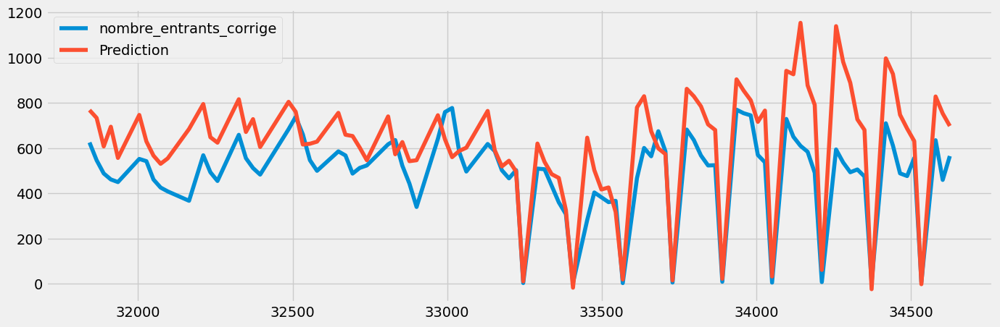

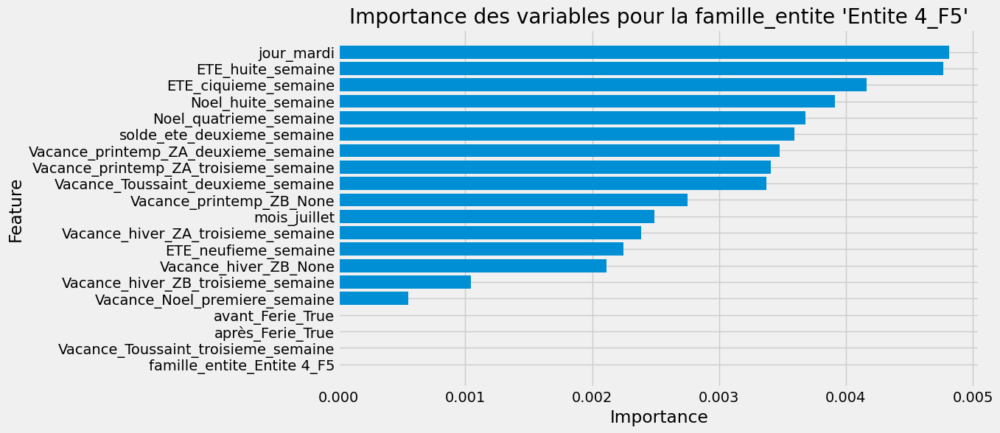

2023/05/27 12:27:34 INFO mlflow.tracking.fluent: Experiment with name 'Entite 4_F7' does not exist. Creating a new experiment.


Les noms des features les plus importants pour la famille_entite 'Entite 4_F7':
R2: -0.867593315460718
MAE: 40.08687665345608
MAPE: 0.2603221625034973
MSE: 2472.4950990634297


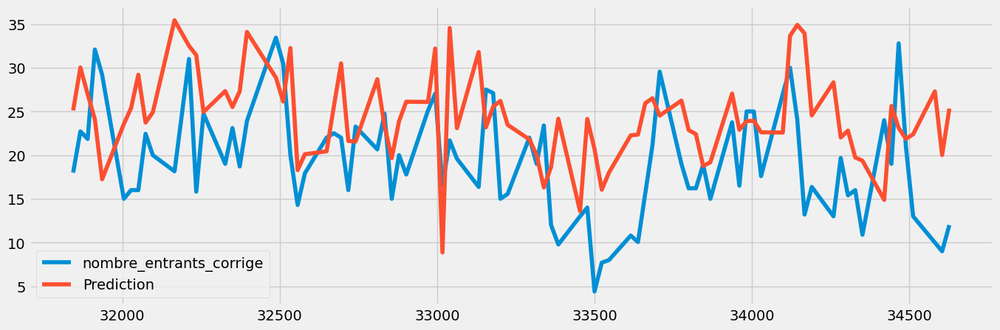

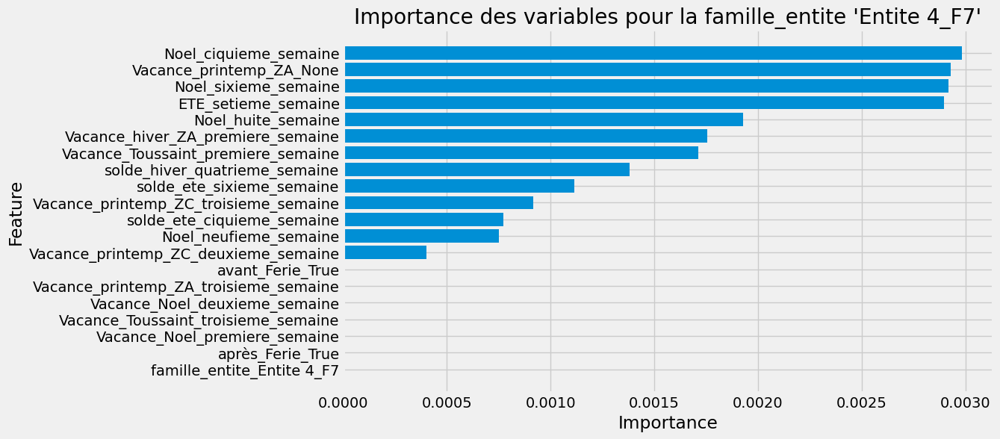

2023/05/27 12:27:35 INFO mlflow.tracking.fluent: Experiment with name 'Entite 5_F1' does not exist. Creating a new experiment.


Les noms des features les plus importants pour la famille_entite 'Entite 5_F1':
R2: -0.29440549808422456
MAE: 20.032139933487343
MAPE: 1.8528168842907597
MSE: 1266.4670861538875


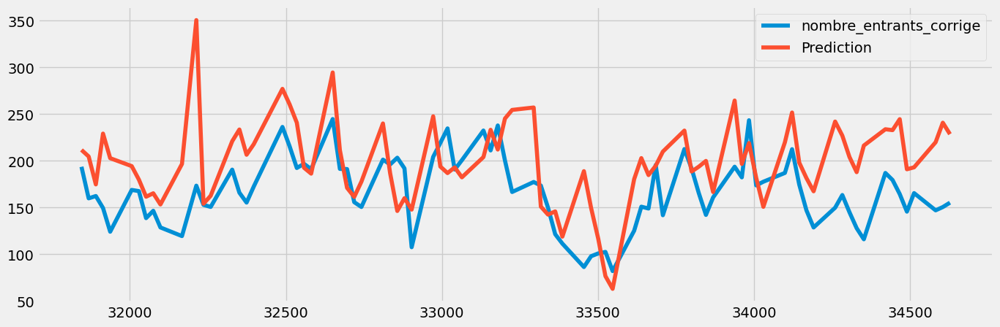

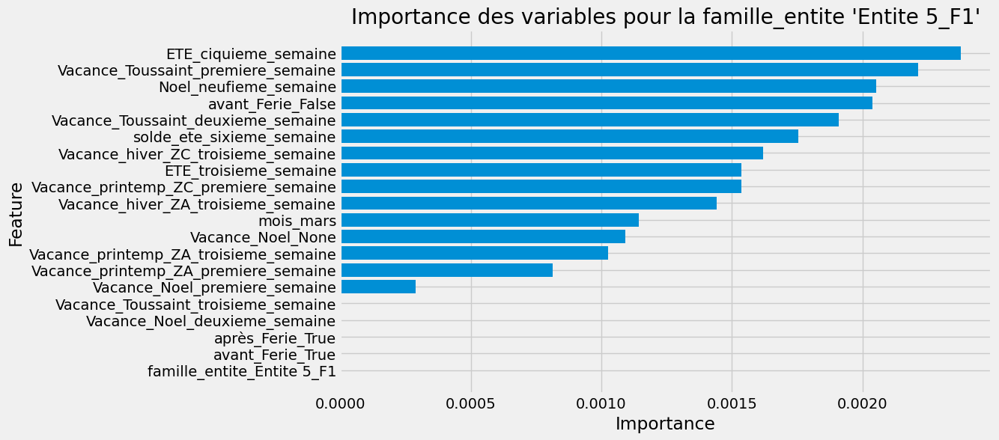

2023/05/27 12:27:36 INFO mlflow.tracking.fluent: Experiment with name 'Entite 5_F2' does not exist. Creating a new experiment.


Les noms des features les plus importants pour la famille_entite 'Entite 5_F2':
R2: 0.5691812444880134
MAE: 138.00139167348598
MAPE: 0.24167130440410087
MSE: 30586.98553914778


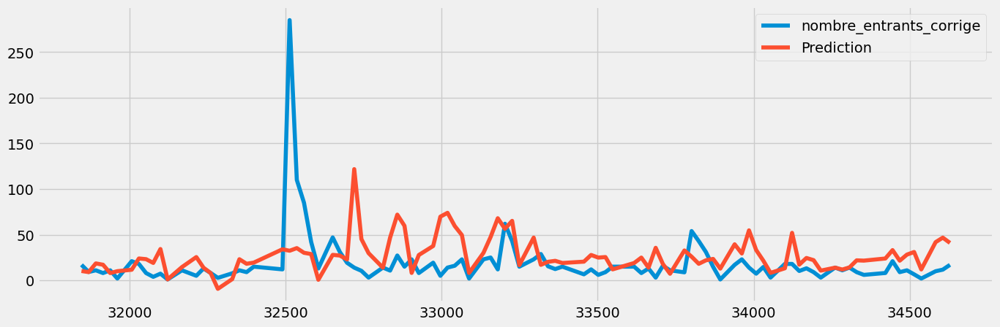

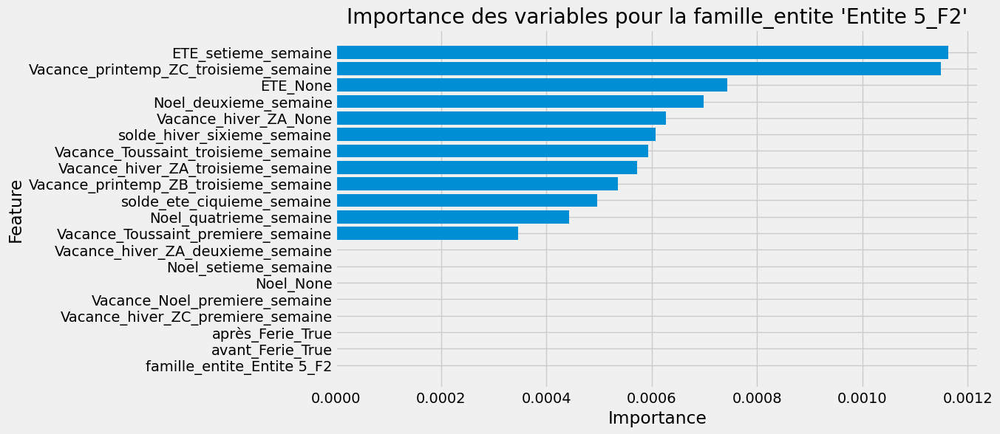

2023/05/27 12:27:38 INFO mlflow.tracking.fluent: Experiment with name 'Entite 5_F3' does not exist. Creating a new experiment.


Les noms des features les plus importants pour la famille_entite 'Entite 5_F3':
R2: -0.6188807943070422
MAE: 230.868493565154
MAPE: 0.4394520209304529
MSE: 90977.01388022694


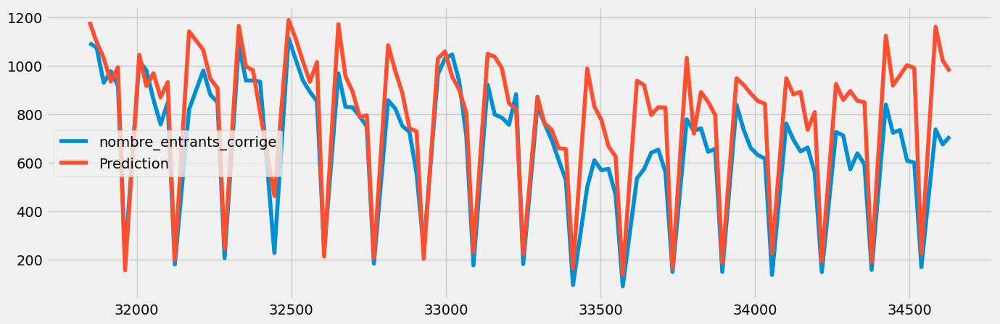

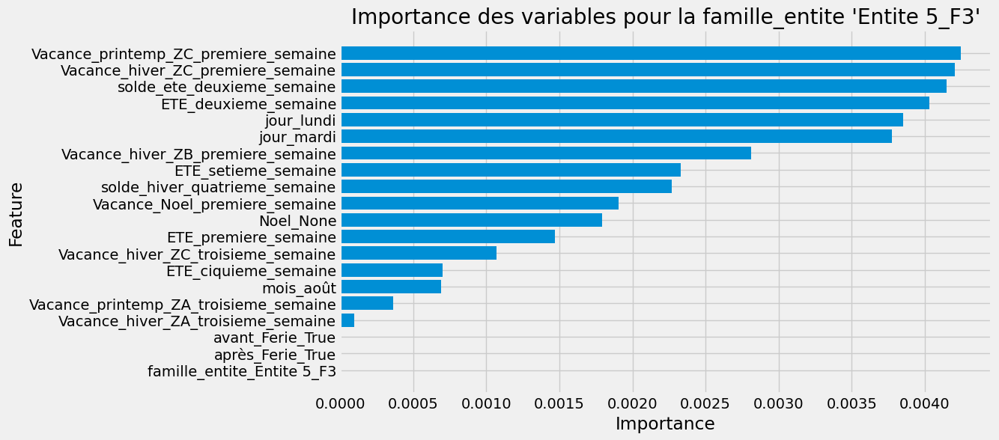

2023/05/27 12:27:38 INFO mlflow.tracking.fluent: Experiment with name 'Entite 5_F5' does not exist. Creating a new experiment.


Les noms des features les plus importants pour la famille_entite 'Entite 5_F5':
R2: 0.7929186634967473
MAE: 49.42740968075657
MAPE: 0.14874448884174438
MSE: 4135.036414479589


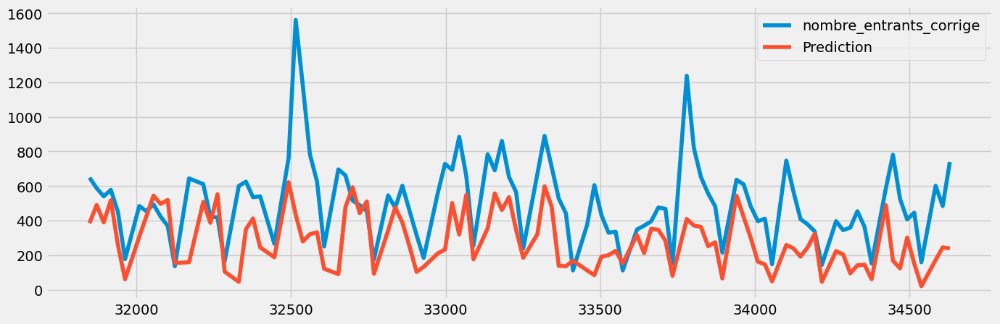

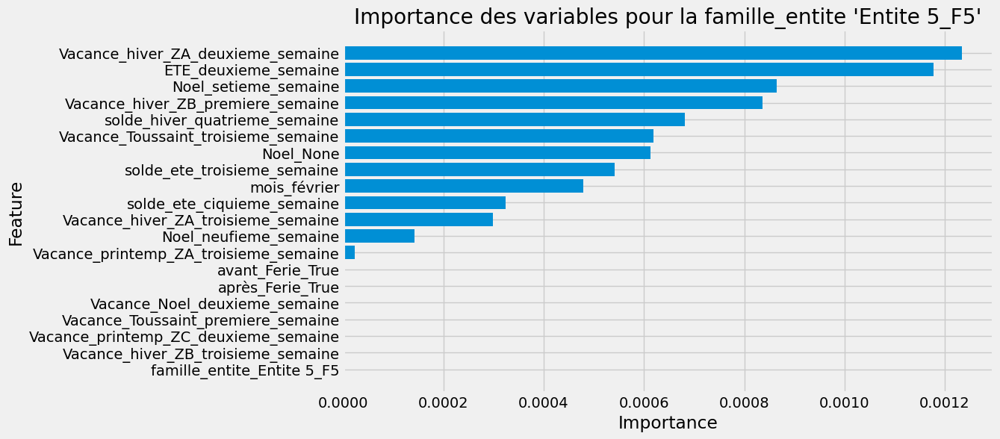

2023/05/27 12:27:39 INFO mlflow.tracking.fluent: Experiment with name 'Entite 5_F6' does not exist. Creating a new experiment.


Les noms des features les plus importants pour la famille_entite 'Entite 5_F6':
R2: -0.30039987371520716
MAE: 164.25140808656326
MAPE: 0.2804412695647165
MSE: 41617.909933501076


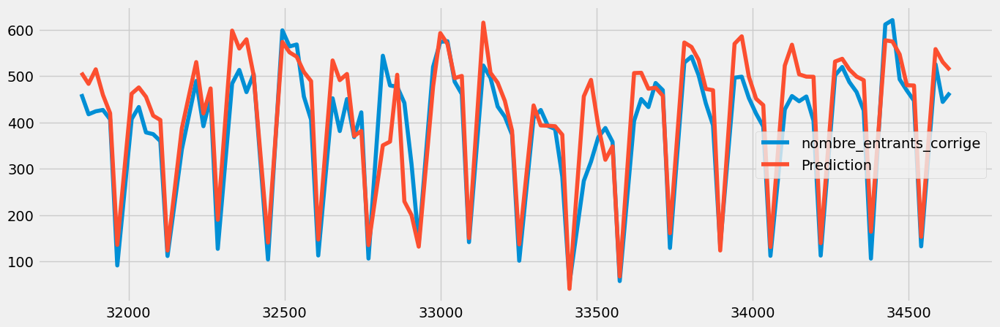

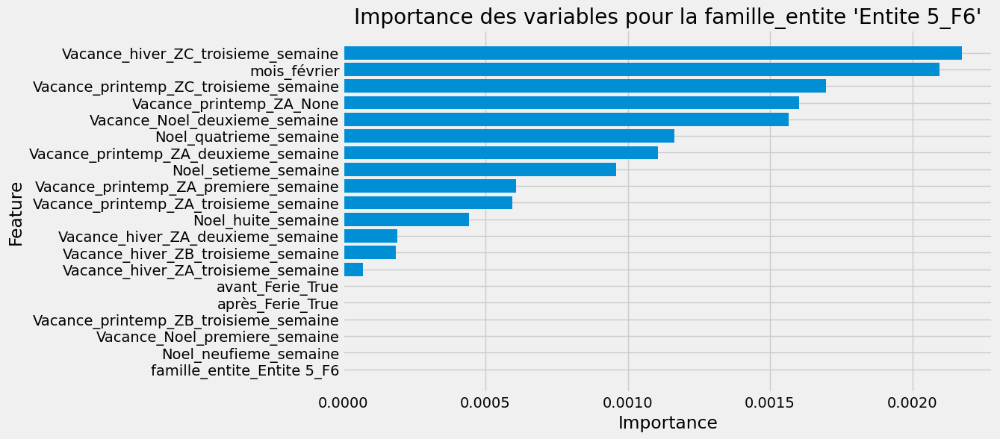

2023/05/27 12:27:40 INFO mlflow.tracking.fluent: Experiment with name 'Entite 5_F7' does not exist. Creating a new experiment.


Les noms des features les plus importants pour la famille_entite 'Entite 5_F7':
R2: 0.7709713819837323
MAE: 408.96246608088745
MAPE: 0.13182883678150556
MSE: 277101.93726489134


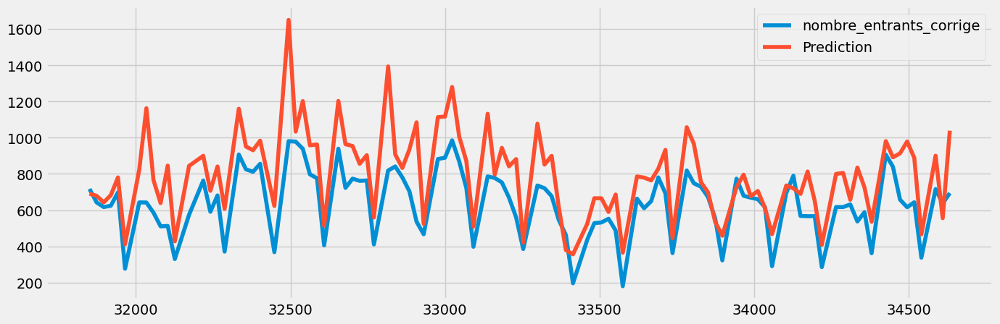

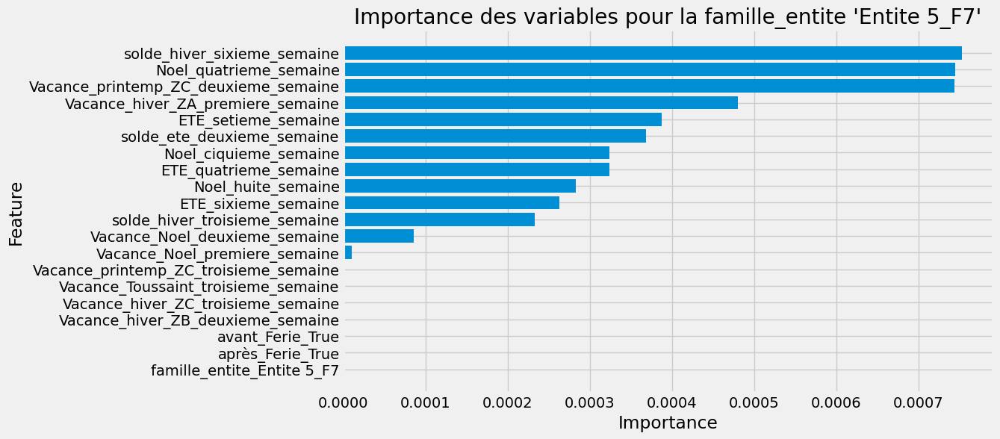

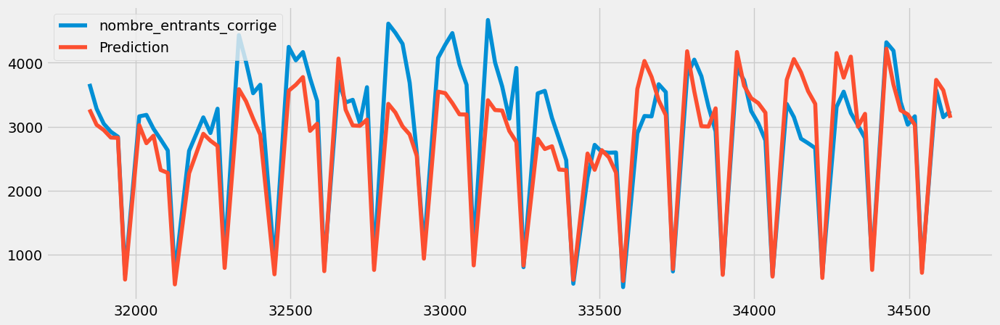

In [ ]:
import datetime
import pandas as pd
import xgboost as xgb
import matplotlib.pyplot as plt
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import OneHotEncoder, OrdinalEncoder, StandardScaler
from sklearn.metrics import r2_score, mean_absolute_error, mean_absolute_percentage_error, mean_squared_error
import mlflow
import mlflow.sklearn

# Convertir la colonne "date" en objets datetime
df_all['date'] = pd.to_datetime(df_all['date'])
# df_all_data[df_all_data['']]
# Définir la date initiale
date_initiale = datetime.datetime(2022, 10, 15)
# Parcourir chaque groupe de famille_entite
for famille_entite, group_df in df_all.groupby('famille_entite'):
    mlflow.set_experiment(f"{famille_entite}")
    with mlflow.start_run(run_name='run_jour_avant',nested=True):

        # Séparer les données en ensemble d'entraînement et ensemble de test
        train_df = group_df.loc[group_df['date'] <= date_initiale]
        test_df = group_df.loc[group_df['date'] > date_initiale]

        # Séparer les caractéristiques et la variable cible
        X_train = train_df.drop(['date', 'nombre_entrants_corrige'], axis=1)
        X_test = test_df.drop(['date', 'nombre_entrants_corrige'], axis=1)
        y_train = train_df['nombre_entrants_corrige']
        y_test = test_df['nombre_entrants_corrige']

        cols_cat = X_train.select_dtypes('object').columns  # Ajoutez d'autres colonnes catégorielles si nécessaire
        cols_num = X_train.select_dtypes(exclude='object').columns

        # Créer un pipeline pour l'encodage des colonnes catégorielles et l'entraînement du modèle
        pipeline = Pipeline([
            ('encoding', ColumnTransformer([
                ('onehot', OneHotEncoder(), cols_cat),
                ('scaler', StandardScaler(with_mean=False), cols_num)
            ])),
            ('regressor', xgb.XGBRegressor( n_estimators=100, max_depth=2,
            learning_rate=0.1))
        ])

        # Entraîner le modèle
        pipeline.fit(X_train, y_train)

        # Obtenir les noms des features après l'encodage
        encoded_feature_names = []
        encoded_feature_names += list(pipeline.named_steps['encoding'].transformers_[0][1].get_feature_names_out(cols_cat))
        encoded_feature_names += list(cols_num)

        # Obtenir l'importance des caractéristiques
        importance = pipeline.named_steps['regressor'].feature_importances_

        # Créer un DataFrame avec les noms des features et leur importance
        feature_importance_df = pd.DataFrame({'Feature': encoded_feature_names, 'Importance': importance})

        # Trier les features par importance décroissante
        feature_importance_df = feature_importance_df.sort_values('Importance', ascending=True).reset_index(drop=True)

        # Prédire les valeurs pour l'ensemble de test
        y_pred = pipeline.predict(X_test)

        # Afficher les noms des features les plus importants
        print(f"Les noms des features les plus importants pour la famille_entite '{famille_entite}':")

        # Afficher le meilleur score
        print('R2:', r2_score(y_pred=y_pred, y_true=y_test))
        print('MAE:', mean_absolute_error(y_pred=y_pred, y_true=y_test))
        print('MAPE:', mean_absolute_percentage_error(y_pred=y_pred, y_true=y_test))
        print('MSE:', mean_squared_error(y_pred=y_pred, y_true=y_test))

        # Tracer le barplot des features les plus importants
        plt.figure(figsize=(10, 6))
        plt.barh(feature_importance_df['Feature'][:20], feature_importance_df['Importance'][:20])
        plt.xlabel('Importance')
        plt.ylabel('Feature')
        plt.title(f"Importance des variables pour la famille_entite '{famille_entite}'")
        plt.show()

        df_test=pd.DataFrame({'nombre_entrants_corrige': y_test, 'Prediction': pipeline.predict(X_test)},index=X_test.index)

        # df_test.plot(figsize=(15, 5))

        df_test.plot( figsize=(15, 5))

        # Enregistrer les métriques et les paramètres dans MLflow
        mlflow.log_metric('R2', r2_score(y_pred=y_pred, y_true=y_test))
        mlflow.log_metric('MAE', mean_absolute_error(y_pred=y_pred, y_true=y_test))
        mlflow.log_metric('MAPE', mean_absolute_percentage_error(y_pred=y_pred, y_true=y_test))
        mlflow.log_metric('MSE', mean_squared_error(y_pred=y_pred, y_true=y_test))
        mlflow.log_params({
            'famille_entite': famille_entite,
            'encoding_cols_cat': list(cols_cat),
            'encoding_cols_num': list(cols_num)
        })

        # Terminer l'enregistrement MLflow
        mlflow.end_run()


### grid search 

Les noms des features les plus importants pour la famille_entite 'Entite 1_F1':
Meilleurs paramètres :  {'regressor__max_depth': 2, 'regressor__n_estimators': 100}
R2:  -1.4657258094345118
MAE:  6.677020247035481
MAPE:  0.6669962334289687
mape:  66.69962334289687
MSE:  69.55825270495758


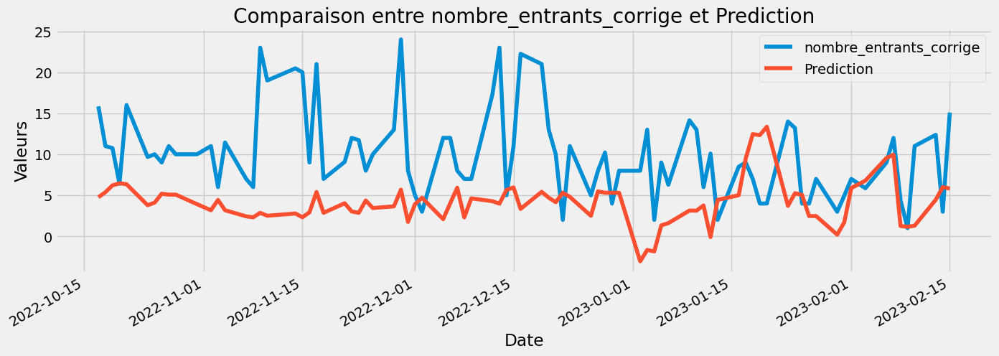

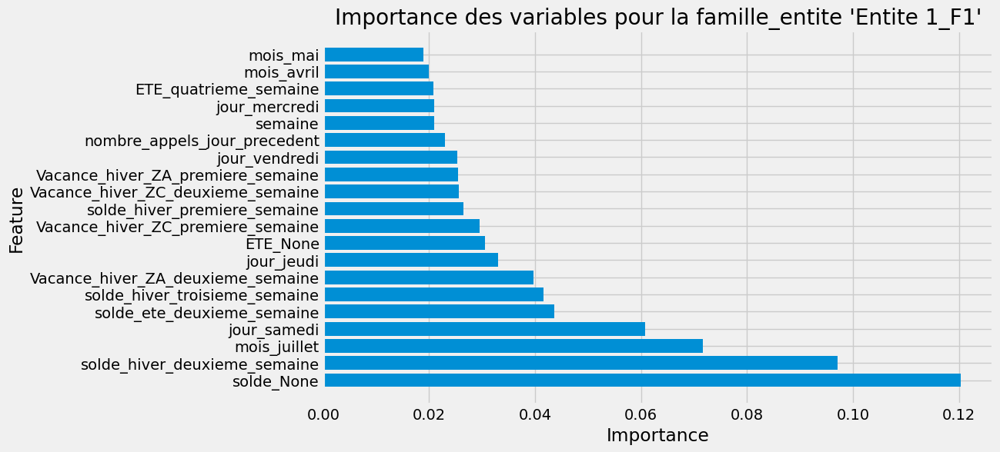

Les noms des features les plus importants pour la famille_entite 'Entite 1_F2':
Meilleurs paramètres :  {'regressor__max_depth': 2, 'regressor__n_estimators': 100}
R2:  -21.471333949403174
MAE:  121.93678008668952
MAPE:  2.177202083669692
mape:  217.7202083669692
MSE:  18615.994183898212


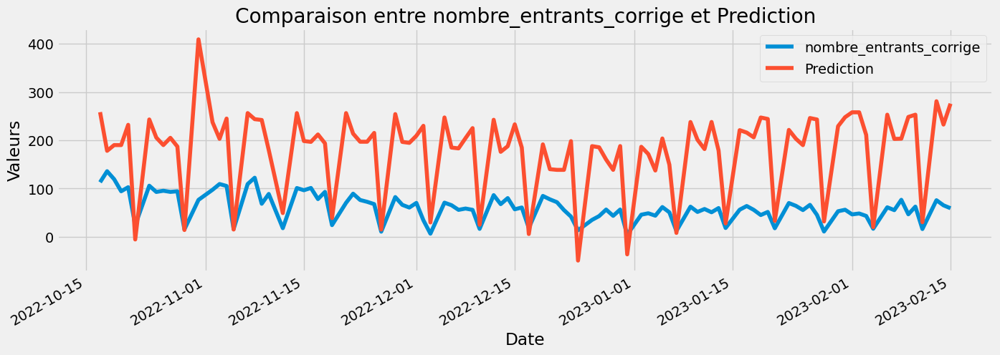

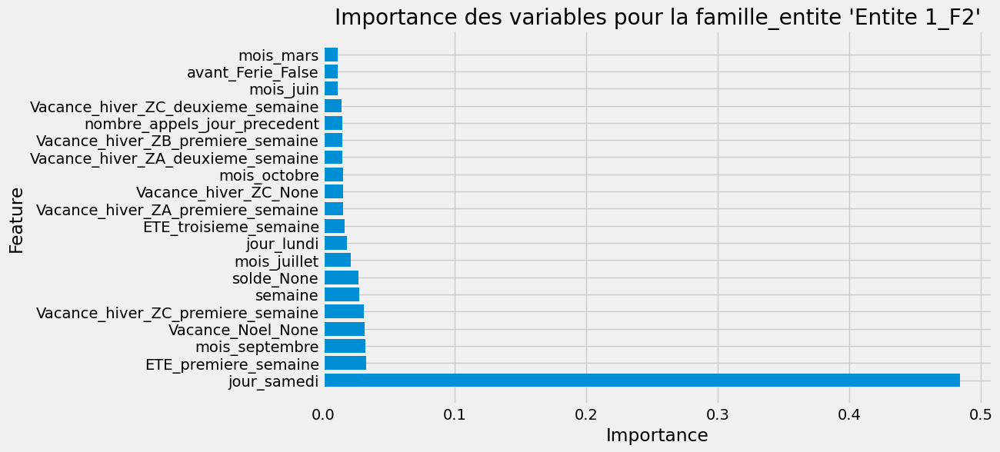

Les noms des features les plus importants pour la famille_entite 'Entite 1_F3':
Meilleurs paramètres :  {'regressor__max_depth': 2, 'regressor__n_estimators': 100}
R2:  0.46151854561550176
MAE:  113.35755158756345
MAPE:  0.24060885720860853
mape:  24.060885720860853
MSE:  19537.867612845144


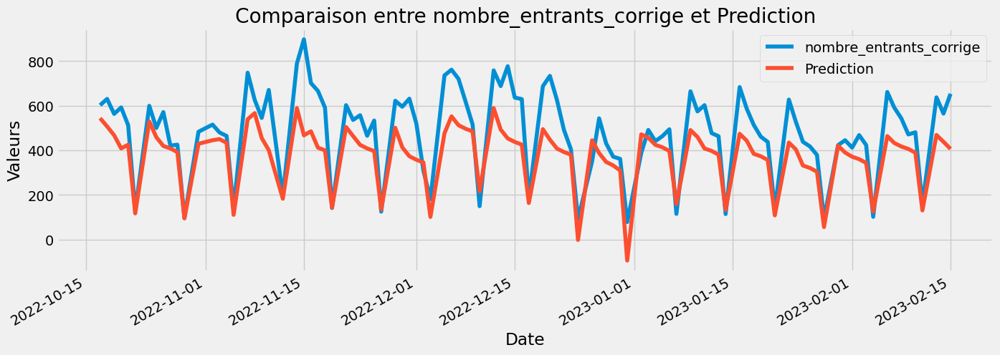

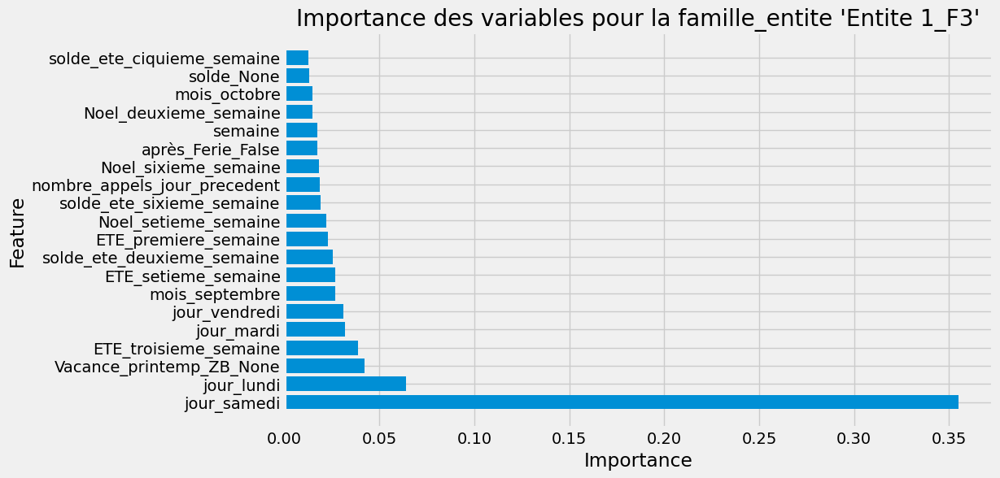

Les noms des features les plus importants pour la famille_entite 'Entite 1_F5':
Meilleurs paramètres :  {'regressor__max_depth': 2, 'regressor__n_estimators': 100}
R2:  -2.03071486262562
MAE:  26.158845113769825
MAPE:  0.8595636537605968
mape:  85.95636537605968
MSE:  959.2700916510476


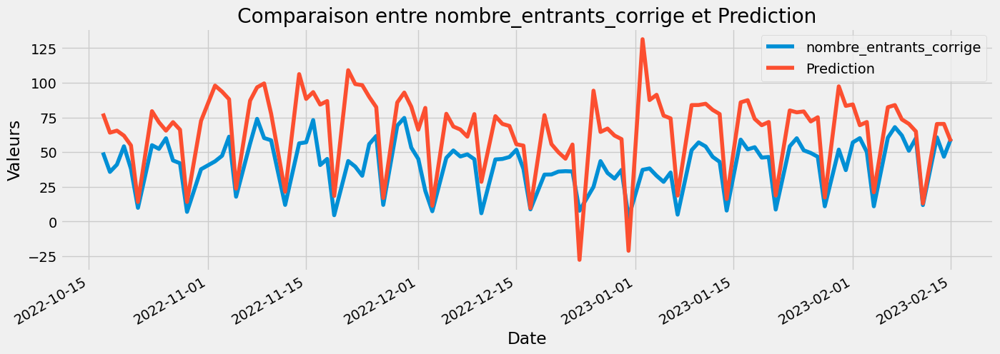

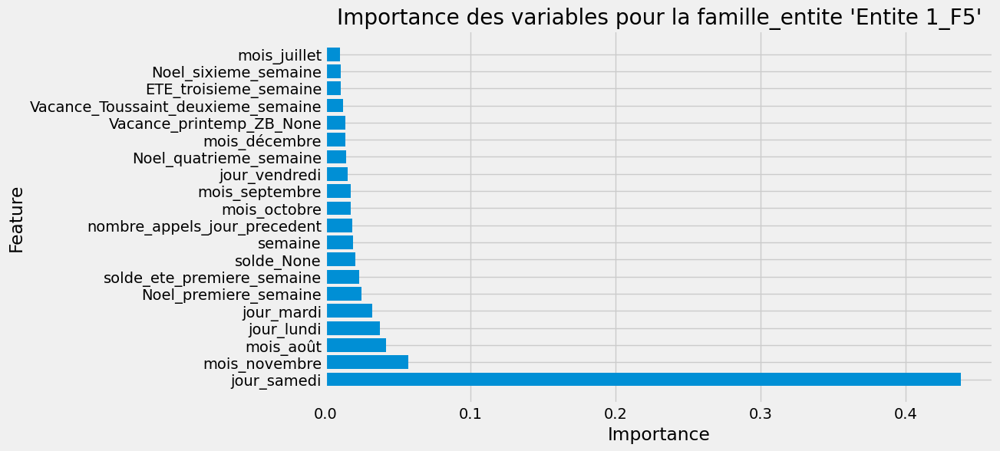

Les noms des features les plus importants pour la famille_entite 'Entite 1_F6':
Meilleurs paramètres :  {'regressor__max_depth': 2, 'regressor__n_estimators': 100}
R2:  0.8038809242929396
MAE:  140.8944255181271
MAPE:  0.13539915641101313
mape:  13.539915641101313
MSE:  37876.32027599244


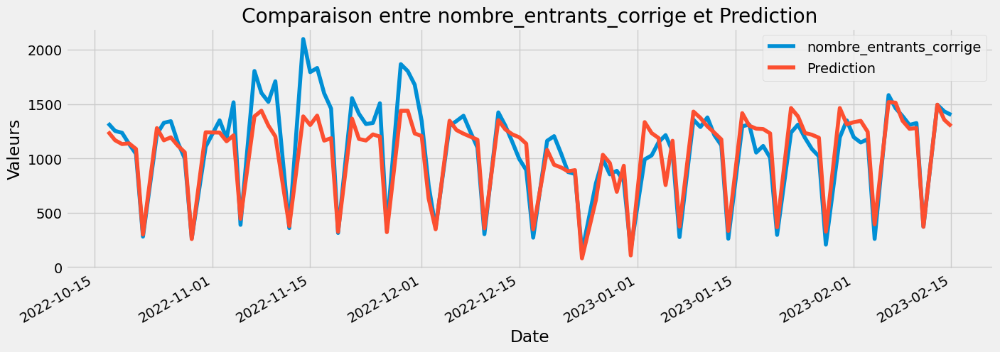

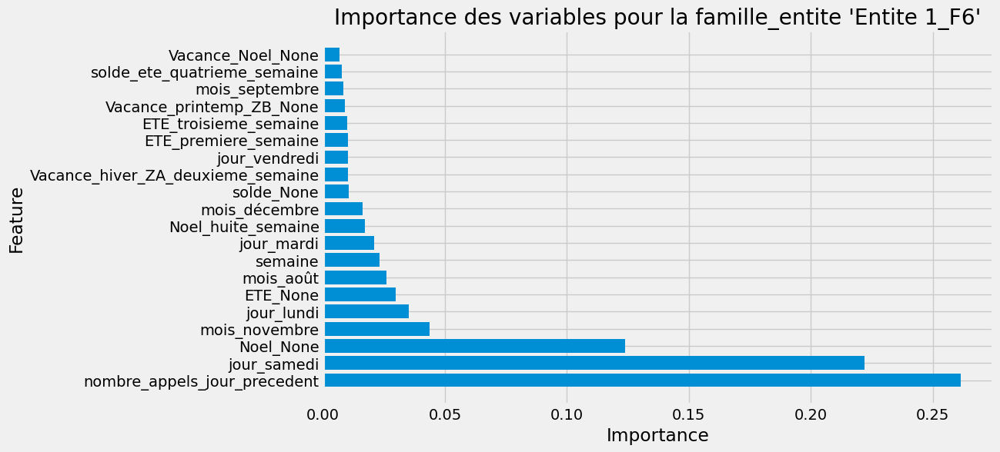

Les noms des features les plus importants pour la famille_entite 'Entite 1_F7':
Meilleurs paramètres :  {'regressor__max_depth': 2, 'regressor__n_estimators': 100}
R2:  -1.5165511509776954
MAE:  137.31989355422755
MAPE:  0.521466868892162
mape:  52.1466868892162
MSE:  52057.37738445281


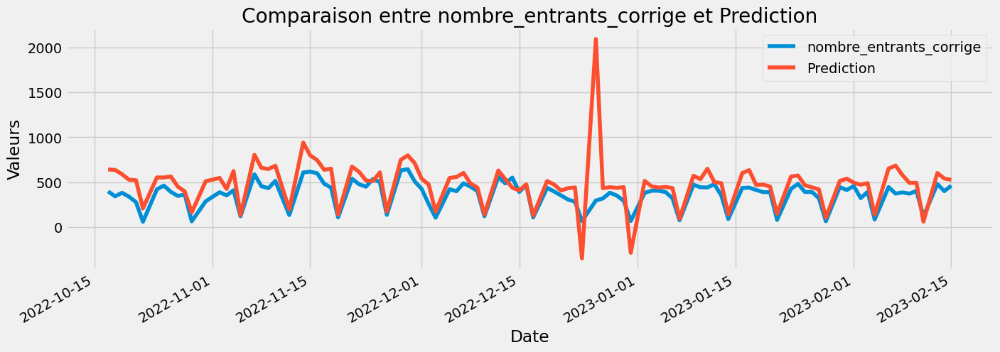

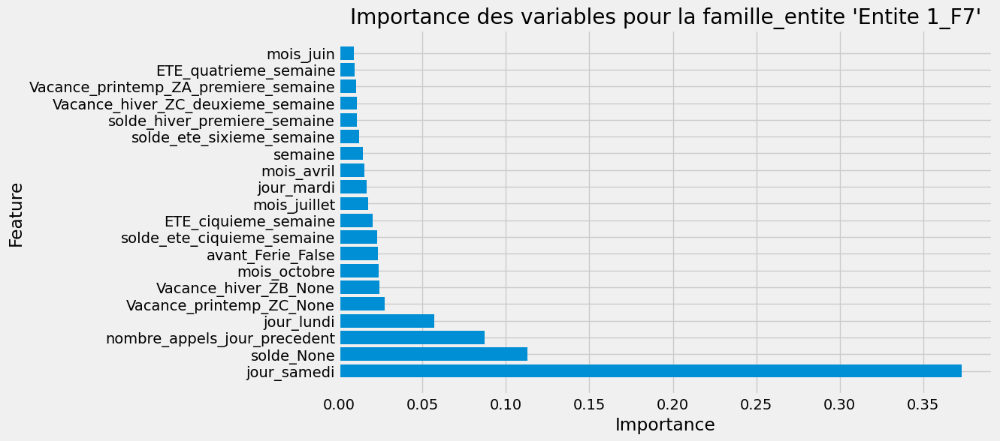

Les noms des features les plus importants pour la famille_entite 'Entite 2_F1':
Meilleurs paramètres :  {'regressor__max_depth': 2, 'regressor__n_estimators': 100}
R2:  0.8394525628419878
MAE:  134.61020408295525
MAPE:  0.15020685001850967
mape:  15.020685001850968
MSE:  28857.357836350337


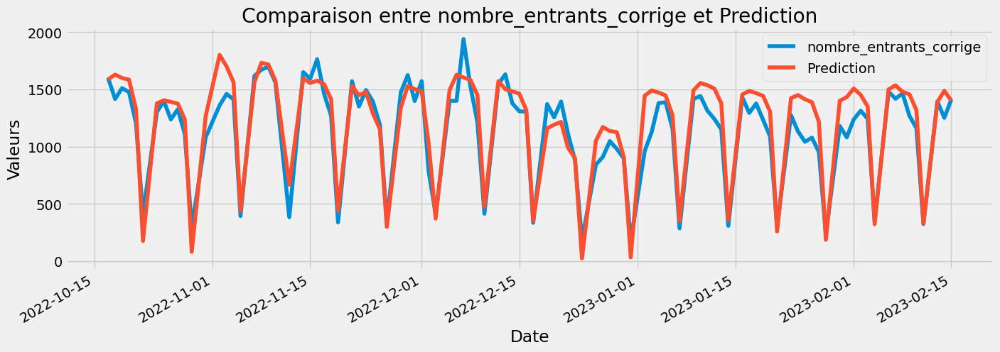

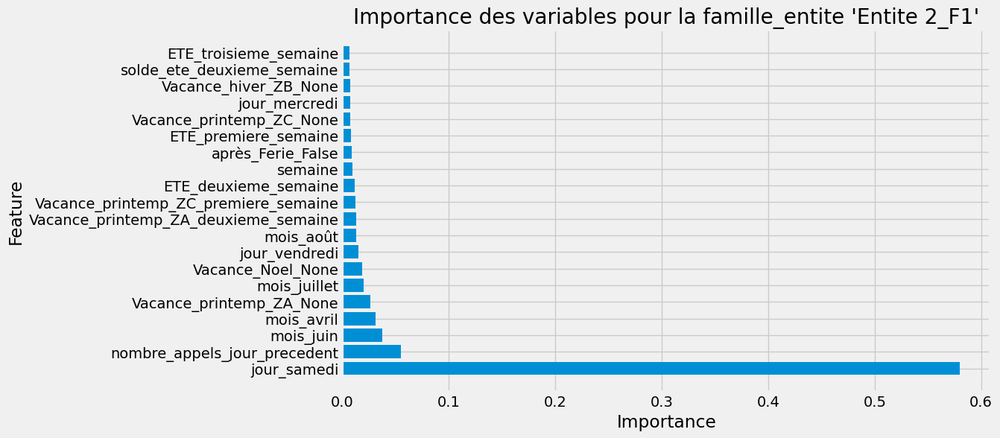

Les noms des features les plus importants pour la famille_entite 'Entite 2_F2':
Meilleurs paramètres :  {'regressor__max_depth': 2, 'regressor__n_estimators': 100}
R2:  -0.10585165890875592
MAE:  196.1894829672771
MAPE:  0.40123710303807314
mape:  40.123710303807314
MSE:  49572.0261820487


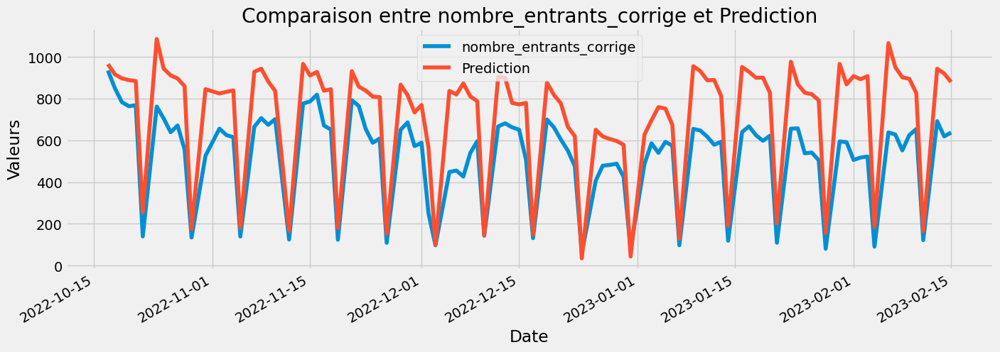

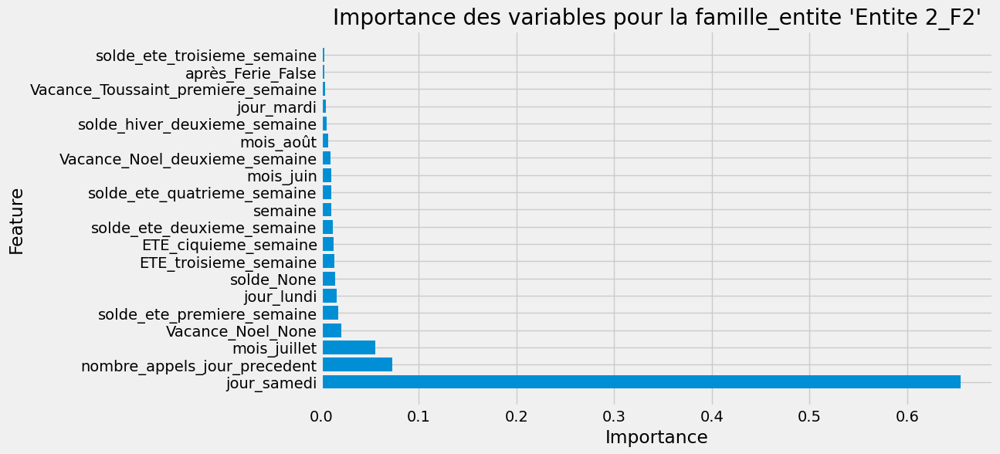

Les noms des features les plus importants pour la famille_entite 'Entite 2_F3':
Meilleurs paramètres :  {'regressor__max_depth': 2, 'regressor__n_estimators': 100}
R2:  0.7268936006681352
MAE:  83.7160572993108
MAPE:  0.21180242250381293
mape:  21.180242250381294
MSE:  12420.871703808041


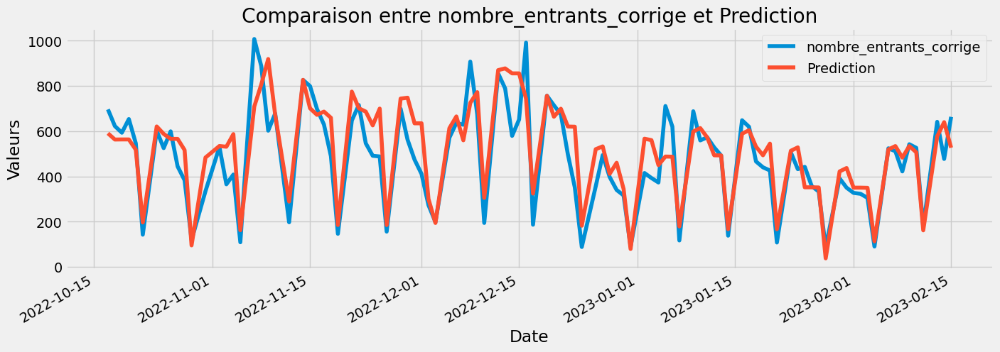

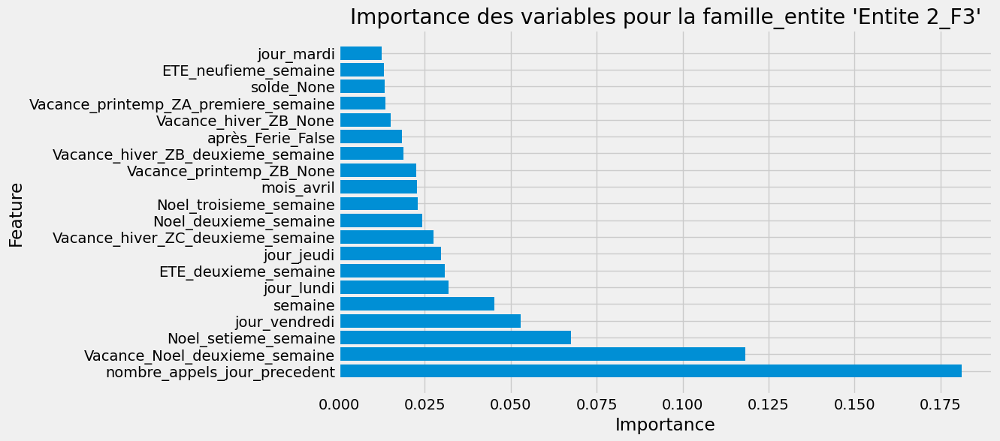

Les noms des features les plus importants pour la famille_entite 'Entite 3_F2':
Meilleurs paramètres :  {'regressor__max_depth': 2, 'regressor__n_estimators': 100}
R2:  -1.5286092943470009
MAE:  2.108341656983653
MAPE:  1.1697487227858139
mape:  116.97487227858139
MSE:  8.212940192577134


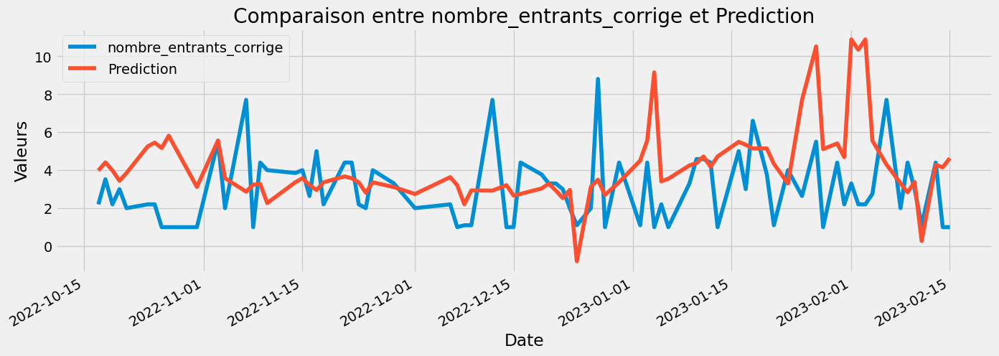

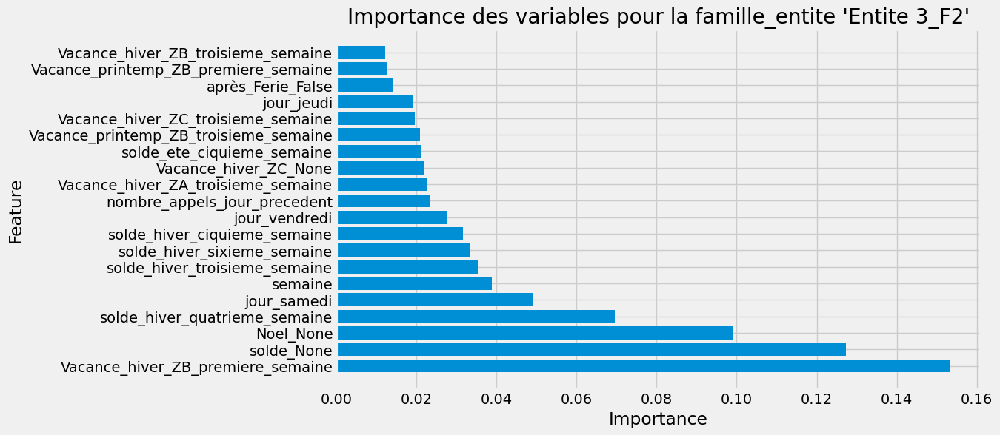

Les noms des features les plus importants pour la famille_entite 'Entite 3_F7':
Meilleurs paramètres :  {'regressor__max_depth': 2, 'regressor__n_estimators': 100}
R2:  0.0805778742081441
MAE:  147.4961145032522
MAPE:  2.0404744769989103
mape:  204.04744769989102
MSE:  32347.370307876154


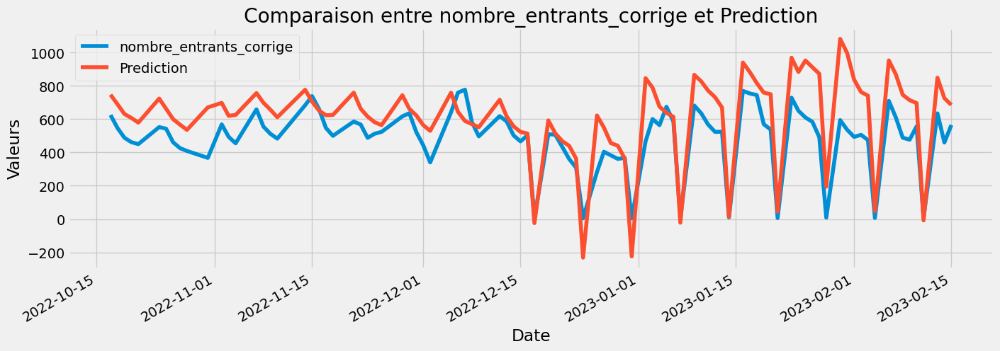

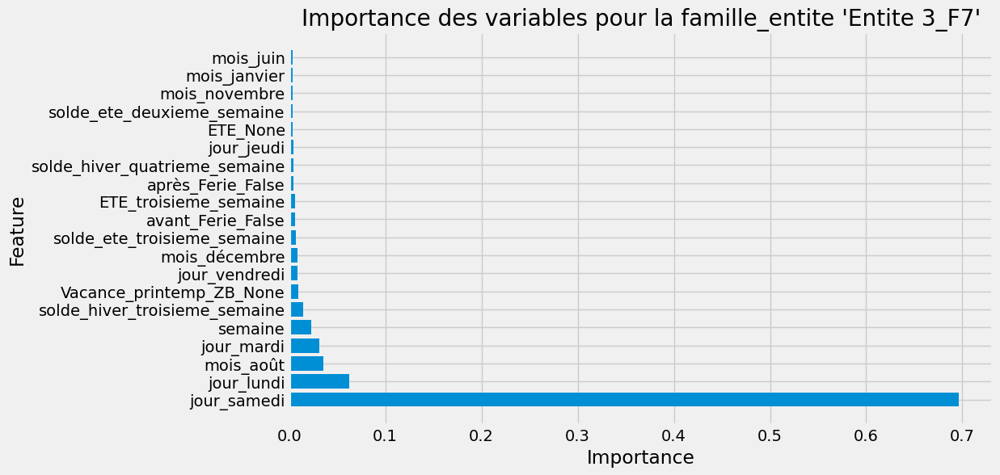

Les noms des features les plus importants pour la famille_entite 'Entite 4_F5':
Meilleurs paramètres :  {'regressor__max_depth': 2, 'regressor__n_estimators': 100}
R2:  -0.46272056440148246
MAE:  6.434193172449216
MAPE:  0.44377960409844625
mape:  44.377960409844626
MSE:  55.89655602409355


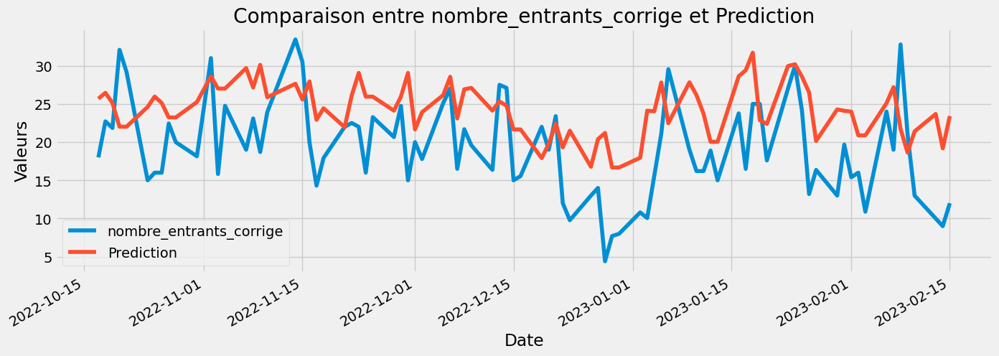

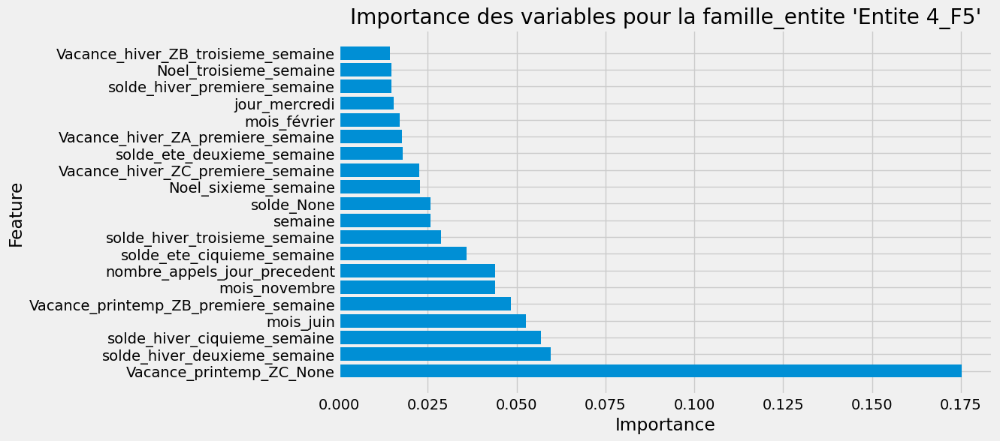

Les noms des features les plus importants pour la famille_entite 'Entite 4_F7':
Meilleurs paramètres :  {'regressor__max_depth': 2, 'regressor__n_estimators': 100}
R2:  -1.7061173495526845
MAE:  46.80377144139362
MAPE:  0.3124058341433783
mape:  31.24058341433783
MSE:  3582.611818574086


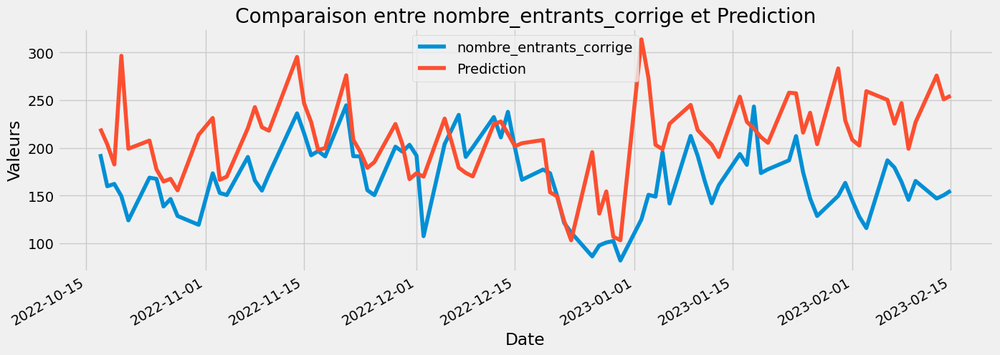

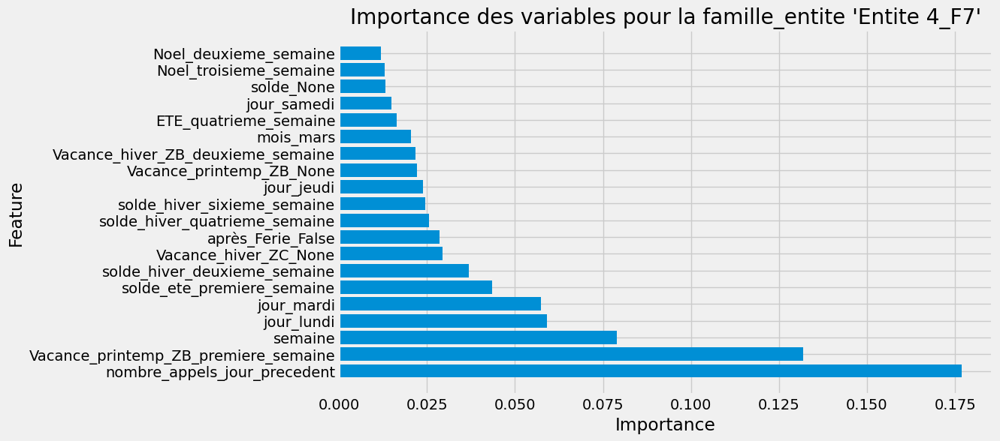

Les noms des features les plus importants pour la famille_entite 'Entite 5_F1':
Meilleurs paramètres :  {'regressor__max_depth': 2, 'regressor__n_estimators': 100}
R2:  -0.03076502347580945
MAE:  18.77027529066201
MAPE:  1.8976546293142051
mape:  189.7654629314205
MSE:  1008.517020147739


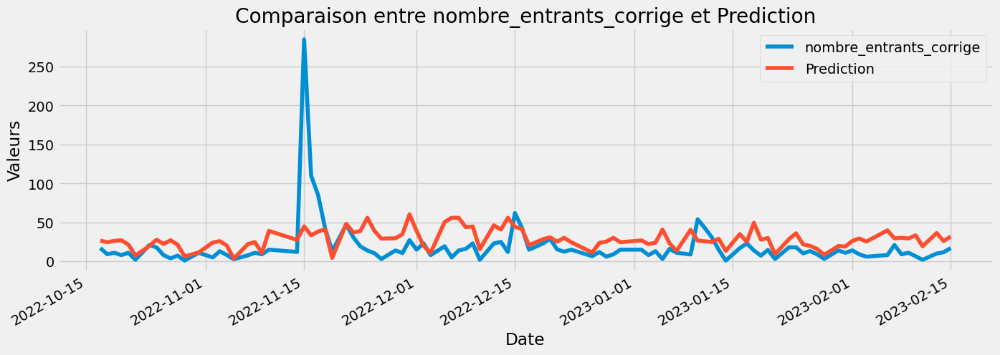

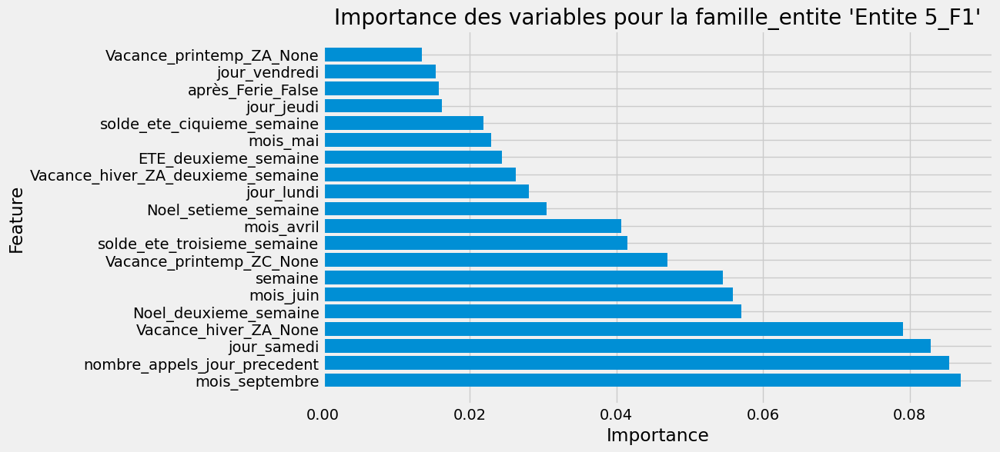

Les noms des features les plus importants pour la famille_entite 'Entite 5_F2':
Meilleurs paramètres :  {'regressor__max_depth': 2, 'regressor__n_estimators': 100}
R2:  0.43567305682488366
MAE:  165.79538781386157
MAPE:  0.3307873731376829
mape:  33.07873731376829
MSE:  40065.711692926765


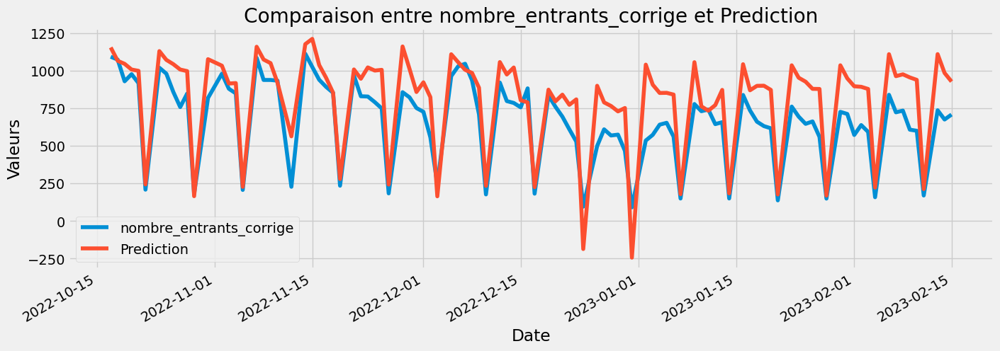

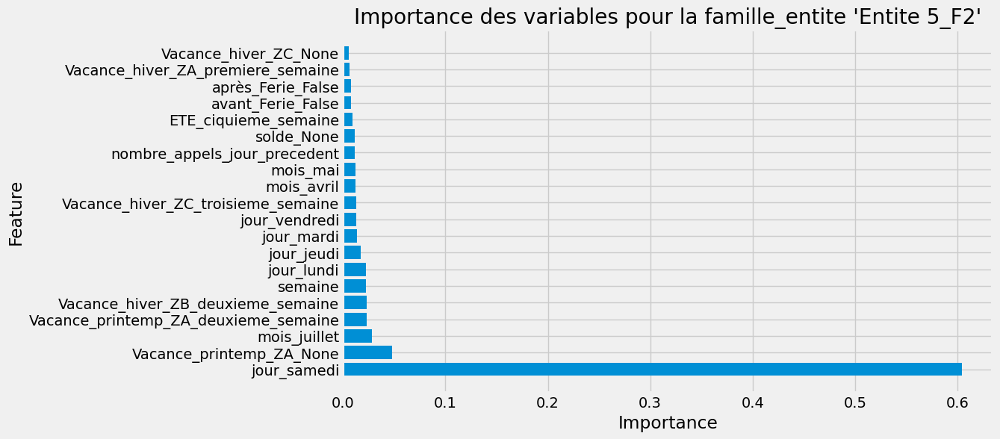

Les noms des features les plus importants pour la famille_entite 'Entite 5_F3':
Meilleurs paramètres :  {'regressor__max_depth': 2, 'regressor__n_estimators': 100}
R2:  -0.39247696102606766
MAE:  212.3721754850277
MAPE:  0.3825785832196326
mape:  38.25785832196326
MSE:  78253.68999166568


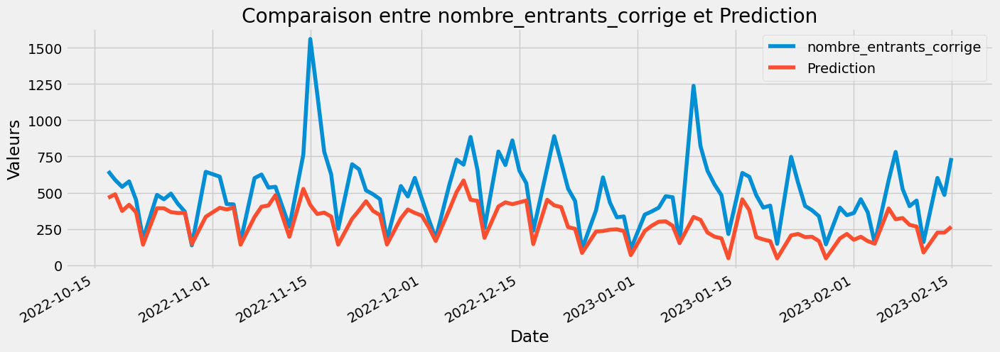

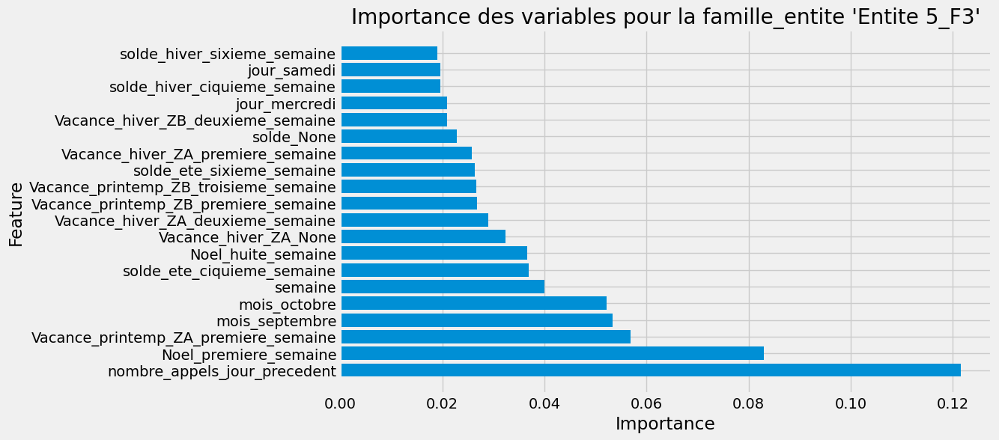

Les noms des features les plus importants pour la famille_entite 'Entite 5_F5':
Meilleurs paramètres :  {'regressor__max_depth': 2, 'regressor__n_estimators': 100}
R2:  0.7725766822606925
MAE:  55.96422102953849
MAPE:  0.19055555123275195
mape:  19.055555123275195
MSE:  4541.228660357942


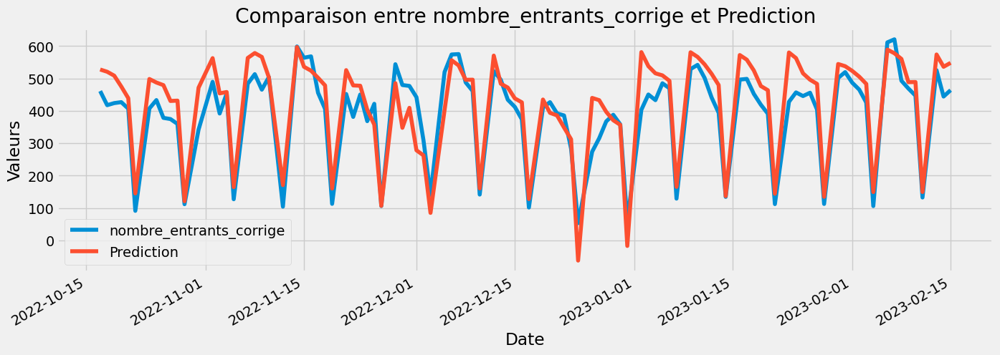

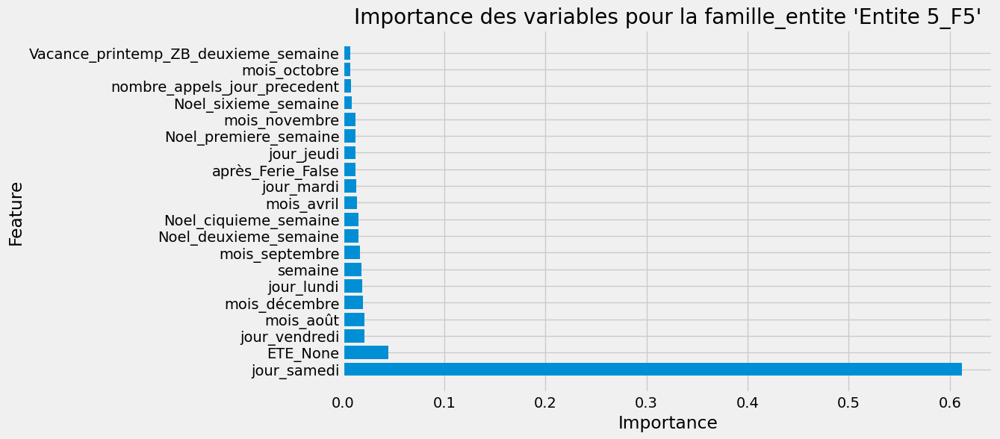

Les noms des features les plus importants pour la famille_entite 'Entite 5_F6':
Meilleurs paramètres :  {'regressor__max_depth': 2, 'regressor__n_estimators': 100}
R2:  -0.6716915194284034
MAE:  203.89187286597692
MAPE:  0.33766792014306807
mape:  33.76679201430681
MSE:  53500.70274415105


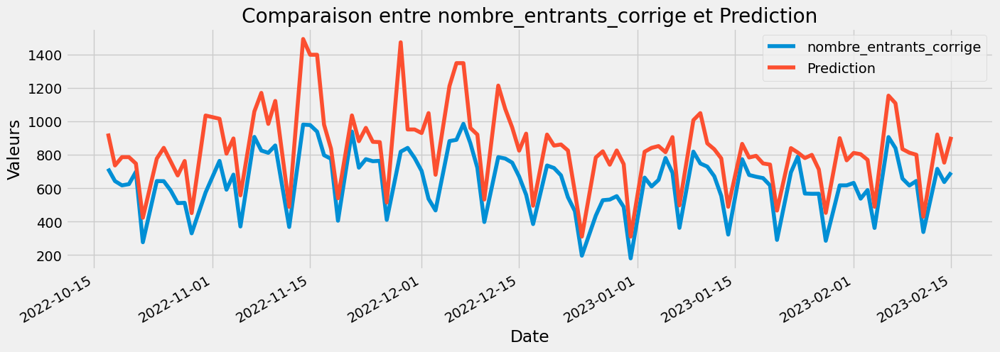

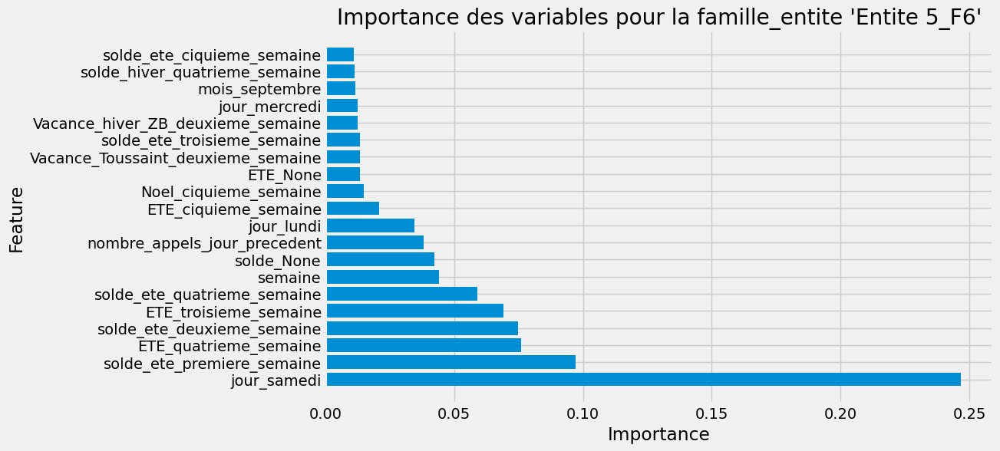

Les noms des features les plus importants pour la famille_entite 'Entite 5_F7':
Meilleurs paramètres :  {'regressor__max_depth': 2, 'regressor__n_estimators': 100}
R2:  0.7757481274919097
MAE:  409.20572877360206
MAPE:  0.16974415534162346
mape:  16.974415534162347
MSE:  271322.5484461398


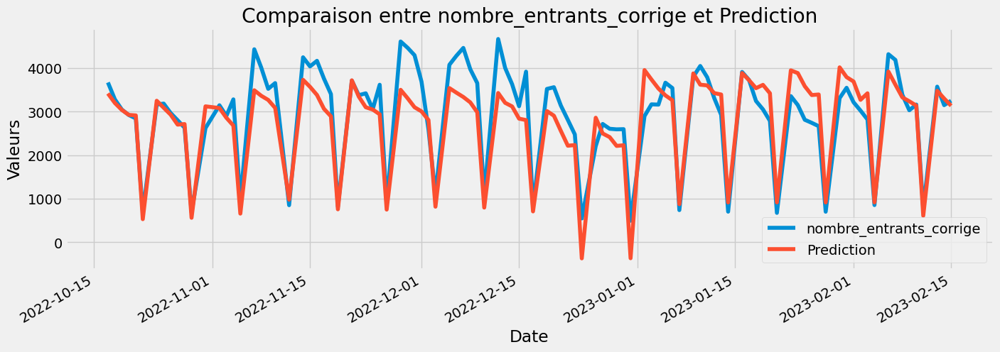

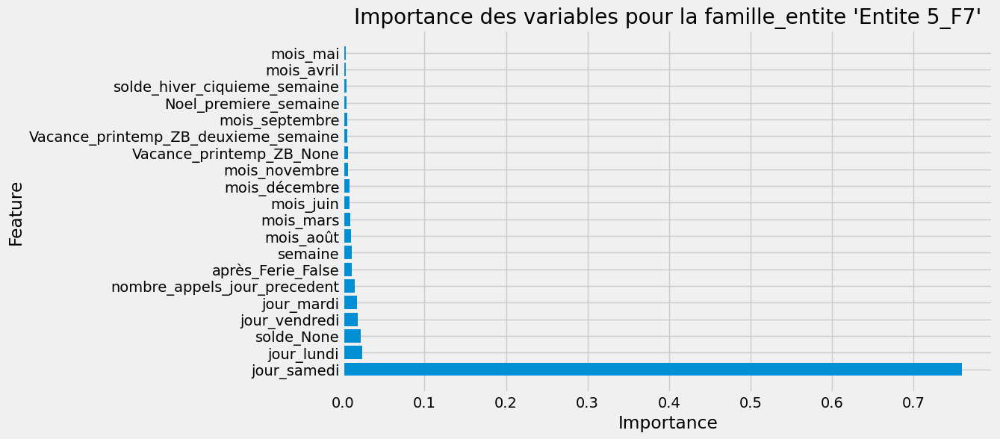

In [ ]:
import datetime
import pandas as pd
import xgboost as xgb
import matplotlib.pyplot as plt
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import OneHotEncoder, OrdinalEncoder

from sklearn.metrics import accuracy_score, r2_score

from sklearn.metrics import mean_squared_error, mean_absolute_error, mean_absolute_percentage_error
from sklearn.model_selection import train_test_split
from sklearn.model_selection import TimeSeriesSplit
from sklearn.preprocessing import StandardScaler


# Convertir la colonne "date" en objets datetime
df_all['date'] = pd.to_datetime(df_all['date'])
# df_all_data[df_all_data['']]
# Définir la date initiale
date_initiale = datetime.datetime(2022, 10, 15)
# Parcourir chaque groupe de famille_entite
for famille_entite, group_df in df_all.groupby('famille_entite'):
    # Séparer les données en ensemble d'entraînement et ensemble de test
    train_df = group_df.loc[group_df['date'] <= date_initiale]
    test_df = group_df.loc[group_df['date'] > date_initiale]

    # tss = TimeSeriesSplit(n_splits = 2)

    group_df.set_index('date', inplace=True)
    group_df.sort_index(inplace=True)
    X = group_df.drop(labels=['nombre_entrants_corrige'], axis=1)
    y = group_df['nombre_entrants_corrige']
    X_train, X_test = X.loc[group_df.index <= date_initiale, :], X.loc[group_df.index > date_initiale,:]
    y_train, y_test = y.loc[group_df.index <= date_initiale], y.loc[group_df.index > date_initiale]
   
    cols_cat = X_train.select_dtypes('object').columns  # Ajoutez d'autres colonnes catégorielles si nécessaire
    cols_num = X_train.select_dtypes(exclude='object').columns 
    # Créer un pipeline pour l'encodage des colonnes catégorielles et l'entraînement du modèle
    pipeline = Pipeline([
    ('encoding', ColumnTransformer([
        ('onehot', OneHotEncoder(), cols_cat),('scaler', StandardScaler(with_mean=False),cols_num)])), 
    ('regressor', xgb.XGBRegressor())
])
    # Définir les paramètres de la recherche de grille
    param_grid = {
        'regressor__n_estimators': [100,200],
        'regressor__max_depth': [2,3],
        # 'regressor__learning_rate': [0.3,0.4,0.5]
    }

    # Créer l'objet GridSearchCV
    grid_search = GridSearchCV(pipeline, param_grid, scoring='r2')

    # Entraîner le modèle avec la recherche de grille
    grid_search.fit(X_train, y_train)

    # Obtenir le meilleur modèle
    best_model = grid_search.best_estimator_

    # Prédire les valeurs pour l'ensemble de test
    y_pred = best_model.predict(X_test)

    test_df = pd.DataFrame({'y_': encoded_feature_names, 'Importance': importance})

    # # Entraîner le modèle
    # pipeline.fit(X_train, y_train)
    
    # Obtenir les noms des features après l'encodage et la normalisation
    encoded_feature_names = []
    encoded_feature_names += list(best_model.named_steps['encoding'].transformers_[0][1].get_feature_names_out(cols_cat))
    encoded_feature_names += list(cols_num)
    # Obtenir l'importance des caractéristiques
    importance = best_model.named_steps['regressor'].feature_importances_
    # Créer un DataFrame avec les noms des features et leur importance
    feature_importance_df = pd.DataFrame({'Feature': encoded_feature_names, 'Importance': importance})
    
    # Trier les features par importance décroissante
    feature_importance_df = feature_importance_df.sort_values('Importance', ascending=False).reset_index(drop=True)
    



    # Prédire les valeurs pour l'ensemble de test
    y_pred = best_model.predict(X_test)
    # Afficher les noms des features les plus importants


    print(f"Les noms des features les plus importants pour la famille_entite '{famille_entite}':")


   # Afficher le meilleur score
    print("Meilleurs paramètres : ", grid_search.best_params_)
    print('R2: ', r2_score(y_pred = y_pred, y_true = y_test ))
    print('MAE: ', mean_absolute_error(y_pred = y_pred, y_true = y_test ))
    print('MAPE: ', mean_absolute_percentage_error(y_pred =  y_pred, y_true = y_test ))
    print('mape: ', mape(y_test, y_pred))

    print('MSE: ', mean_squared_error(y_pred = y_pred, y_true = y_test ))

    # df_test.plot(figsize=(15, 5))
    df_test=pd.DataFrame({'nombre_entrants_corrige': y_test, 'Prediction': best_model.predict(X_test)},index=X_test.index)


    df_test.plot( figsize=(15, 5))
    plt.xlabel('Date')
    plt.ylabel('Valeurs')
    plt.title('Comparaison entre nombre_entrants_corrige et Prediction')
    plt.show()
    # Tracer le barplot des features les plus importants
    plt.figure(figsize=(10, 6))
    plt.barh(feature_importance_df['Feature'][:20], feature_importance_df['Importance'][:20])
    plt.xlabel('Importance')
    plt.ylabel('Feature')
    plt.title(f"Importance des variables pour la famille_entite '{famille_entite}'")
    plt.show()


In [ ]:
import warnings
warnings.filterwarnings("ignore")

### model xgboost avec gridshearch avec covid

In [ ]:
import datetime
import pandas as pd
import xgboost as xgb
import matplotlib.pyplot as plt
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import OneHotEncoder, OrdinalEncoder
from sklearn.model_selection import TimeSeriesSplit, GridSearchCV
from sklearn.metrics import accuracy_score, r2_score

from sklearn.metrics import mean_squared_error, mean_absolute_error, mean_absolute_percentage_error



# Convertir la colonne "date" en objets datetime
df_all['date'] = pd.to_datetime(df_all['date'])
# Définir la date initiale
date_initiale = datetime.datetime(2022, 4, 29)

# Parcourir chaque groupe de famille_entite
for famille_entite, group_df in df_all.groupby('famille_entite'):
    # Séparer les données en ensemble d'entraînement et ensemble de test
    train_df = group_df.loc[group_df['date'] <= date_initiale]
    test_df = group_df.loc[group_df['date'] > date_initiale]
    
    # Séparer les caractéristiques et la variable cible
    X_train = train_df.drop(['date','nombre_entrants_corrige','famille_entite','annee'], axis=1)
    X_test = test_df.drop(['date','nombre_entrants_corrige','famille_entite','annee'], axis=1)
    y_train = train_df['nombre_entrants_corrige']
    y_test = test_df['nombre_entrants_corrige']

    # Définir les colonnes catégorielles
    cols = X_train.columns  # Ajoutez d'autres colonnes catégorielles si nécessaire

    # Créer un pipeline pour l'encodage des colonnes catégorielles et l'entraînement du modèle
    pipeline = Pipeline([
        ('encoding', ColumnTransformer([
            ('onehot', OrdinalEncoder(), cols)
        ], remainder='passthrough')),
        ('regressor', xgb.XGBRegressor())
    ])

    # Définir les paramètres de la recherche de grille
    param_grid = {
        'regressor__n_estimators': [100],
        'regressor__max_depth': [2],
        # 'regressor__learning_rate': [0.3,0.4,0.5]
    }

    # Créer l'objet TimeSeriesSplit
    tscv = TimeSeriesSplit(n_splits=5)

    # Créer l'objet GridSearchCV
    grid_search = GridSearchCV(pipeline, param_grid, cv=tscv, scoring='r2')

    # Entraîner le modèle avec la recherche de grille
    grid_search.fit(X_train, y_train)

    # Obtenir le meilleur modèle
    best_model = grid_search.best_estimator_

    # Prédire les valeurs pour l'ensemble de test
    y_pred = best_model.predict(X_test)

    # Tracer les prédictions et les valeurs réelles
    test_df['Prediction'] = y_pred
    test_df[['Prediction', 'nombre_entrants_corrige']].plot(figsize=(15, 5))
    plt.show()

    # Obtenir l'importance des caractéristiques
    importance = best_model.named_steps['regressor'].feature_importances_

    # Obtenir les noms des features après l'encodage
    encoded_feature_names = best_model.named_steps['encoding'].transformers_[0][1].get_feature_names_out(cols)

    # Créer un DataFrame avec les noms des features et leur importance
    feature_importance_df = pd.DataFrame({'Feature': encoded_feature_names, 'Importance': importance})

    # Trier les features par importance décroissante
    feature_importance_df = feature_importance_df.sort_values('Importance', ascending=True).reset_index(drop=True)

    # Afficher les noms des features les plus importants
    print(f"Les noms des features les plus importants pour la famille_entite '{famille_entite}':")
   # Afficher le meilleur score
    print('R2: ', r2_score(y_pred = y_pred, y_true = y_test ))
    print('MAE: ', mean_absolute_error(y_pred = y_pred, y_true = y_test ))
    print('MAPE: ', mean_absolute_percentage_error(y_pred =  y_pred, y_true = y_test ))
    print('MSE: ', mean_squared_error(y_pred = y_pred, y_true = y_test ))
    

    # Afficher les meilleurs paramètres
    print("Meilleurs paramètres : ", grid_search.best_params_)

    # Tracer le barplot des features les plus importants
    plt.figure(figsize=(10, 6))
    plt.barh(feature_importance_df['Feature'], feature_importance_df['Importance'])
    plt.xlabel('Importance')
    plt.ylabel('Feature')
    plt.title(f"Importance des variables pour la famille_entite '{famille_entite}'")
    plt.show()


KeyError: "['annee'] not found in axis"

### Xgboost sans preriod confinemant 

In [ ]:
# import pandas as pd

# # Supprimer les lignes correspondant à la plage de dates spécifique
# df_all_data = df_all_data[~df_all_data['date'].between('2020-03-17', '2020-05-11')]
# df_all_data = df_all_data[~df_all_data['date'].between('2020-10-30', '2020-12-15')]
# df_all_data = df_all_data[~df_all_data['date'].between('2021-04-03', '2021-05-03')]
# df_all_data

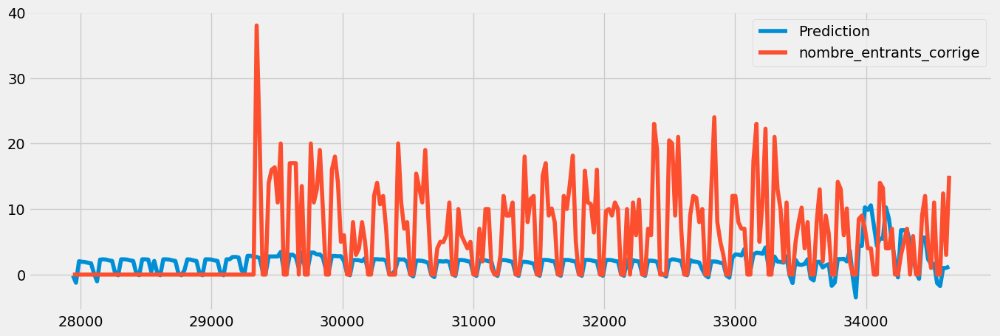

Les noms des features les plus importants pour la famille_entite 'Entite 1_F1':
R2:  -0.21969597205054958
MAE:  5.04735168595221
MAPE:  2342817594461927.5
MSE:  54.57640730859546
Meilleurs paramètres :  {'regressor__max_depth': 2, 'regressor__n_estimators': 100}


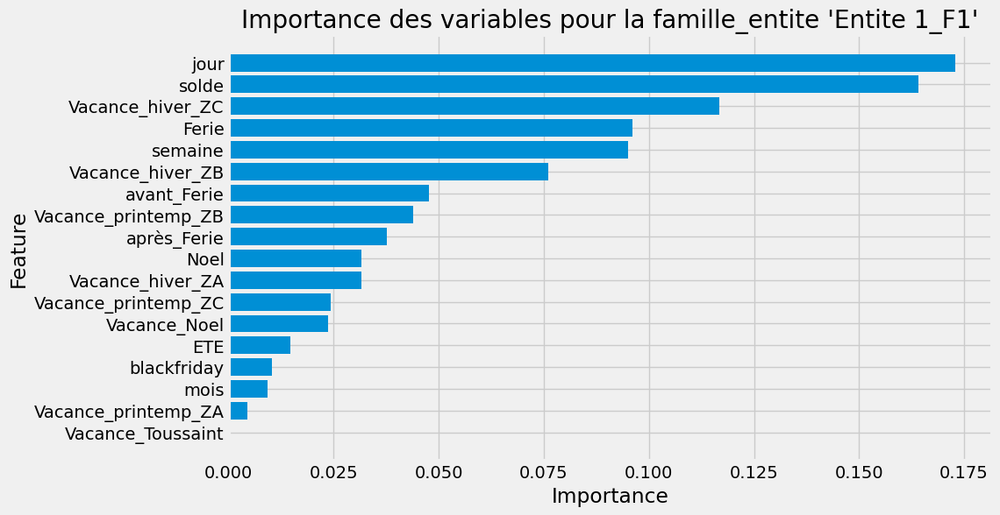

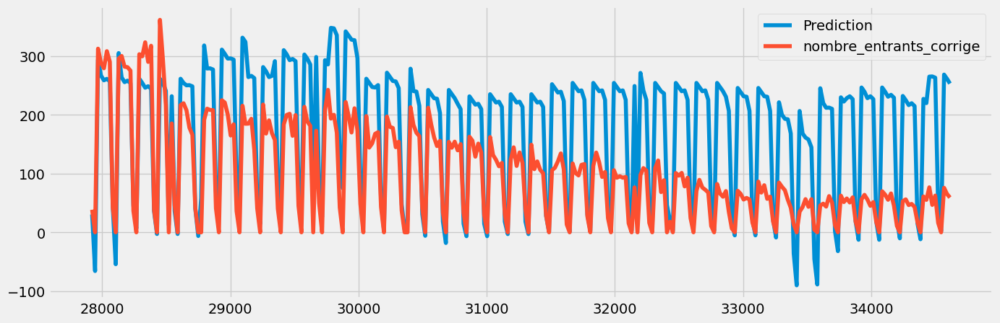

Les noms des features les plus importants pour la famille_entite 'Entite 1_F2':
R2:  -0.6114254475492
MAE:  87.36221064832203
MAPE:  1.5246255563440576e+16
MSE:  11433.64383046494
Meilleurs paramètres :  {'regressor__max_depth': 2, 'regressor__n_estimators': 100}


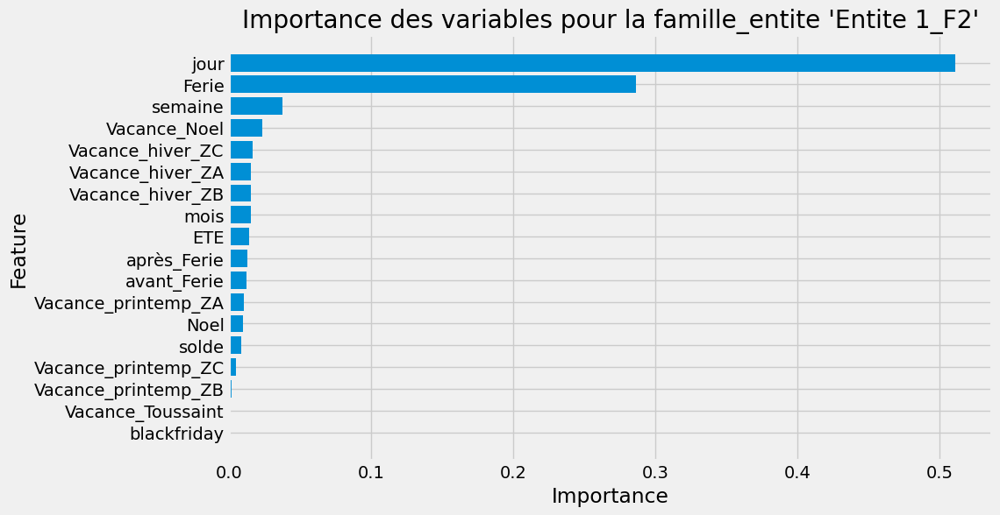

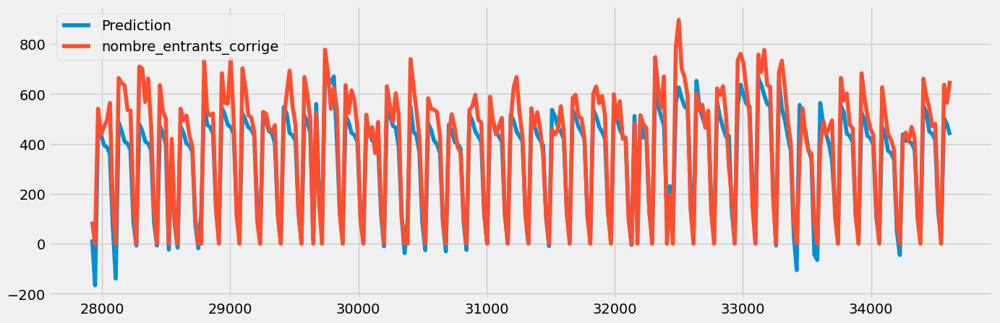

Les noms des features les plus importants pour la famille_entite 'Entite 1_F3':
R2:  0.8569971207571387
MAE:  69.86505329317241
MAPE:  2.801898900260342e+16
MSE:  8395.24609124603
Meilleurs paramètres :  {'regressor__max_depth': 2, 'regressor__n_estimators': 100}


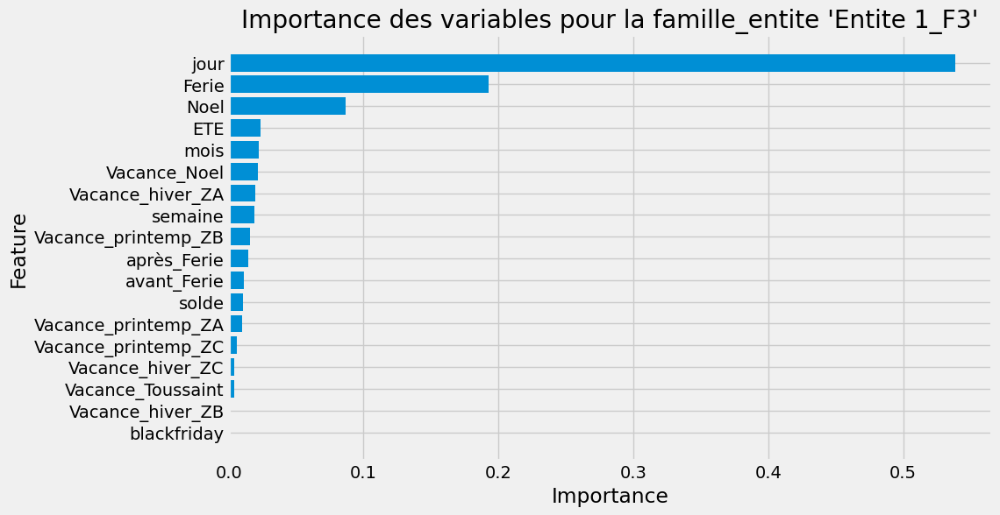

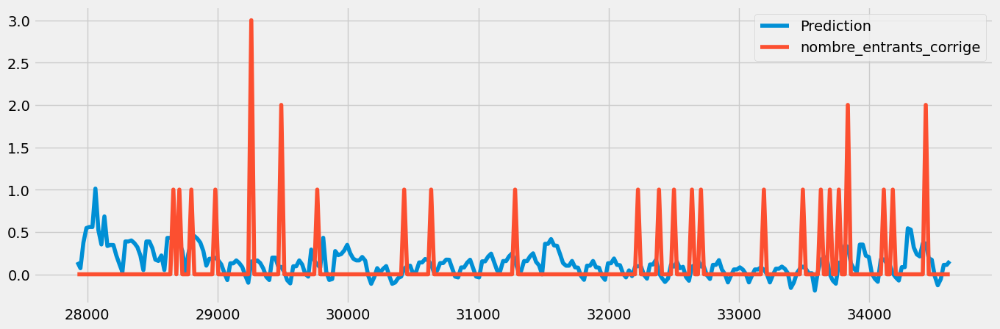

Les noms des features les plus importants pour la famille_entite 'Entite 1_F4':
R2:  -0.14094821780424716
MAE:  0.22607231910670597
MAPE:  629335629383203.1
MSE:  0.148947910165827
Meilleurs paramètres :  {'regressor__max_depth': 2, 'regressor__n_estimators': 100}


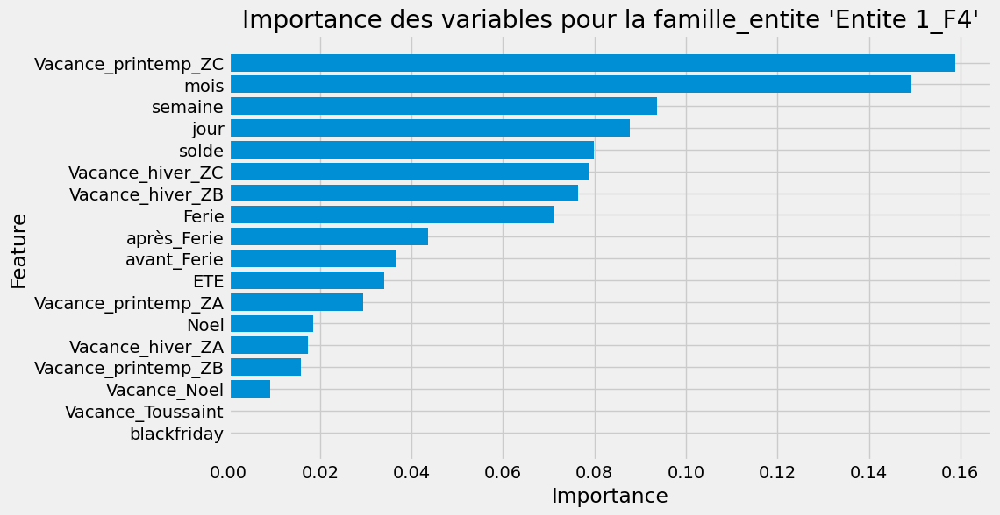

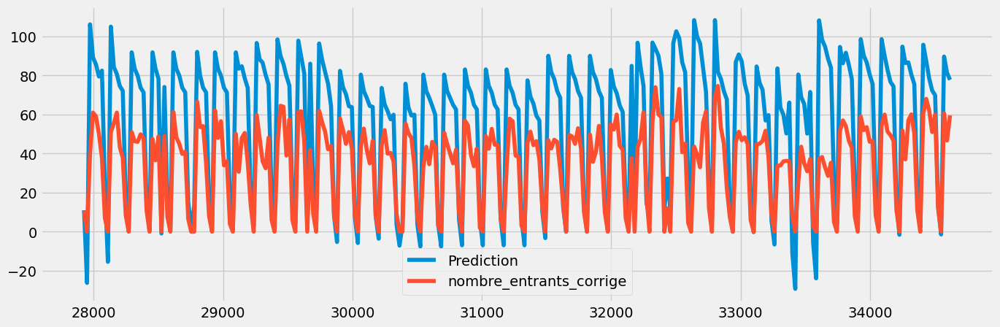

Les noms des features les plus importants pour la famille_entite 'Entite 1_F5':
R2:  -0.7115165600128506
MAE:  23.81791379489567
MAPE:  4575037538018514.0
MSE:  810.6004074649915
Meilleurs paramètres :  {'regressor__max_depth': 2, 'regressor__n_estimators': 100}


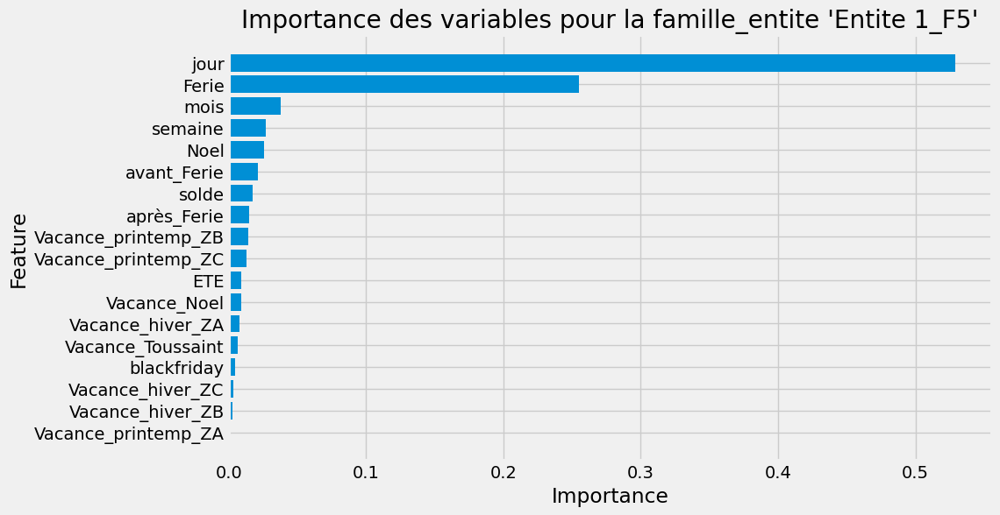

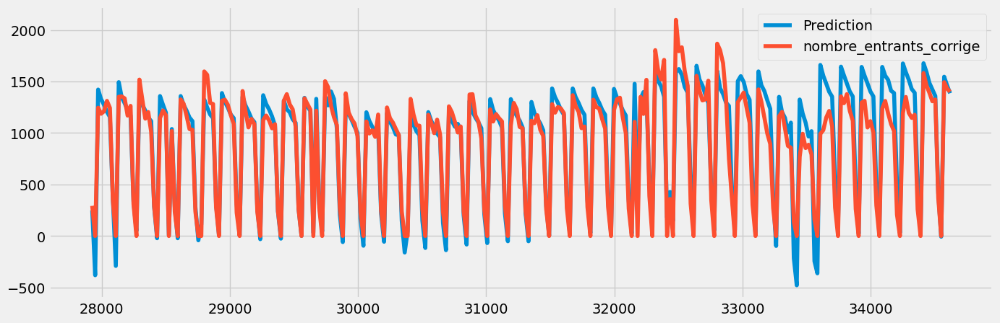

Les noms des features les plus importants pour la famille_entite 'Entite 1_F6':
R2:  0.9008783350694042
MAE:  123.5676151002637
MAPE:  6.505725418214487e+16
MSE:  28872.46361929339
Meilleurs paramètres :  {'regressor__max_depth': 2, 'regressor__n_estimators': 100}


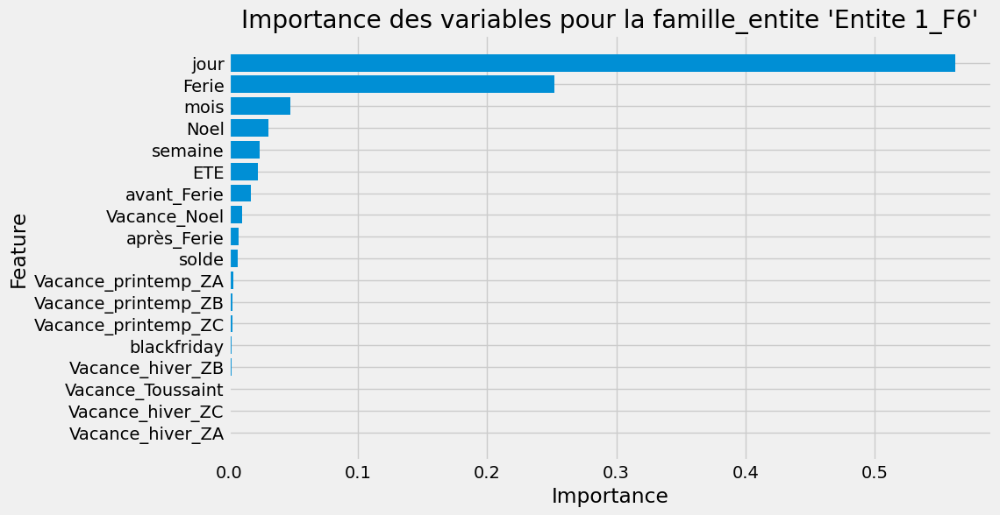

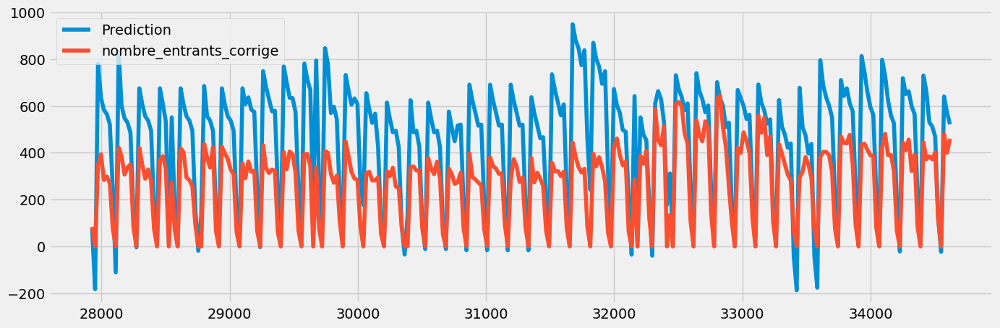

Les noms des features les plus importants pour la famille_entite 'Entite 1_F7':
R2:  -0.7170357434940062
MAE:  187.76747382279095
MAPE:  4.1409750208197336e+16
MSE:  48942.62206651838
Meilleurs paramètres :  {'regressor__max_depth': 2, 'regressor__n_estimators': 100}


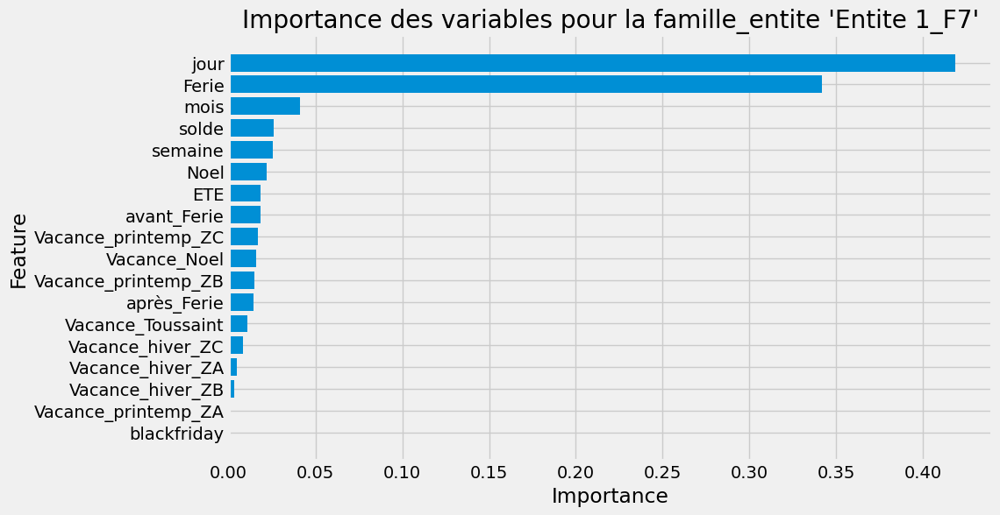

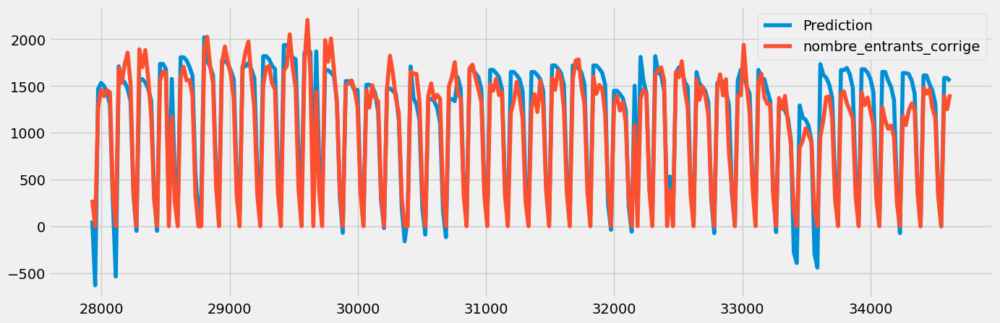

Les noms des features les plus importants pour la famille_entite 'Entite 2_F1':
R2:  0.8865755101658139
MAE:  169.53223838568624
MAPE:  1.0427151484763128e+17
MSE:  46615.95916660463
Meilleurs paramètres :  {'regressor__max_depth': 2, 'regressor__n_estimators': 100}


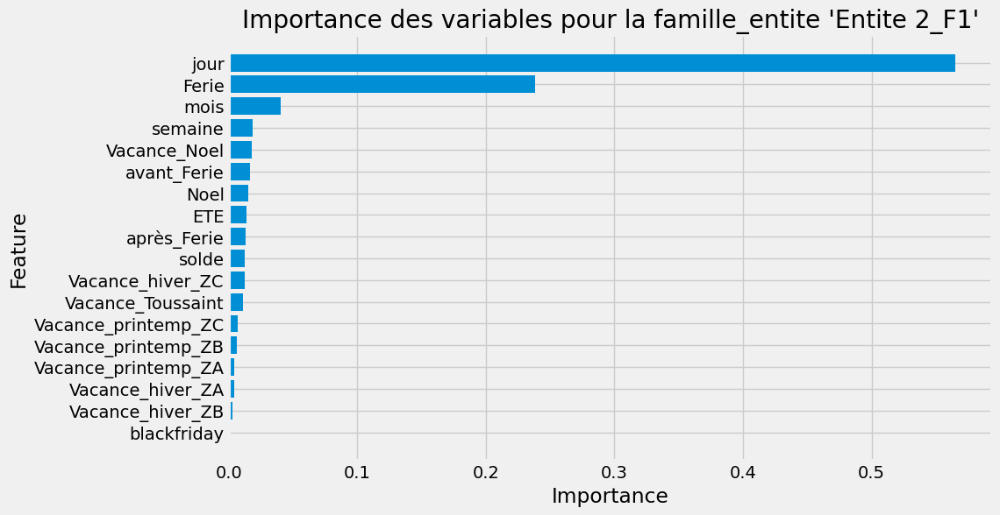

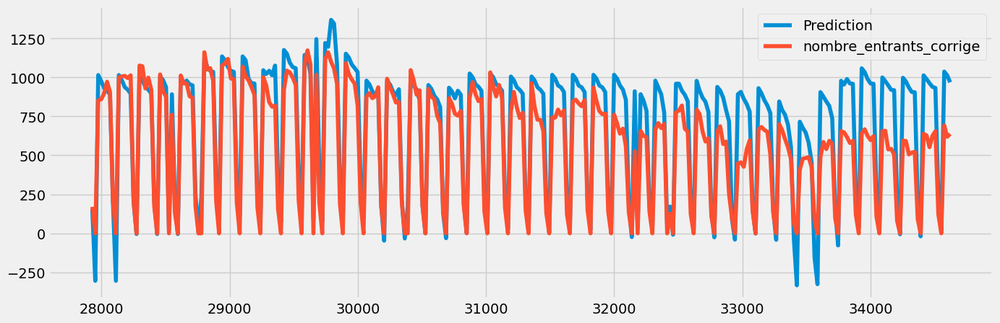

Les noms des features les plus importants pour la famille_entite 'Entite 2_F2':
R2:  0.7577906559062989
MAE:  137.71743611822527
MAPE:  5.094072169454651e+16
MSE:  33345.19718601506
Meilleurs paramètres :  {'regressor__max_depth': 2, 'regressor__n_estimators': 100}


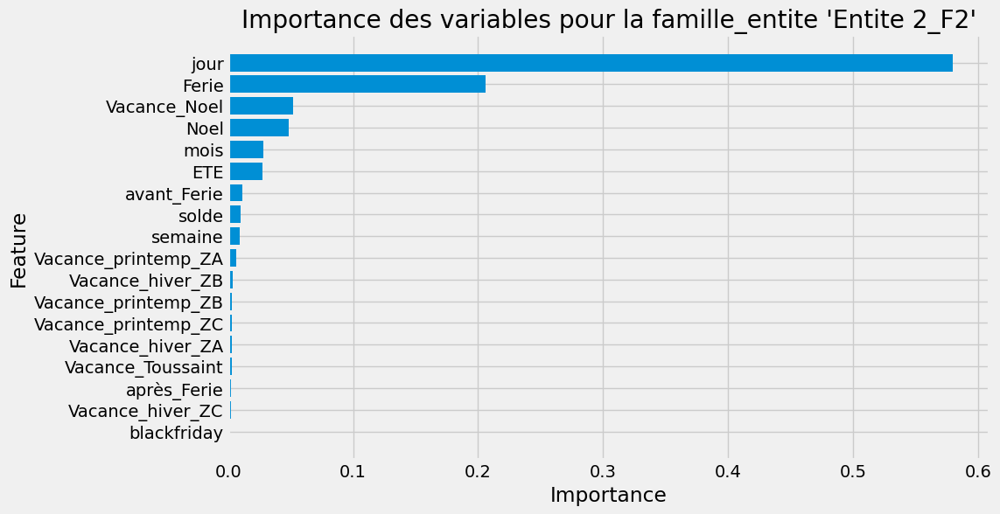

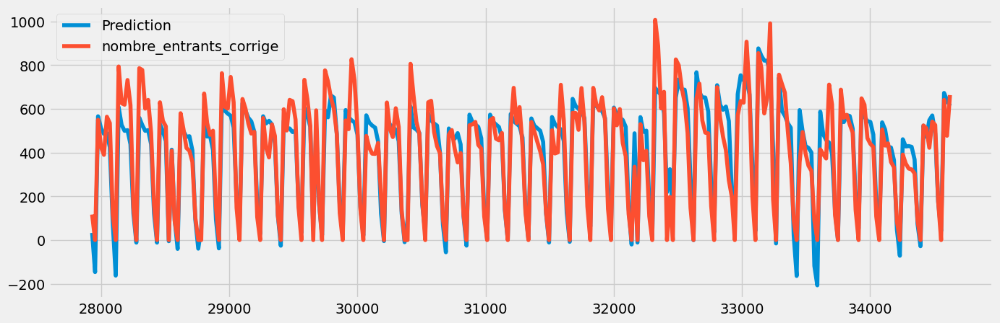

Les noms des features les plus importants pour la famille_entite 'Entite 2_F3':
R2:  0.8560365683807225
MAE:  72.20960831898616
MAPE:  3.525243945310842e+16
MSE:  9269.648404044972
Meilleurs paramètres :  {'regressor__max_depth': 2, 'regressor__n_estimators': 100}


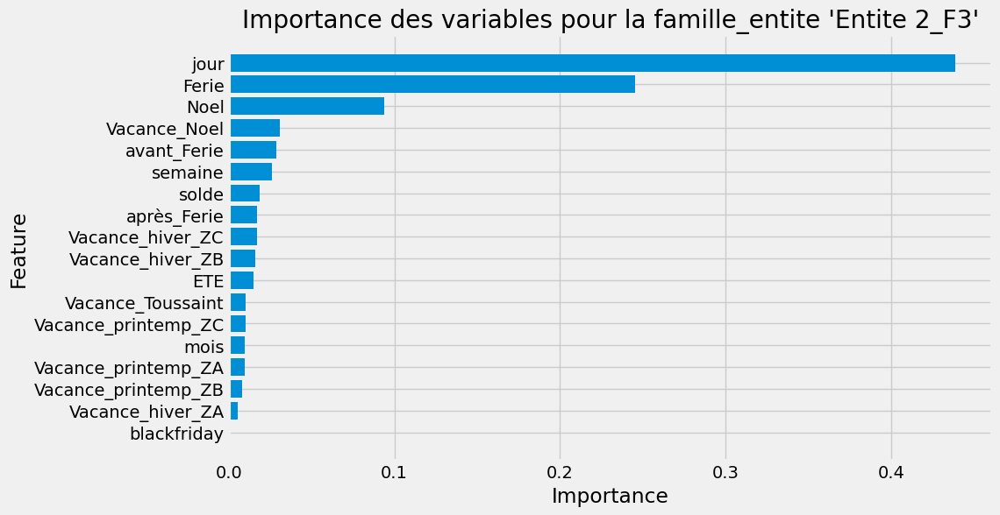

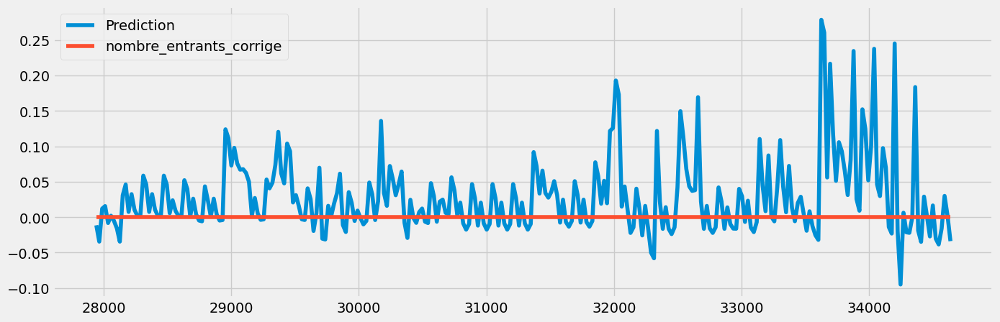

Les noms des features les plus importants pour la famille_entite 'Entite 2_F5':
R2:  0.0
MAE:  0.03898626781331474
MAPE:  175578541196610.62
MSE:  0.0036478333299003025
Meilleurs paramètres :  {'regressor__max_depth': 2, 'regressor__n_estimators': 100}


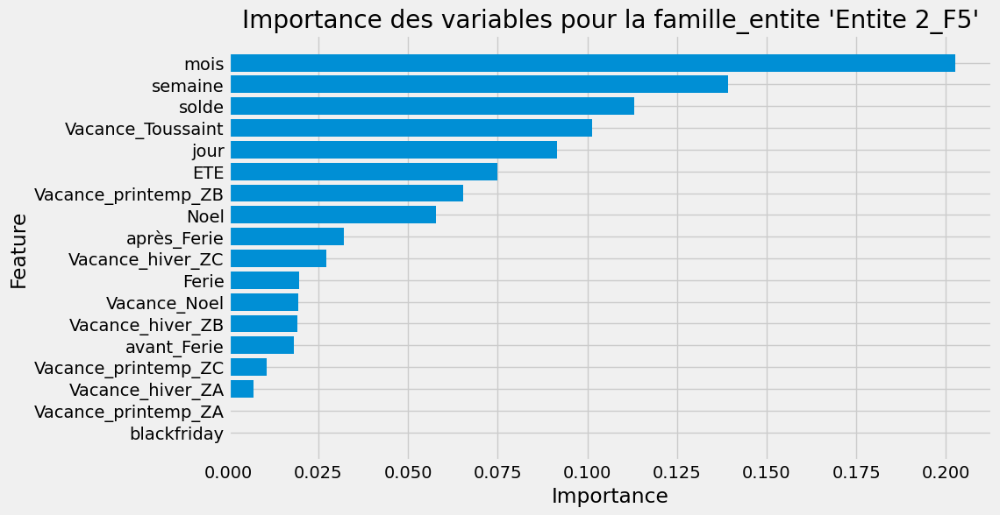

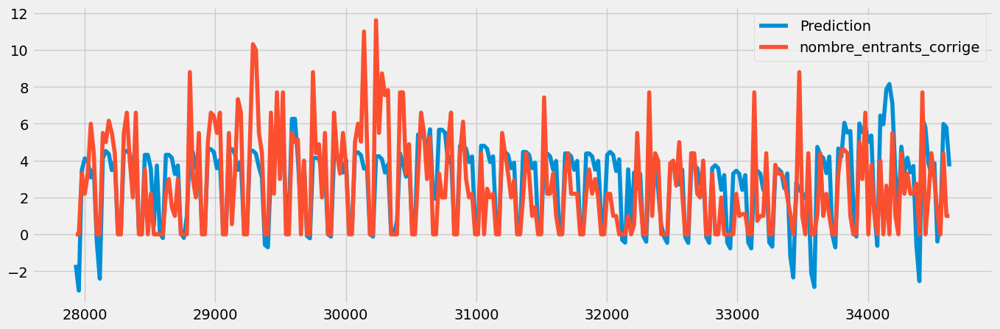

Les noms des features les plus importants pour la famille_entite 'Entite 3_F2':
R2:  0.316809682615515
MAE:  1.5748951741204902
MAPE:  1676018616254240.0
MSE:  4.617830606497713
Meilleurs paramètres :  {'regressor__max_depth': 2, 'regressor__n_estimators': 100}


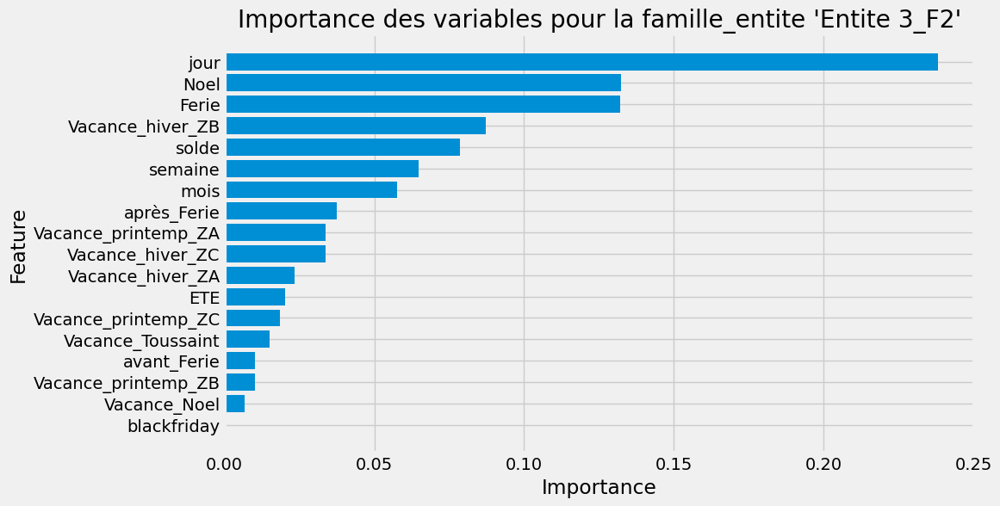

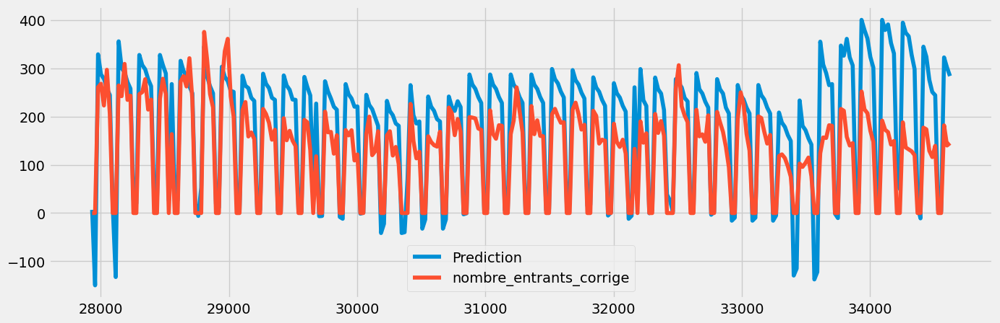

Les noms des features les plus importants pour la famille_entite 'Entite 3_F5':
R2:  0.26425477811366926
MAE:  63.74118565762499
MAPE:  3.4172453009120044e+16
MSE:  6664.138592323083
Meilleurs paramètres :  {'regressor__max_depth': 2, 'regressor__n_estimators': 100}


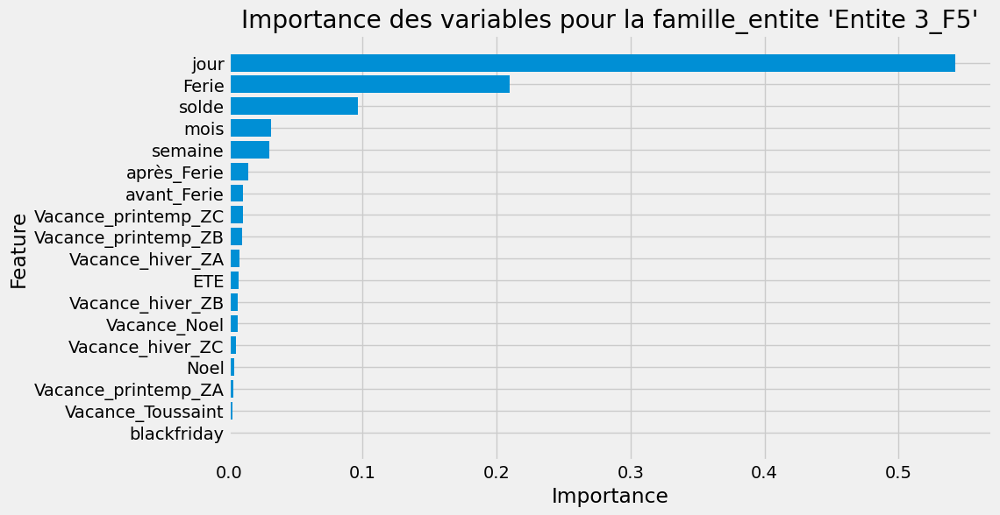

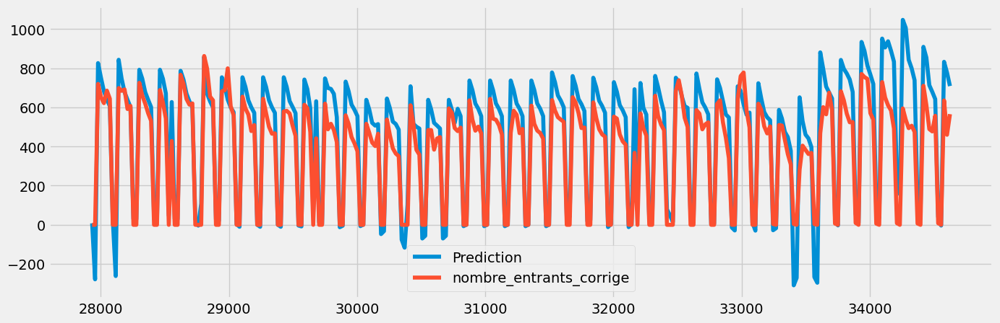

Les noms des features les plus importants pour la famille_entite 'Entite 3_F7':
R2:  0.7586964368867697
MAE:  99.84361635633702
MAPE:  5.007140244357299e+16
MSE:  17199.719224184315
Meilleurs paramètres :  {'regressor__max_depth': 2, 'regressor__n_estimators': 100}


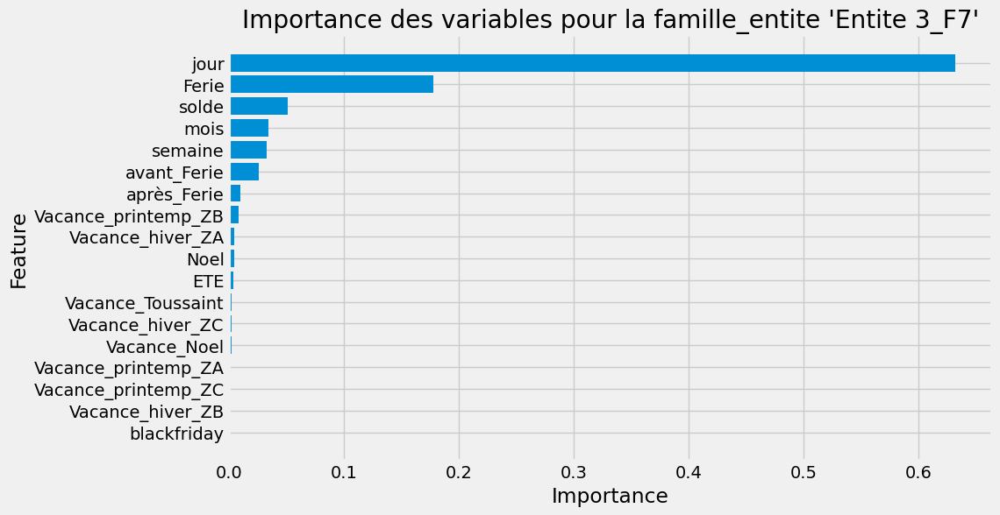

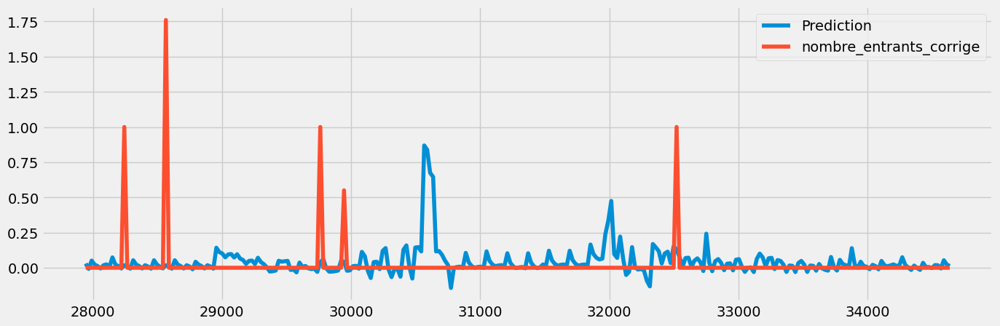

Les noms des features les plus importants pour la famille_entite 'Entite 4_F1':
R2:  -0.5255818989519254
MAE:  0.07014517987469507
MAPE:  237844591747408.66
MSE:  0.032933436620047954
Meilleurs paramètres :  {'regressor__max_depth': 2, 'regressor__n_estimators': 100}


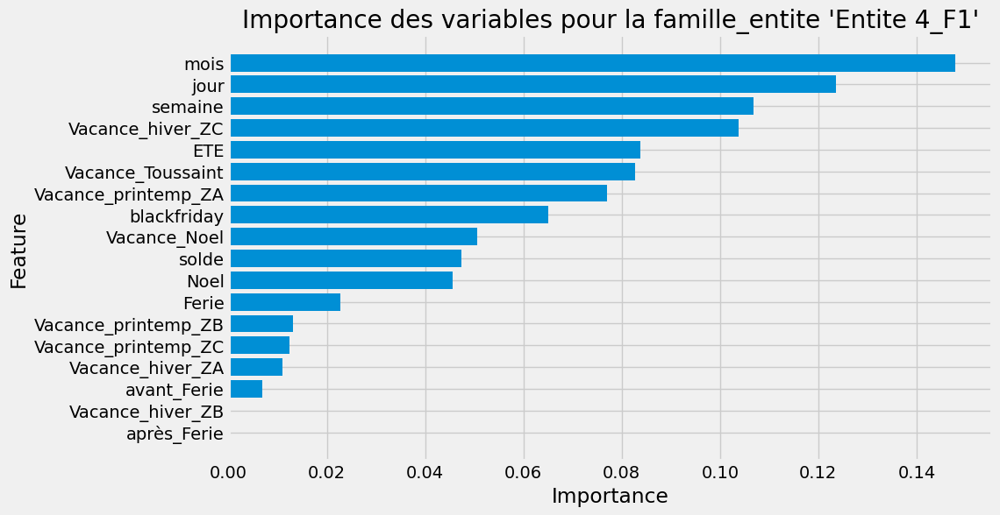

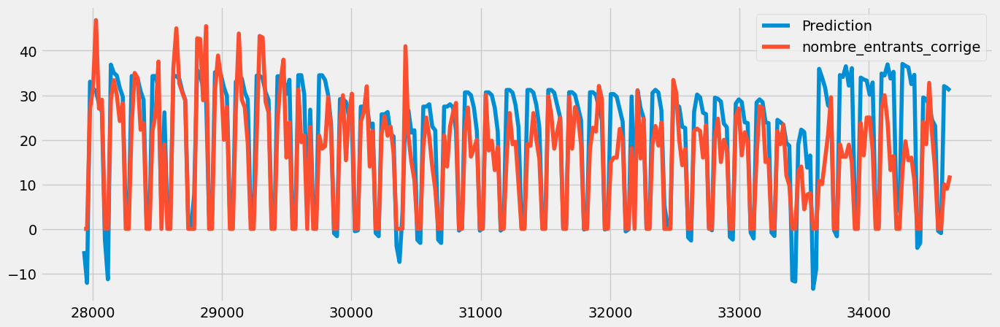

Les noms des features les plus importants pour la famille_entite 'Entite 4_F5':
R2:  0.5331916233330813
MAE:  6.323789812684022
MAPE:  3556099984978425.0
MSE:  72.06032797290446
Meilleurs paramètres :  {'regressor__max_depth': 2, 'regressor__n_estimators': 100}


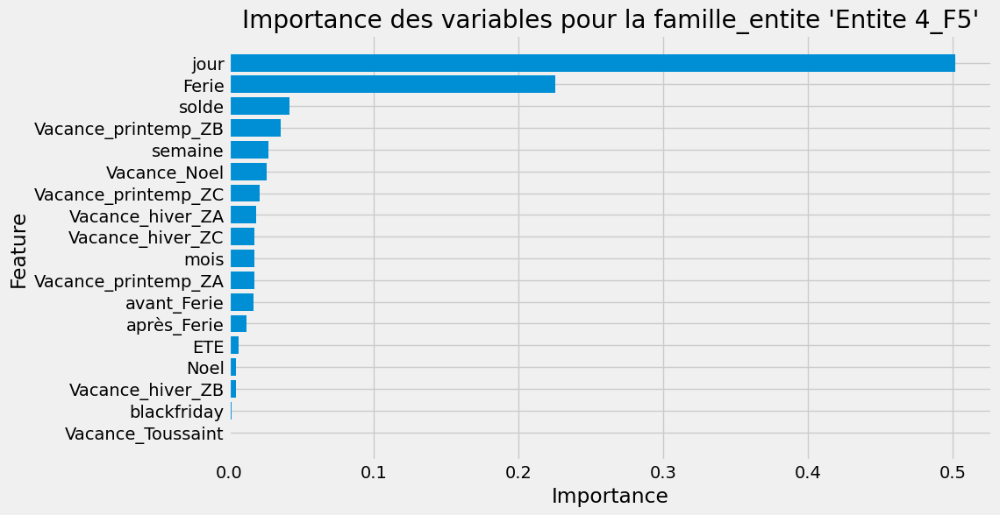

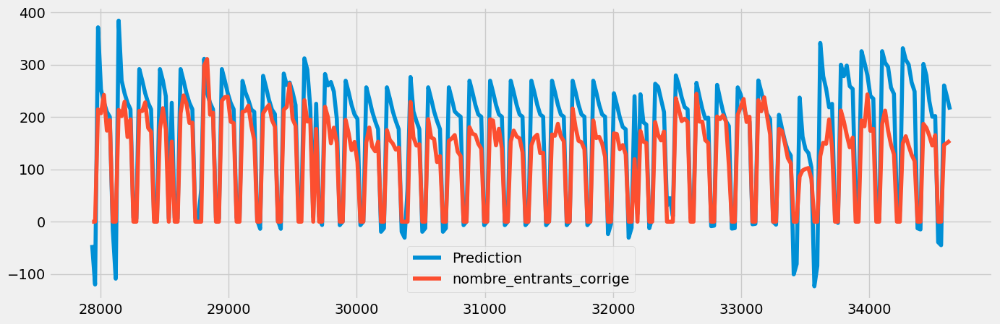

Les noms des features les plus importants pour la famille_entite 'Entite 4_F7':
R2:  0.47771664184443197
MAE:  48.50341801793636
MAPE:  2.643490335702277e+16
MSE:  3922.792925819728
Meilleurs paramètres :  {'regressor__max_depth': 2, 'regressor__n_estimators': 100}


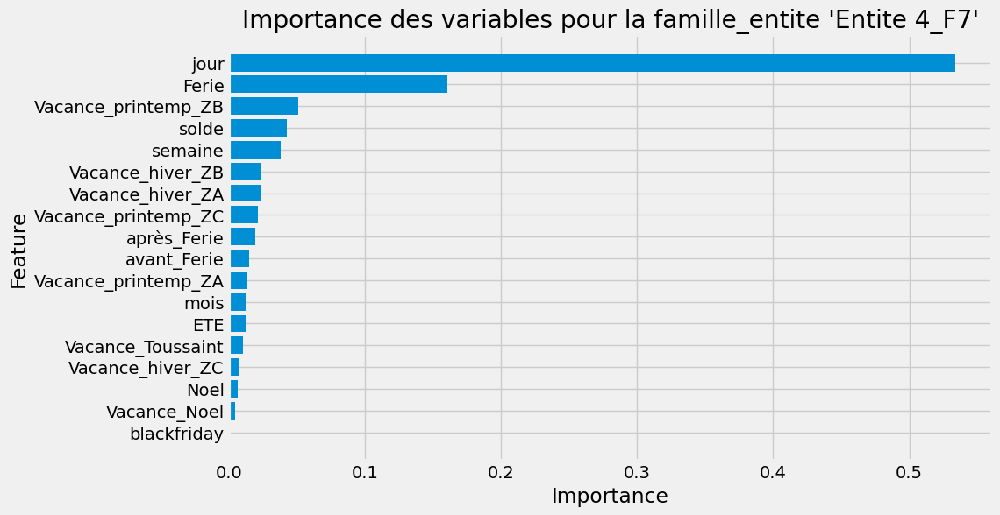

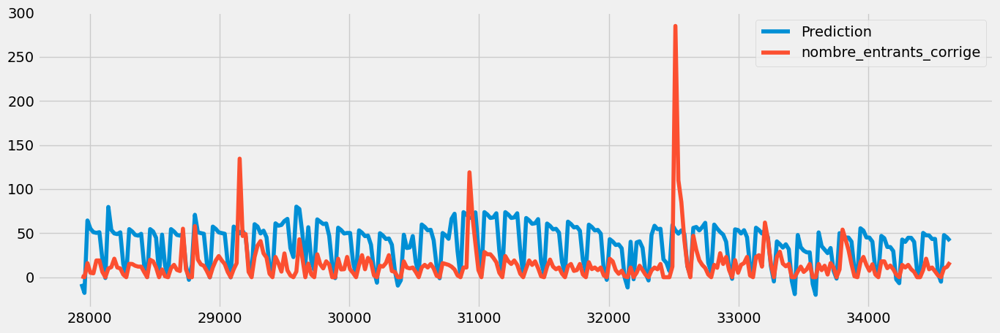

Les noms des features les plus importants pour la famille_entite 'Entite 5_F1':
R2:  -1.2901790285612367
MAE:  27.452632148386492
MAPE:  4894248489932718.0
MSE:  1197.5083206383943
Meilleurs paramètres :  {'regressor__max_depth': 2, 'regressor__n_estimators': 100}


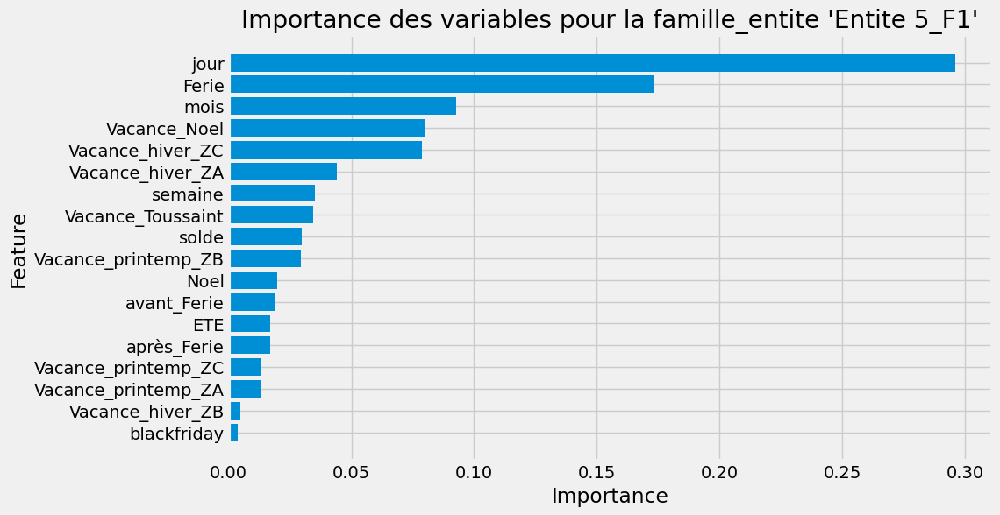

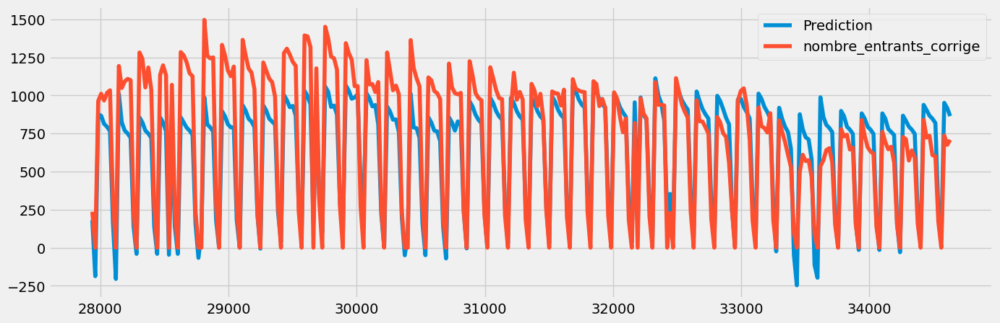

Les noms des features les plus importants pour la famille_entite 'Entite 5_F2':
R2:  0.8043269714479185
MAE:  156.44819117248105
MAPE:  5.152426863960311e+16
MSE:  39678.949748046165
Meilleurs paramètres :  {'regressor__max_depth': 2, 'regressor__n_estimators': 100}


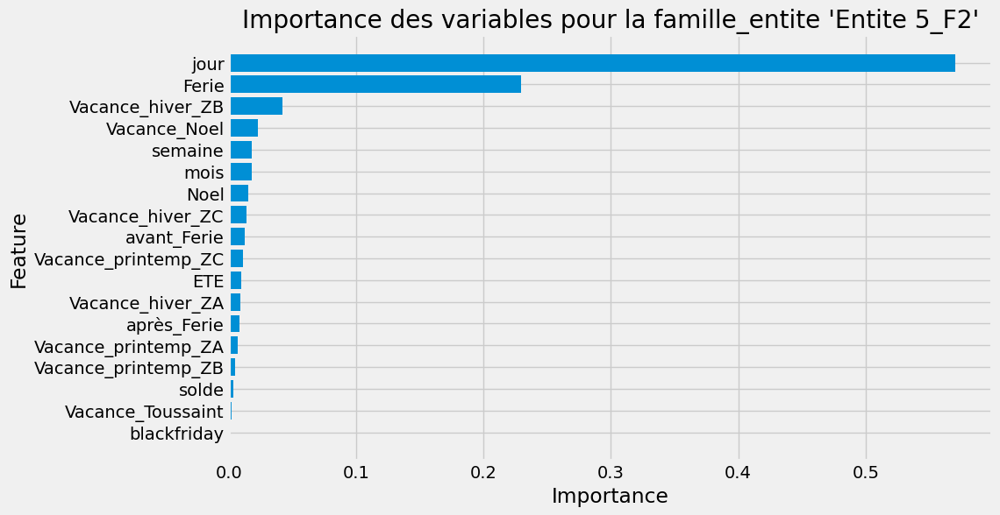

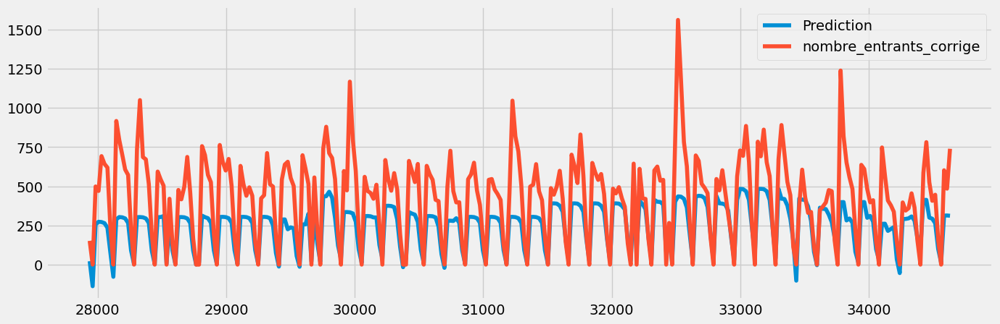

Les noms des features les plus importants pour la famille_entite 'Entite 5_F3':
R2:  0.19399441397168793
MAE:  184.35994541385227
MAPE:  2.1117320204957276e+16
MSE:  60347.1361018567
Meilleurs paramètres :  {'regressor__max_depth': 2, 'regressor__n_estimators': 100}


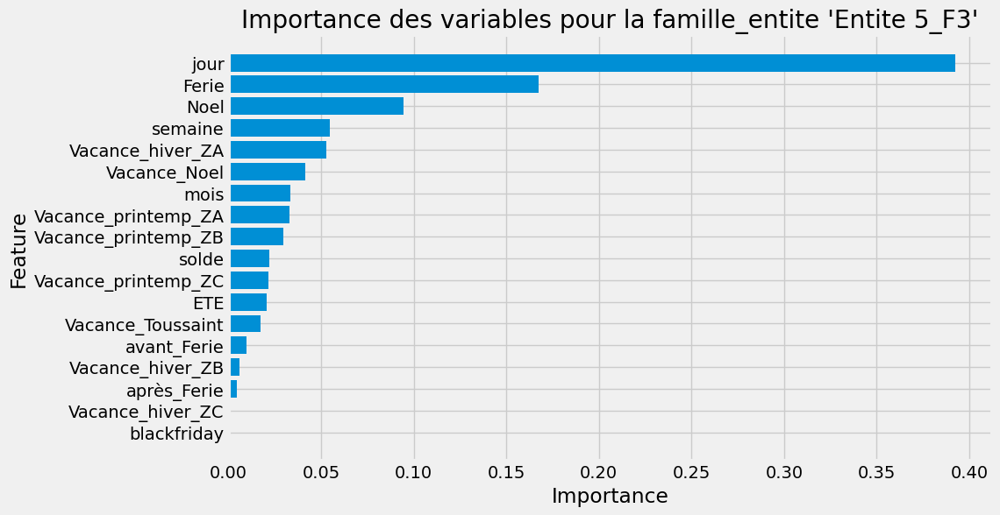

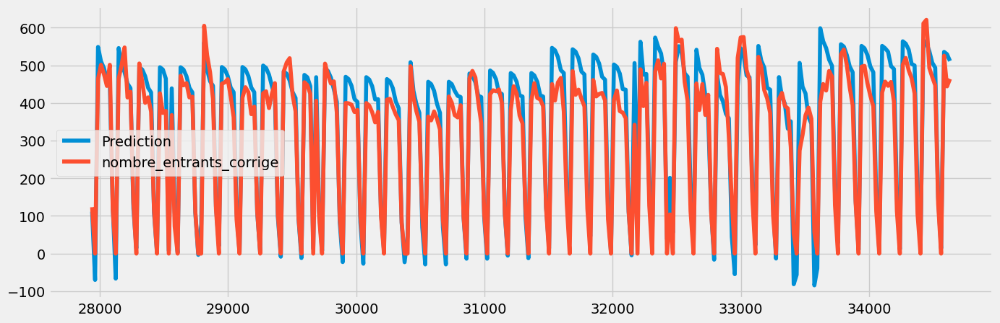

Les noms des features les plus importants pour la famille_entite 'Entite 5_F5':
R2:  0.9096766742799646
MAE:  44.169800773042496
MAPE:  1.857720670691934e+16
MSE:  3145.0973854031404
Meilleurs paramètres :  {'regressor__max_depth': 2, 'regressor__n_estimators': 100}


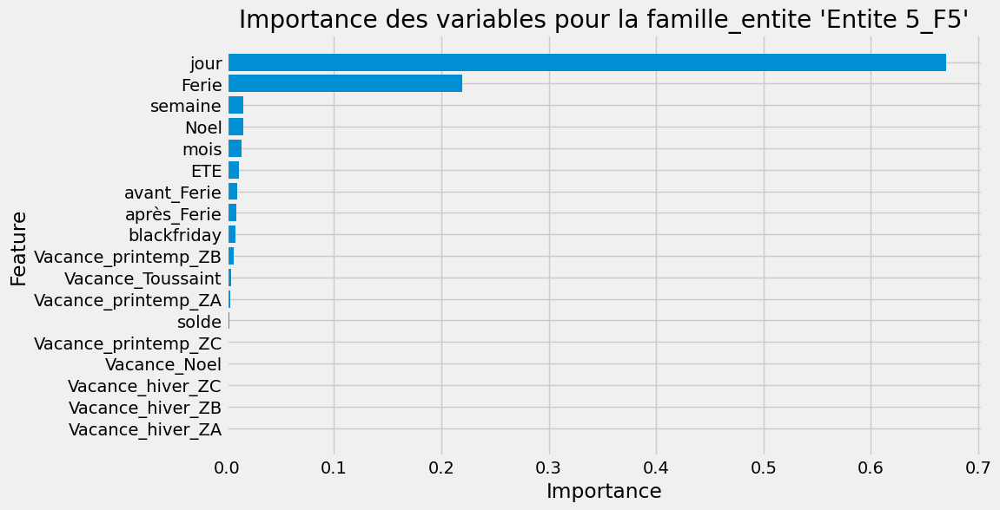

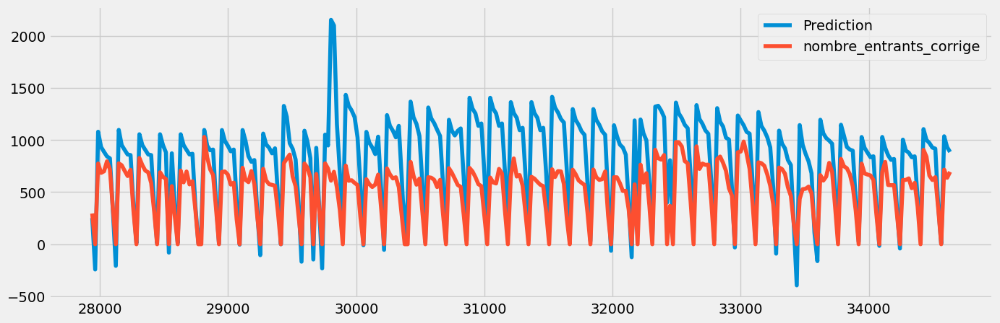

Les noms des features les plus importants pour la famille_entite 'Entite 5_F6':
R2:  -0.8656536076862247
MAE:  313.12527309479356
MAPE:  7.397394952382054e+16
MSE:  141005.1833701496
Meilleurs paramètres :  {'regressor__max_depth': 2, 'regressor__n_estimators': 100}


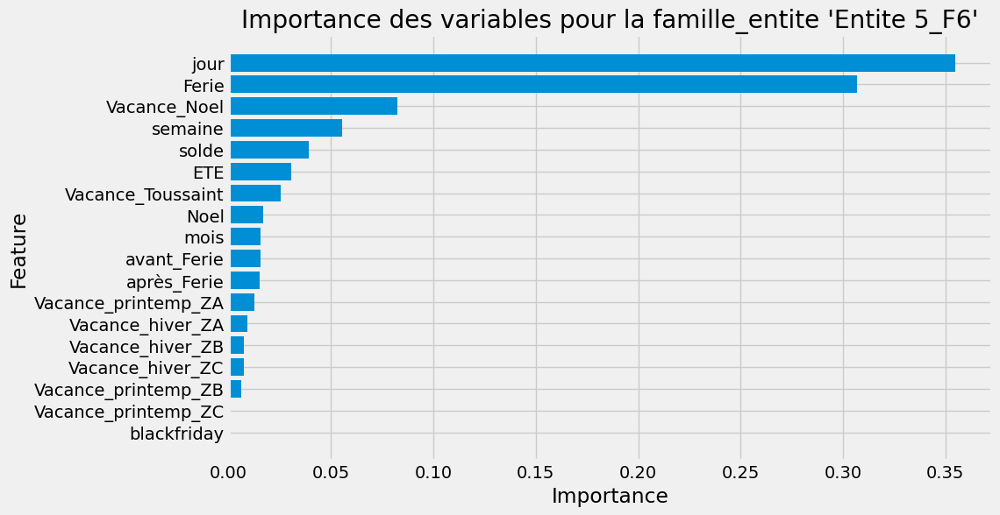

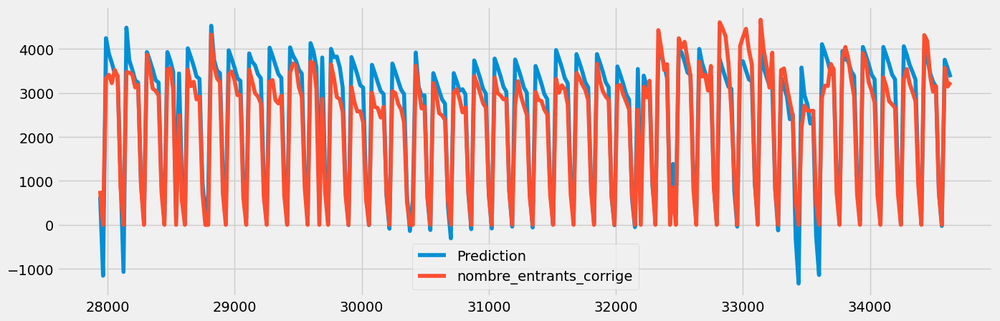

Les noms des features les plus importants pour la famille_entite 'Entite 5_F7':
R2:  0.8970675523155351
MAE:  360.13806605989527
MAPE:  1.7337723164295885e+17
MSE:  201412.78442954057
Meilleurs paramètres :  {'regressor__max_depth': 2, 'regressor__n_estimators': 100}


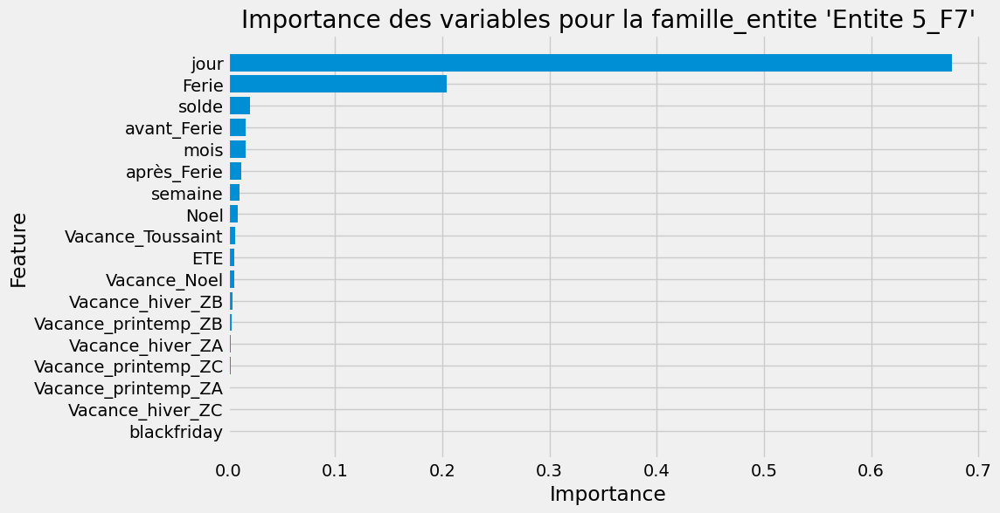

In [ ]:
import datetime
import pandas as pd
import xgboost as xgb
import matplotlib.pyplot as plt
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import OneHotEncoder, OrdinalEncoder
from sklearn.model_selection import TimeSeriesSplit, GridSearchCV
from sklearn.metrics import accuracy_score, r2_score



# Convertir la colonne "date" en objets datetime
df_all_data['date'] = pd.to_datetime(df_all_data['date'])
# Définir la date initiale
date_initiale = datetime.datetime(2022, 4, 29)

# Parcourir chaque groupe de famille_entite
for famille_entite, group_df in df_all_data.groupby('famille_entite'):
    # Séparer les données en ensemble d'entraînement et ensemble de test
    train_df = group_df.loc[group_df['date'] <= date_initiale]
    test_df = group_df.loc[group_df['date'] > date_initiale]
    
    # Séparer les caractéristiques et la variable cible
    X_train = train_df.drop(['date','nombre_entrants_corrige','famille_entite','annee'], axis=1)
    X_test = test_df.drop(['date','nombre_entrants_corrige','famille_entite','annee'], axis=1)
    y_train = train_df['nombre_entrants_corrige']
    y_test = test_df['nombre_entrants_corrige']

    # Définir les colonnes catégorielles
    cols = X_train.columns  # Ajoutez d'autres colonnes catégorielles si nécessaire

    # Créer un pipeline pour l'encodage des colonnes catégorielles et l'entraînement du modèle
    pipeline = Pipeline([
        ('encoding', ColumnTransformer([
            ('onehot', OrdinalEncoder(), cols)
        ], remainder='passthrough')),
        ('regressor', xgb.XGBRegressor())
    ])

    # Définir les paramètres de la recherche de grille
    param_grid = {
        'regressor__n_estimators': [100],
        'regressor__max_depth': [2,3],
        # 'regressor__learning_rate': [0.3,0.4,0.5]
    }

    # Créer l'objet TimeSeriesSplit
    tscv = TimeSeriesSplit(n_splits=5)

    # Créer l'objet GridSearchCV
    grid_search = GridSearchCV(pipeline, param_grid, cv=tscv, scoring='r2')

    # Entraîner le modèle avec la recherche de grille
    grid_search.fit(X_train, y_train)

    # Obtenir le meilleur modèle
    best_model = grid_search.best_estimator_

    # Prédire les valeurs pour l'ensemble de test
    y_pred = best_model.predict(X_test)

    # Tracer les prédictions et les valeurs réelles
    test_df['Prediction'] = y_pred
    test_df[['Prediction', 'nombre_entrants_corrige']].plot(figsize=(15, 5))
    plt.show()

    # Obtenir l'importance des caractéristiques
    importance = best_model.named_steps['regressor'].feature_importances_

    # Obtenir les noms des features après l'encodage
    encoded_feature_names = best_model.named_steps['encoding'].transformers_[0][1].get_feature_names_out(cols)

    # Créer un DataFrame avec les noms des features et leur importance
    feature_importance_df = pd.DataFrame({'Feature': encoded_feature_names, 'Importance': importance})

    # Trier les features par importance décroissante
    feature_importance_df = feature_importance_df.sort_values('Importance', ascending=True).reset_index(drop=True)

    # Afficher les noms des features les plus importants
    print(f"Les noms des features les plus importants pour la famille_entite '{famille_entite}':")
   # Afficher le meilleur score
    print('R2: ', r2_score(y_pred = y_pred, y_true = y_test ))

    print('MAE: ', mean_absolute_error(y_pred = y_pred, y_true = y_test ))
    print('MAPE: ', mean_absolute_percentage_error(y_pred =  y_pred, y_true = y_test ))
    print('MSE: ', mean_squared_error(y_pred = y_pred, y_true = y_test ))
    # Afficher les meilleurs paramètres
    print("Meilleurs paramètres : ", grid_search.best_params_)

    # Tracer le barplot des features les plus importants
    plt.figure(figsize=(10, 6))
    plt.barh(feature_importance_df['Feature'], feature_importance_df['Importance'])
    plt.xlabel('Importance')
    plt.ylabel('Feature')
    plt.title(f"Importance des variables pour la famille_entite '{famille_entite}'")
    plt.show()

### Xgboost apartir de 2021 

In [ ]:
# import pandas as pd

# # Supprimer les lignes correspondant à la plage de dates spécifique
# df_all_data = df_all_data[~df_all_data['date'].between('2019-01-02', '2020-12-31')]
# df_all_data

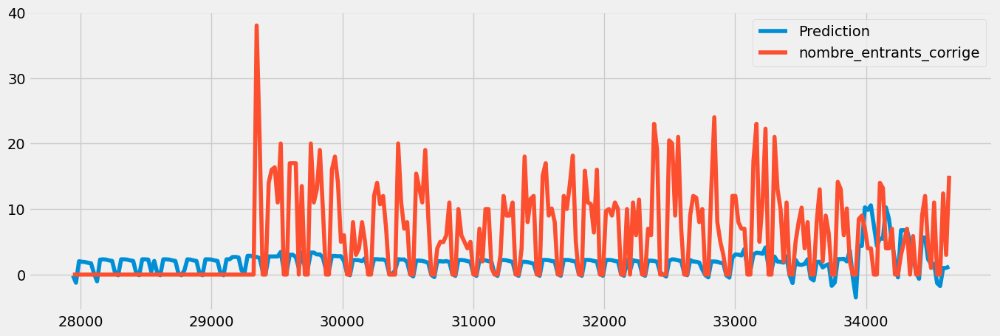

Les noms des features les plus importants pour la famille_entite 'Entite 1_F1':
R2:  -0.21969597205054958
MAE:  5.04735168595221
MAPE:  2342817594461927.5
MSE:  54.57640730859546
Meilleurs paramètres :  {'regressor__max_depth': 2, 'regressor__n_estimators': 100}


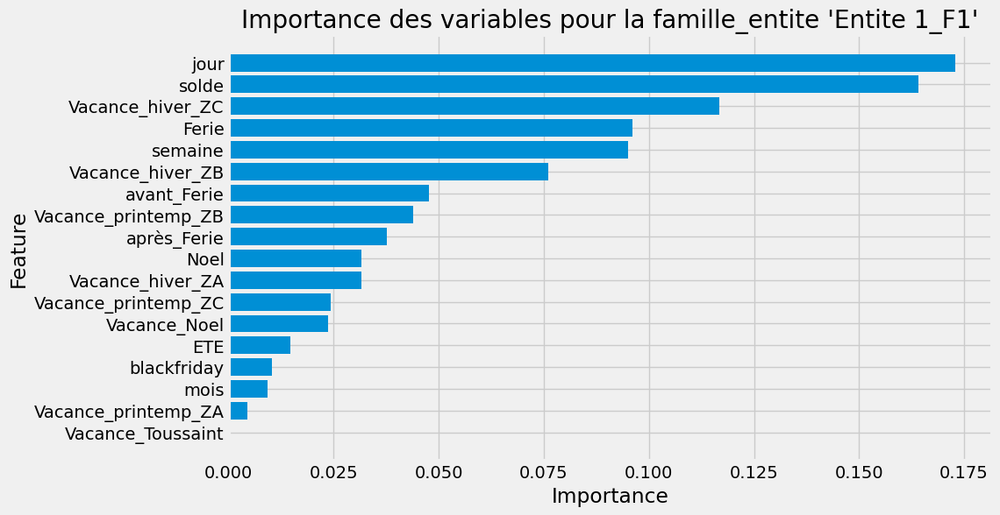

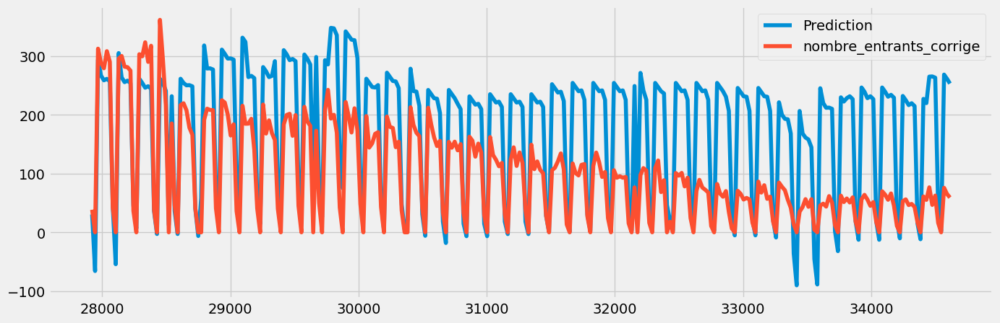

Les noms des features les plus importants pour la famille_entite 'Entite 1_F2':
R2:  -0.6114254475492
MAE:  87.36221064832203
MAPE:  1.5246255563440576e+16
MSE:  11433.64383046494
Meilleurs paramètres :  {'regressor__max_depth': 2, 'regressor__n_estimators': 100}


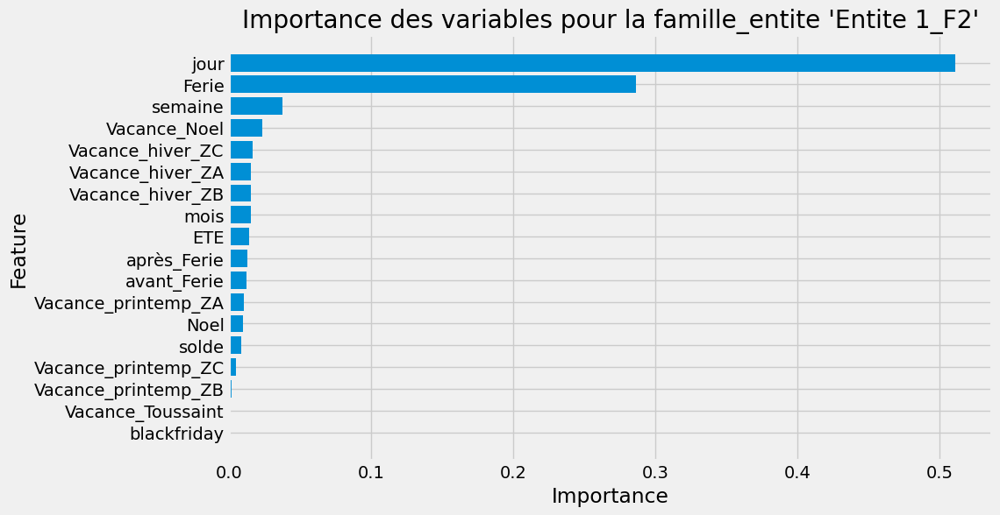

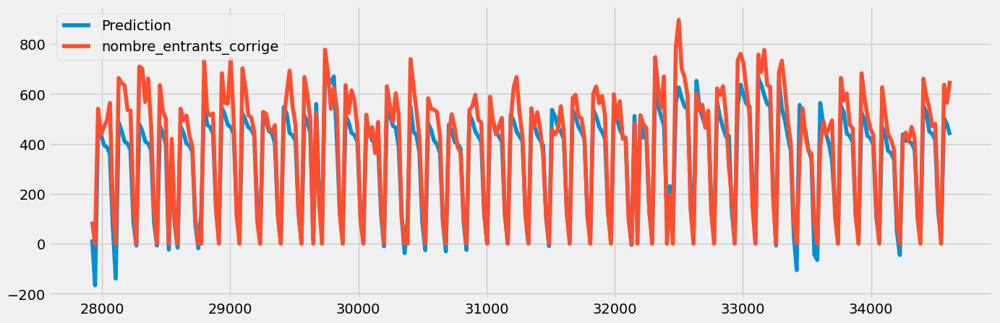

Les noms des features les plus importants pour la famille_entite 'Entite 1_F3':
R2:  0.8569971207571387
MAE:  69.86505329317241
MAPE:  2.801898900260342e+16
MSE:  8395.24609124603
Meilleurs paramètres :  {'regressor__max_depth': 2, 'regressor__n_estimators': 100}


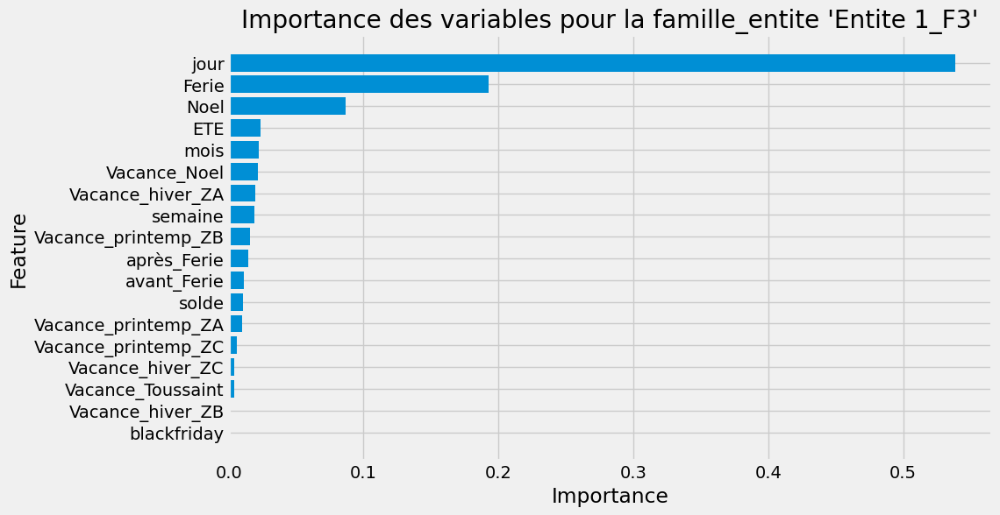

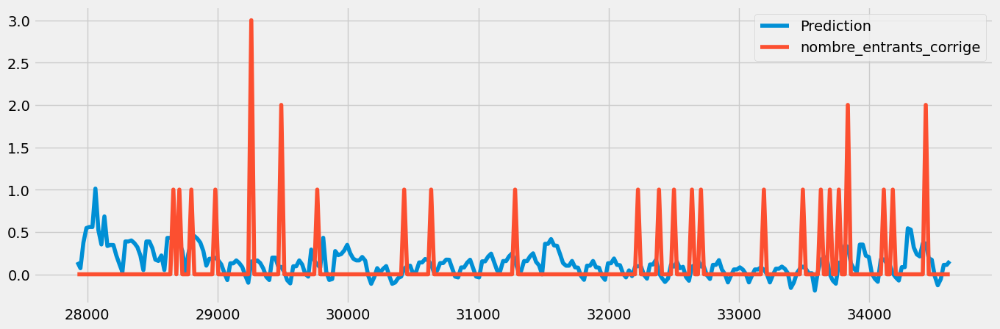

Les noms des features les plus importants pour la famille_entite 'Entite 1_F4':
R2:  -0.14094821780424716
MAE:  0.22607231910670597
MAPE:  629335629383203.1
MSE:  0.148947910165827
Meilleurs paramètres :  {'regressor__max_depth': 2, 'regressor__n_estimators': 100}


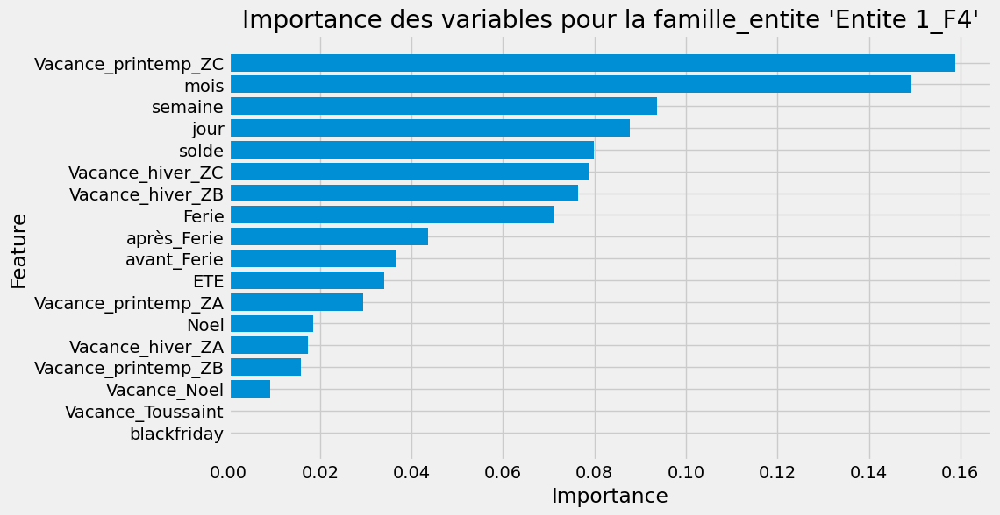

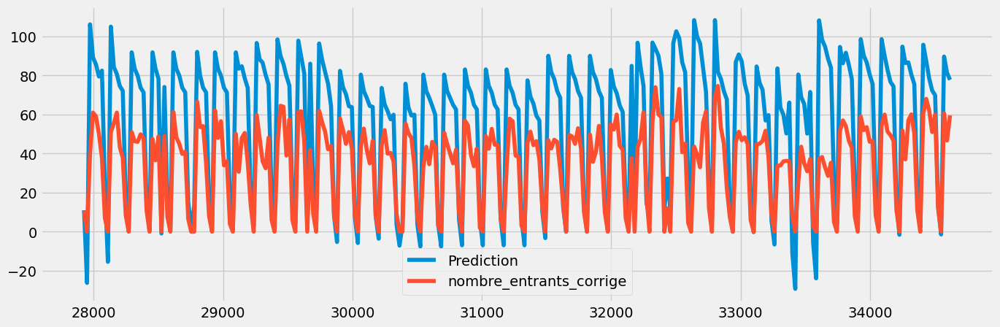

Les noms des features les plus importants pour la famille_entite 'Entite 1_F5':
R2:  -0.7115165600128506
MAE:  23.81791379489567
MAPE:  4575037538018514.0
MSE:  810.6004074649915
Meilleurs paramètres :  {'regressor__max_depth': 2, 'regressor__n_estimators': 100}


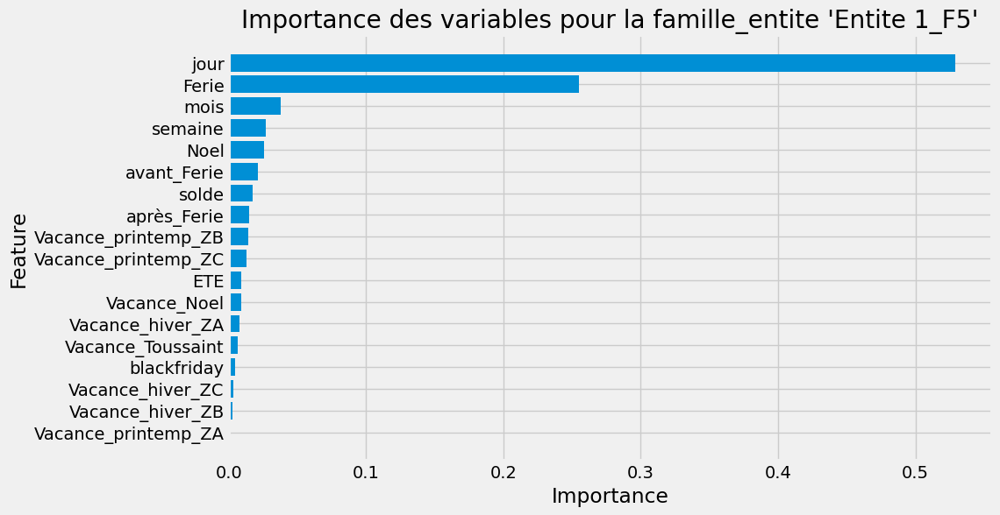

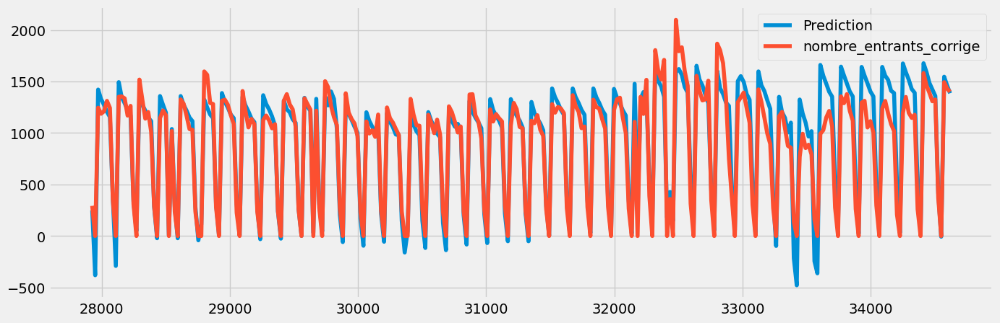

Les noms des features les plus importants pour la famille_entite 'Entite 1_F6':
R2:  0.9008783350694042
MAE:  123.5676151002637
MAPE:  6.505725418214487e+16
MSE:  28872.46361929339
Meilleurs paramètres :  {'regressor__max_depth': 2, 'regressor__n_estimators': 100}


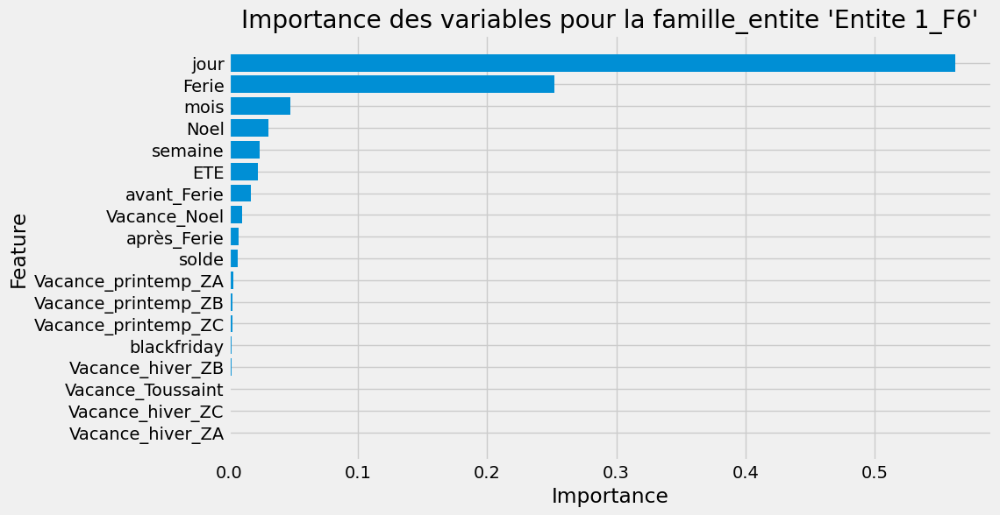

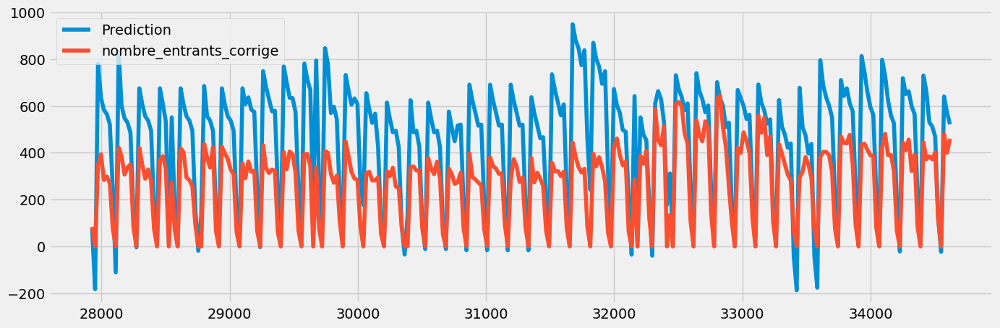

Les noms des features les plus importants pour la famille_entite 'Entite 1_F7':
R2:  -0.7170357434940062
MAE:  187.76747382279095
MAPE:  4.1409750208197336e+16
MSE:  48942.62206651838
Meilleurs paramètres :  {'regressor__max_depth': 2, 'regressor__n_estimators': 100}


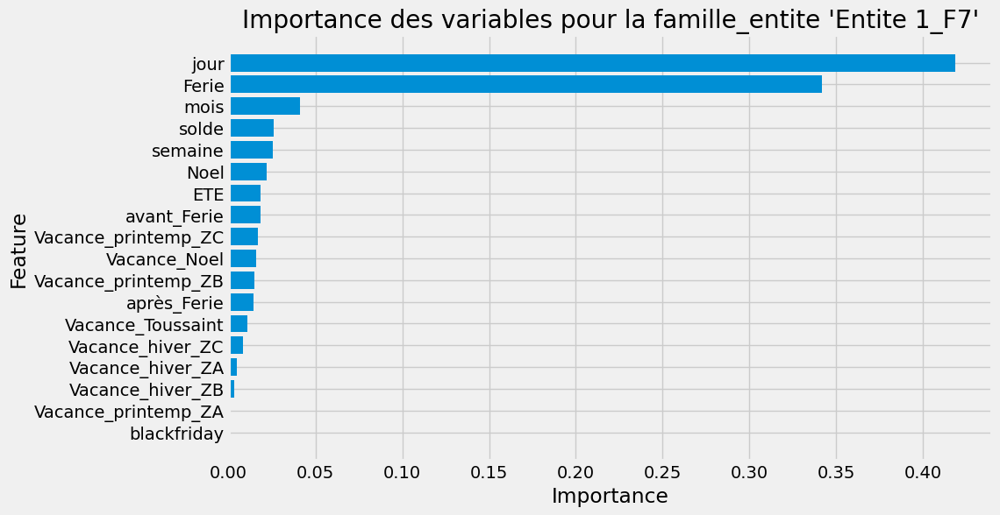

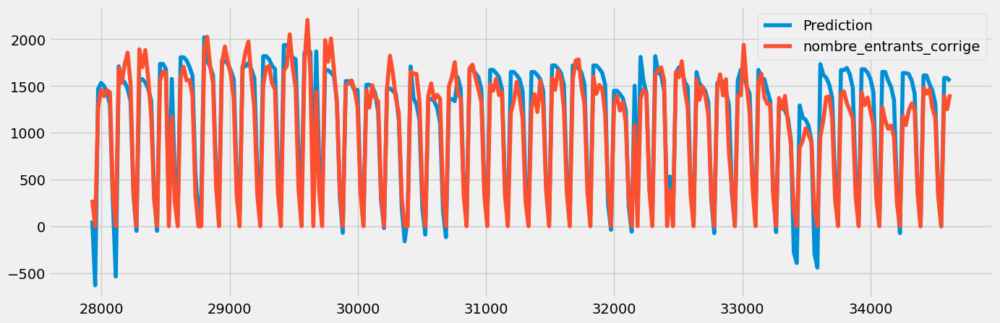

Les noms des features les plus importants pour la famille_entite 'Entite 2_F1':
R2:  0.8865755101658139
MAE:  169.53223838568624
MAPE:  1.0427151484763128e+17
MSE:  46615.95916660463
Meilleurs paramètres :  {'regressor__max_depth': 2, 'regressor__n_estimators': 100}


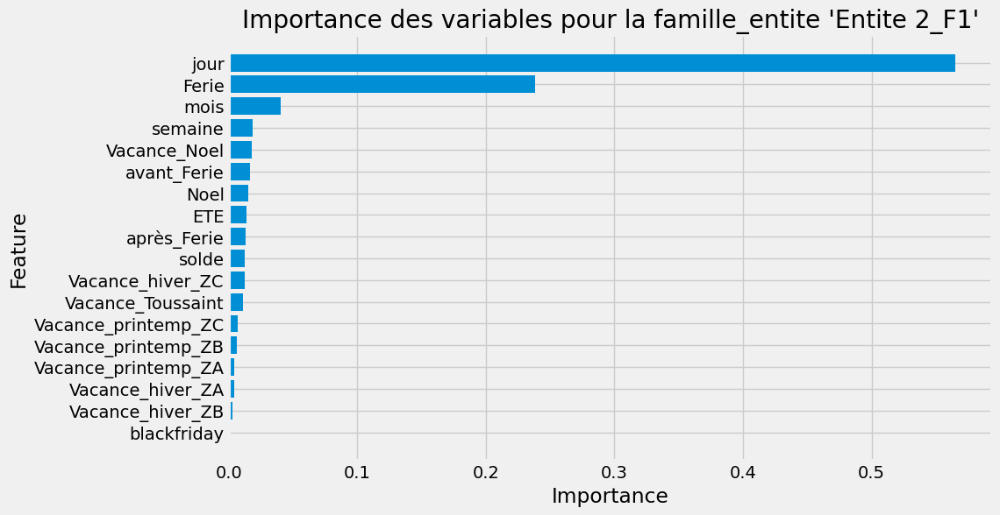

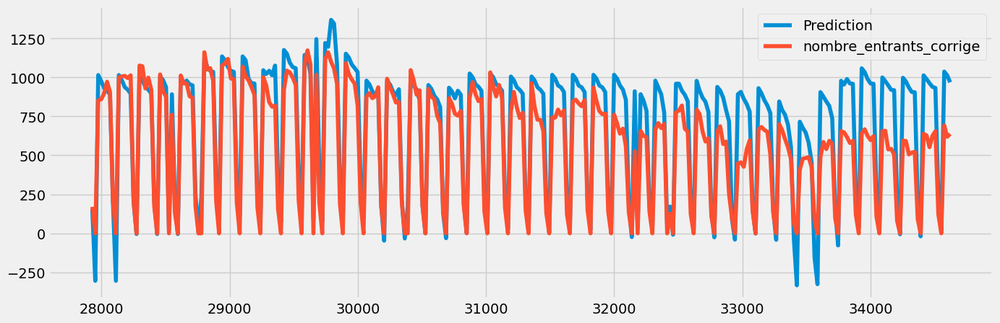

Les noms des features les plus importants pour la famille_entite 'Entite 2_F2':
R2:  0.7577906559062989
MAE:  137.71743611822527
MAPE:  5.094072169454651e+16
MSE:  33345.19718601506
Meilleurs paramètres :  {'regressor__max_depth': 2, 'regressor__n_estimators': 100}


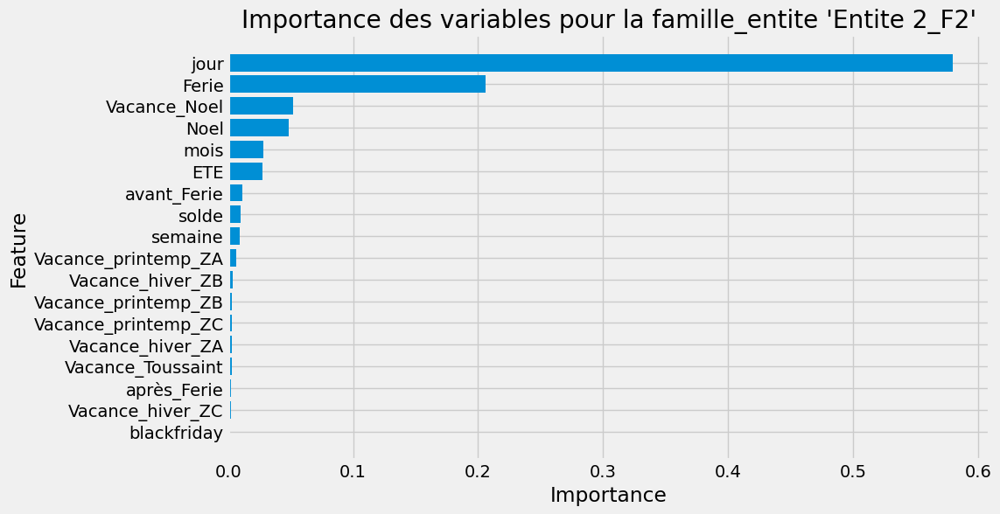

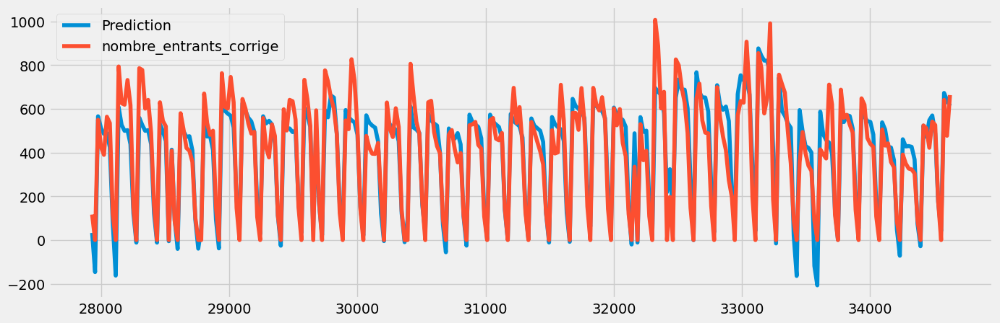

Les noms des features les plus importants pour la famille_entite 'Entite 2_F3':
R2:  0.8560365683807225
MAE:  72.20960831898616
MAPE:  3.525243945310842e+16
MSE:  9269.648404044972
Meilleurs paramètres :  {'regressor__max_depth': 2, 'regressor__n_estimators': 100}


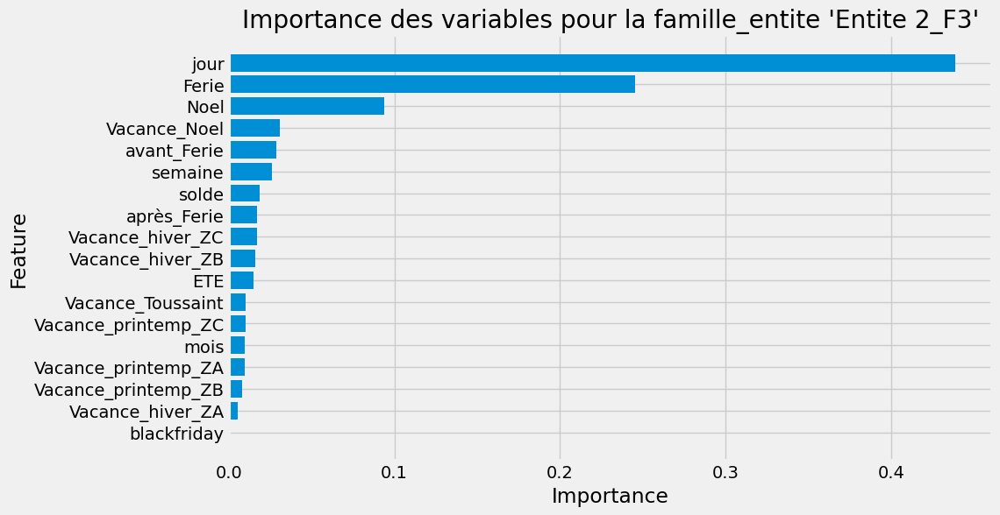

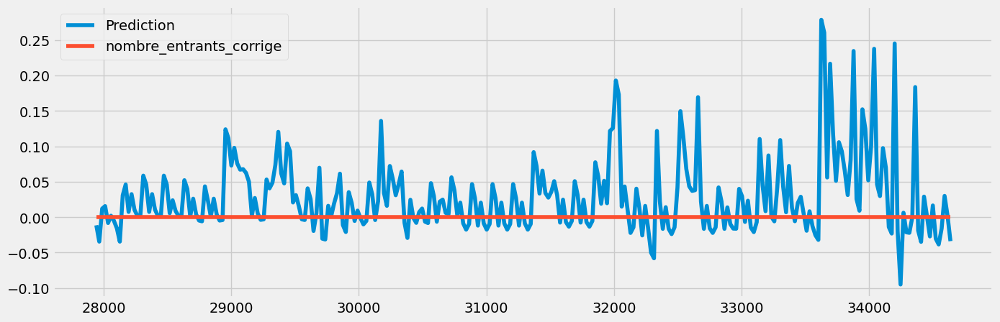

Les noms des features les plus importants pour la famille_entite 'Entite 2_F5':
R2:  0.0
MAE:  0.03898626781331474
MAPE:  175578541196610.62
MSE:  0.0036478333299003025
Meilleurs paramètres :  {'regressor__max_depth': 2, 'regressor__n_estimators': 100}


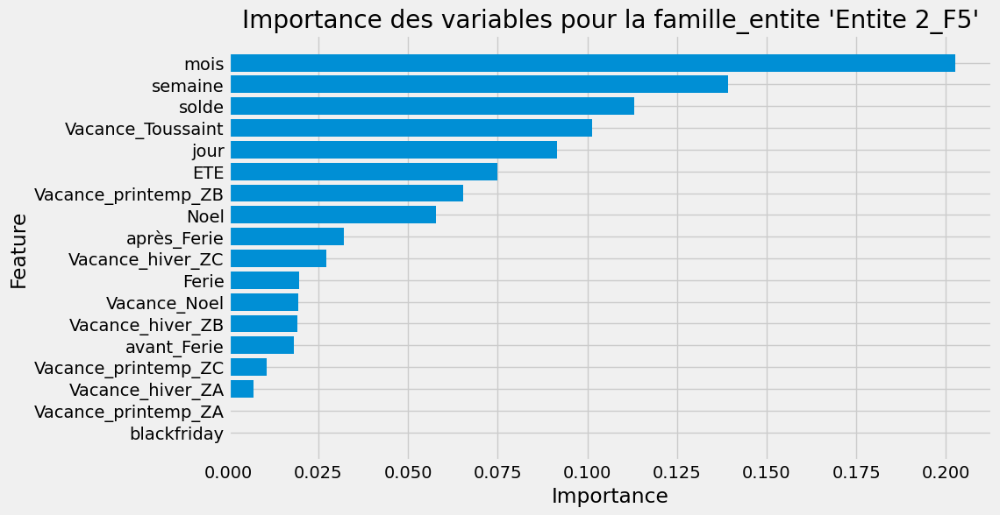

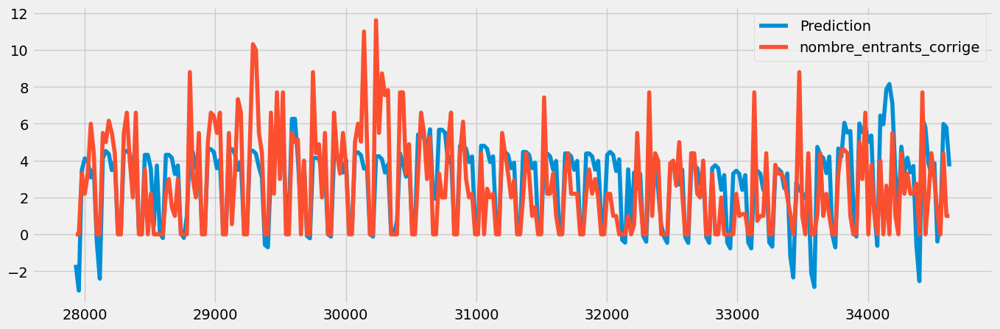

Les noms des features les plus importants pour la famille_entite 'Entite 3_F2':
R2:  0.316809682615515
MAE:  1.5748951741204902
MAPE:  1676018616254240.0
MSE:  4.617830606497713
Meilleurs paramètres :  {'regressor__max_depth': 2, 'regressor__n_estimators': 100}


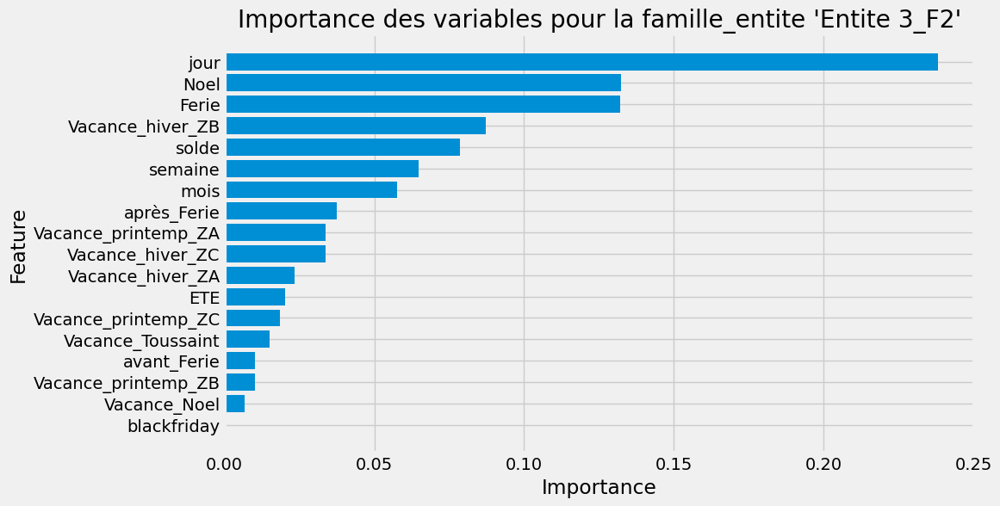

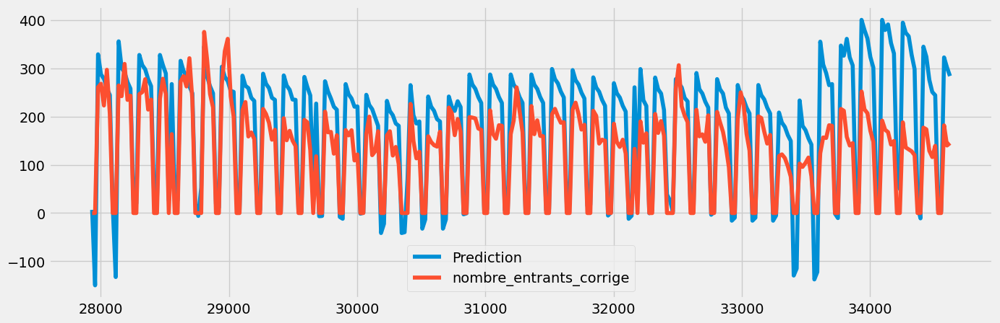

Les noms des features les plus importants pour la famille_entite 'Entite 3_F5':
R2:  0.26425477811366926
MAE:  63.74118565762499
MAPE:  3.4172453009120044e+16
MSE:  6664.138592323083
Meilleurs paramètres :  {'regressor__max_depth': 2, 'regressor__n_estimators': 100}


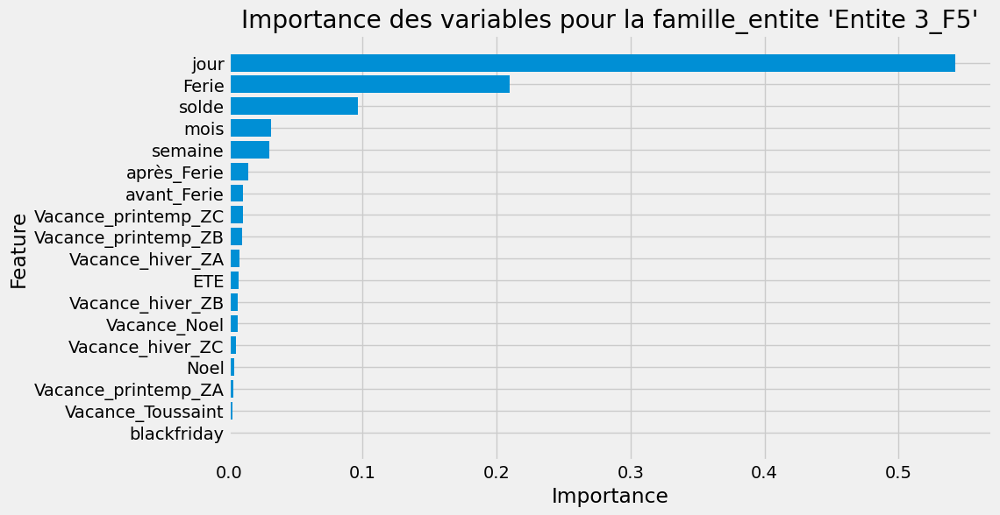

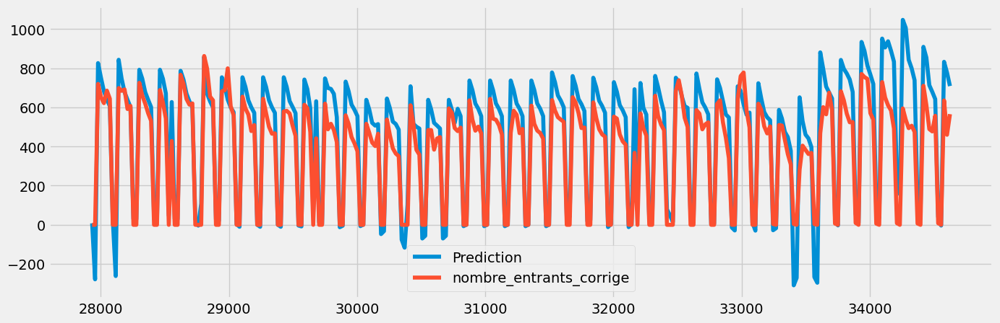

Les noms des features les plus importants pour la famille_entite 'Entite 3_F7':
R2:  0.7586964368867697
MAE:  99.84361635633702
MAPE:  5.007140244357299e+16
MSE:  17199.719224184315
Meilleurs paramètres :  {'regressor__max_depth': 2, 'regressor__n_estimators': 100}


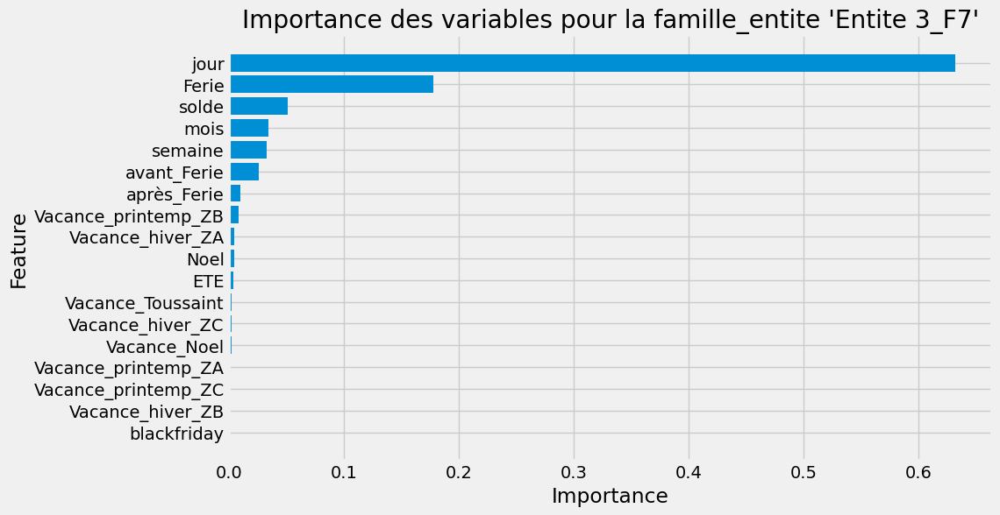

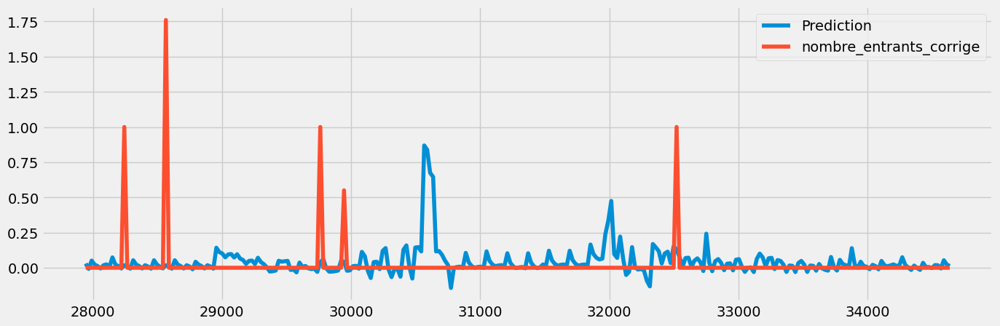

Les noms des features les plus importants pour la famille_entite 'Entite 4_F1':
R2:  -0.5255818989519254
MAE:  0.07014517987469507
MAPE:  237844591747408.66
MSE:  0.032933436620047954
Meilleurs paramètres :  {'regressor__max_depth': 2, 'regressor__n_estimators': 100}


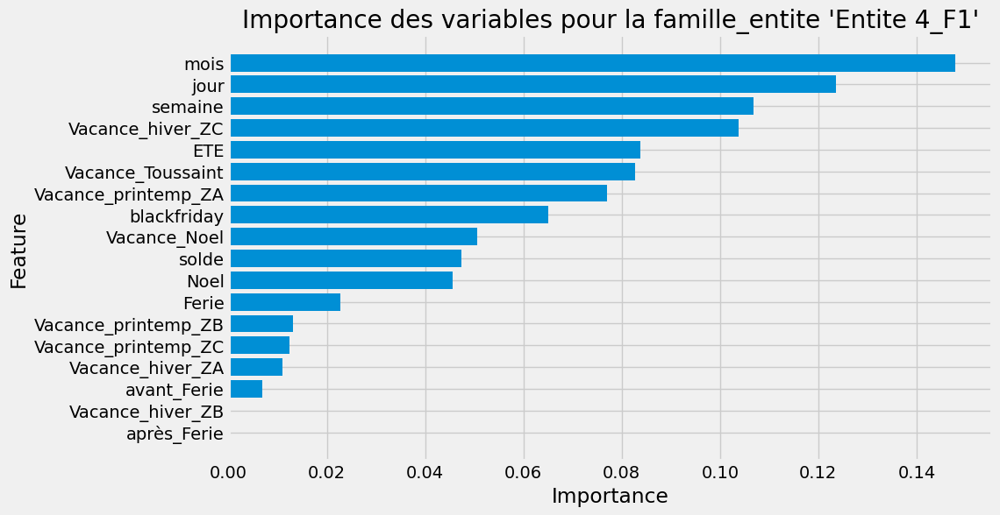

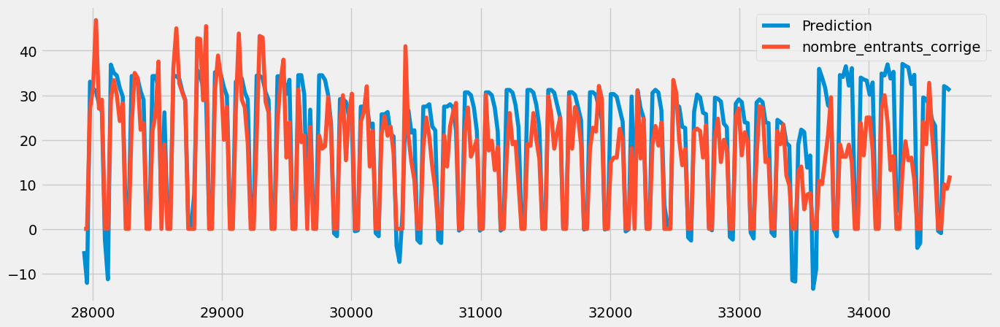

Les noms des features les plus importants pour la famille_entite 'Entite 4_F5':
R2:  0.5331916233330813
MAE:  6.323789812684022
MAPE:  3556099984978425.0
MSE:  72.06032797290446
Meilleurs paramètres :  {'regressor__max_depth': 2, 'regressor__n_estimators': 100}


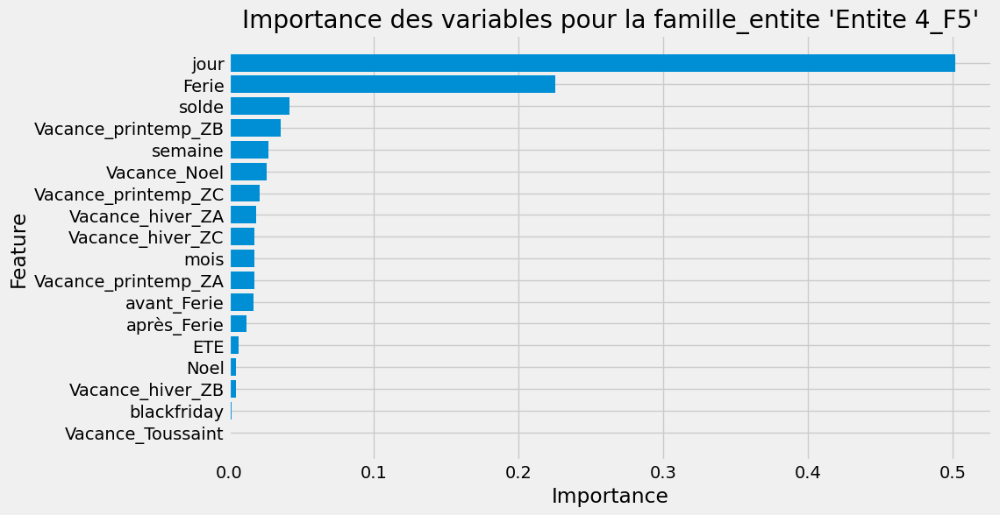

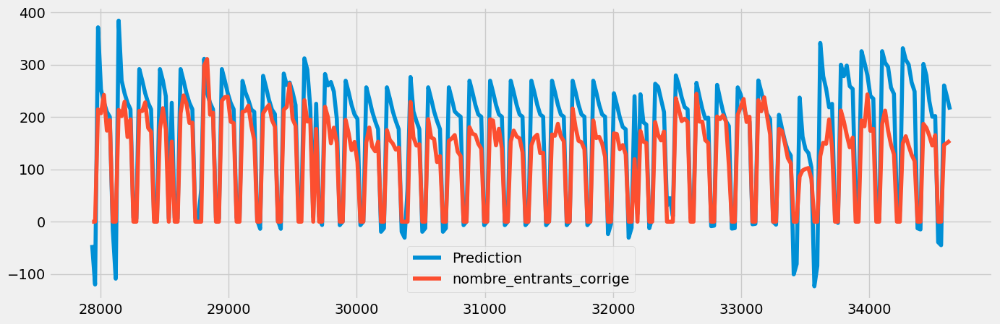

Les noms des features les plus importants pour la famille_entite 'Entite 4_F7':
R2:  0.47771664184443197
MAE:  48.50341801793636
MAPE:  2.643490335702277e+16
MSE:  3922.792925819728
Meilleurs paramètres :  {'regressor__max_depth': 2, 'regressor__n_estimators': 100}


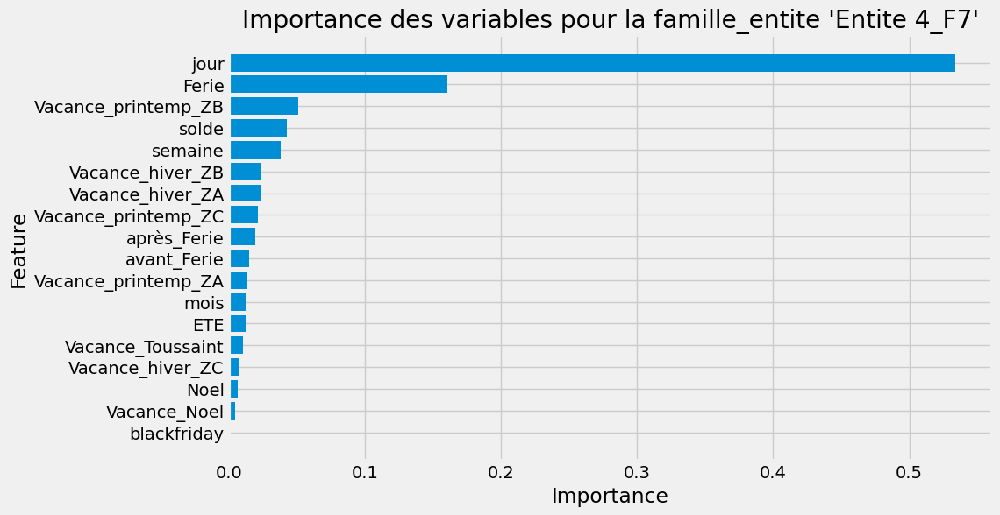

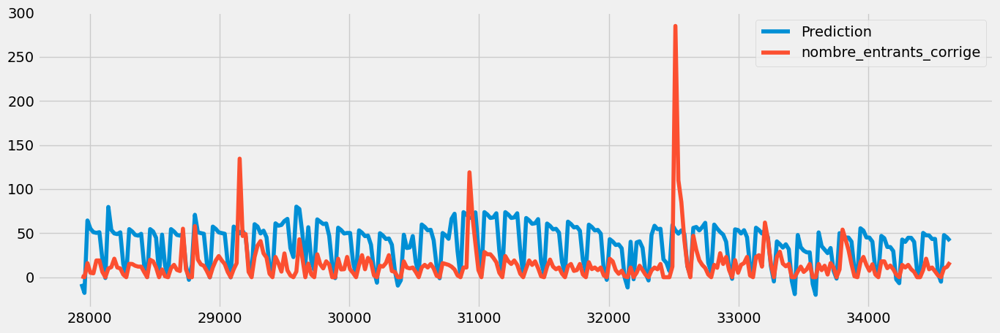

Les noms des features les plus importants pour la famille_entite 'Entite 5_F1':
R2:  -1.2901790285612367
MAE:  27.452632148386492
MAPE:  4894248489932718.0
MSE:  1197.5083206383943
Meilleurs paramètres :  {'regressor__max_depth': 2, 'regressor__n_estimators': 100}


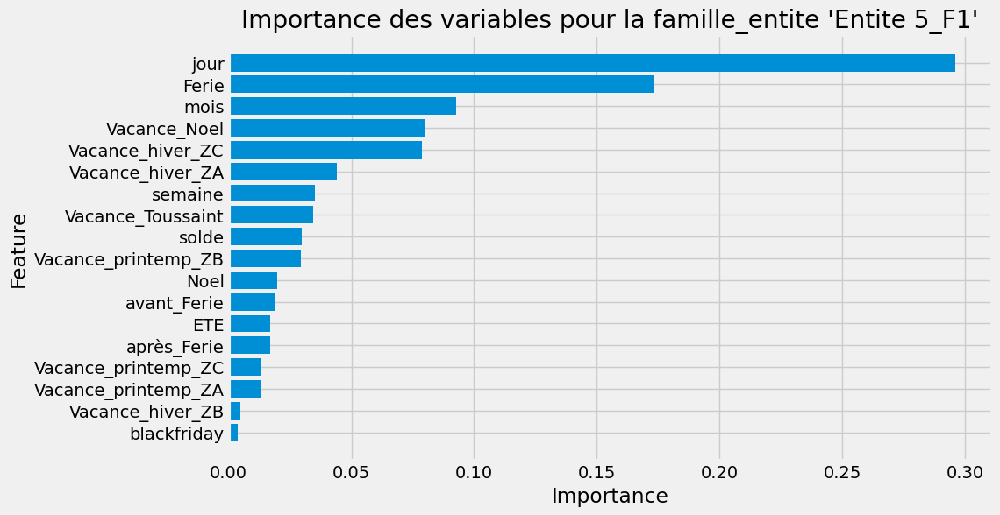

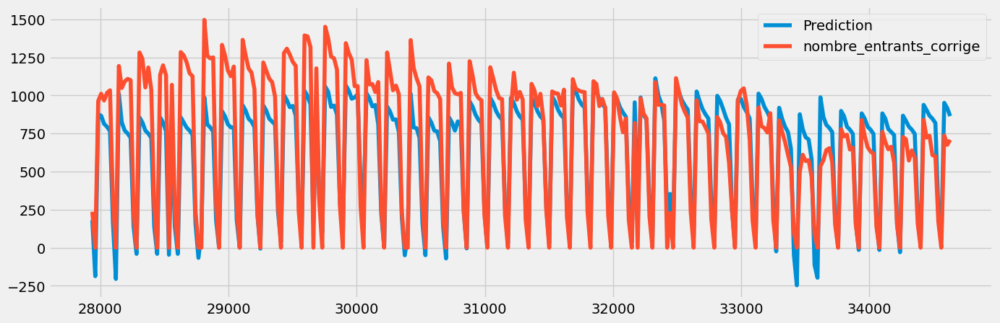

Les noms des features les plus importants pour la famille_entite 'Entite 5_F2':
R2:  0.8043269714479185
MAE:  156.44819117248105
MAPE:  5.152426863960311e+16
MSE:  39678.949748046165
Meilleurs paramètres :  {'regressor__max_depth': 2, 'regressor__n_estimators': 100}


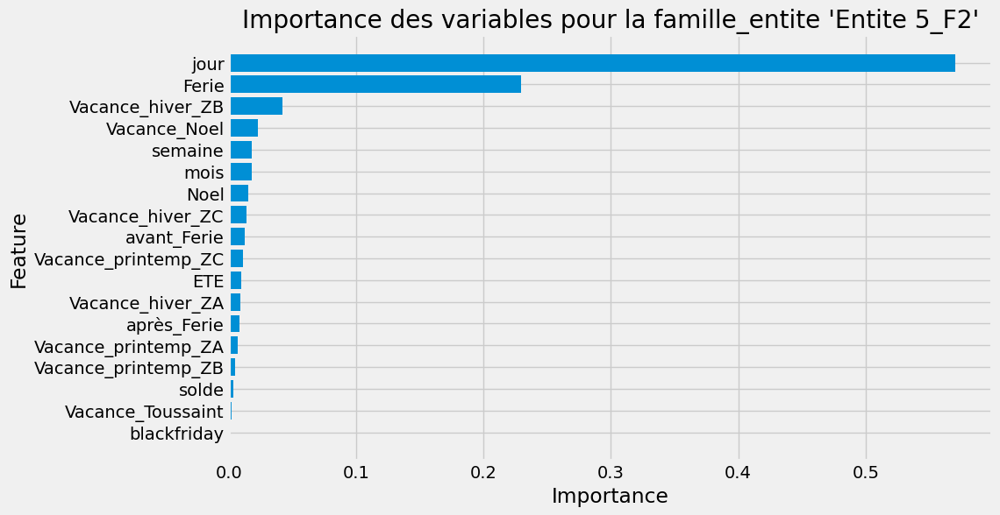

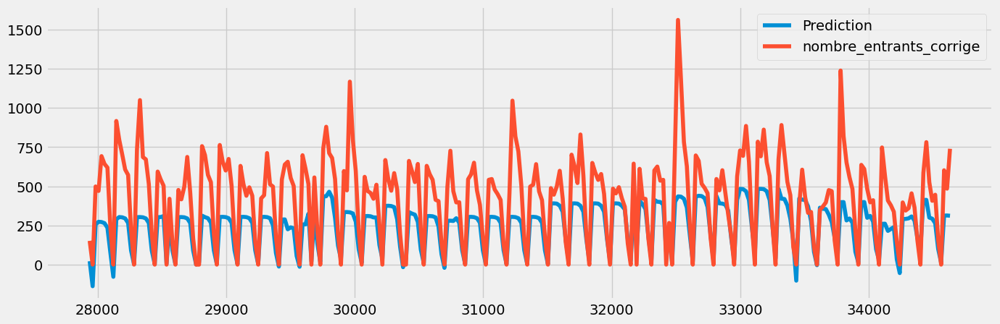

Les noms des features les plus importants pour la famille_entite 'Entite 5_F3':
R2:  0.19399441397168793
MAE:  184.35994541385227
MAPE:  2.1117320204957276e+16
MSE:  60347.1361018567
Meilleurs paramètres :  {'regressor__max_depth': 2, 'regressor__n_estimators': 100}


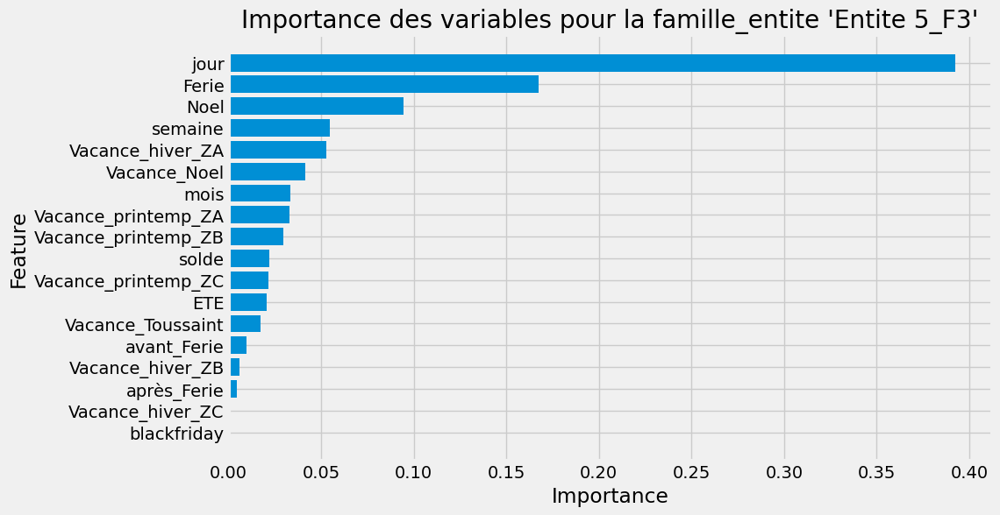

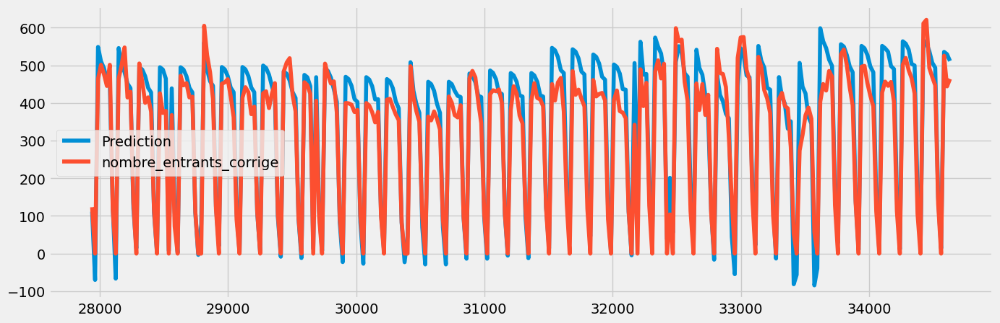

Les noms des features les plus importants pour la famille_entite 'Entite 5_F5':
R2:  0.9096766742799646
MAE:  44.169800773042496
MAPE:  1.857720670691934e+16
MSE:  3145.0973854031404
Meilleurs paramètres :  {'regressor__max_depth': 2, 'regressor__n_estimators': 100}


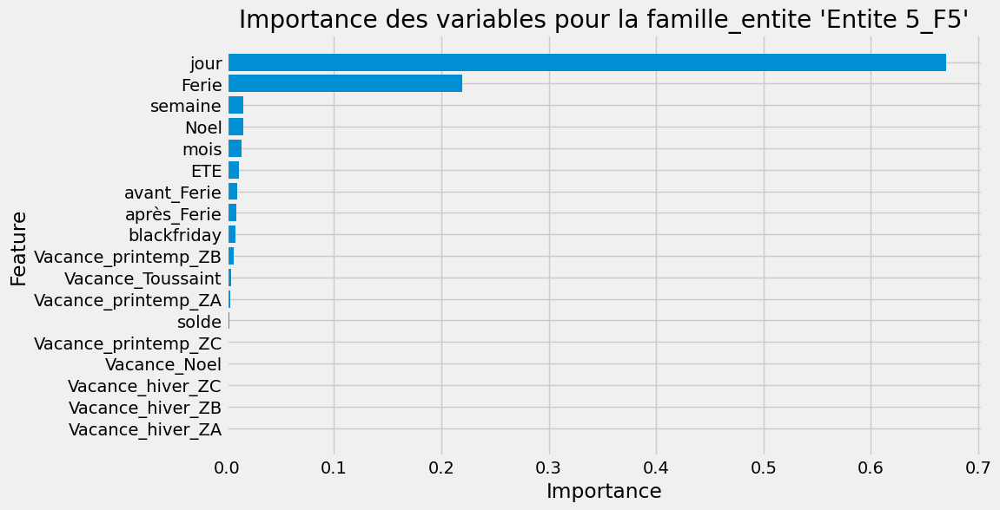

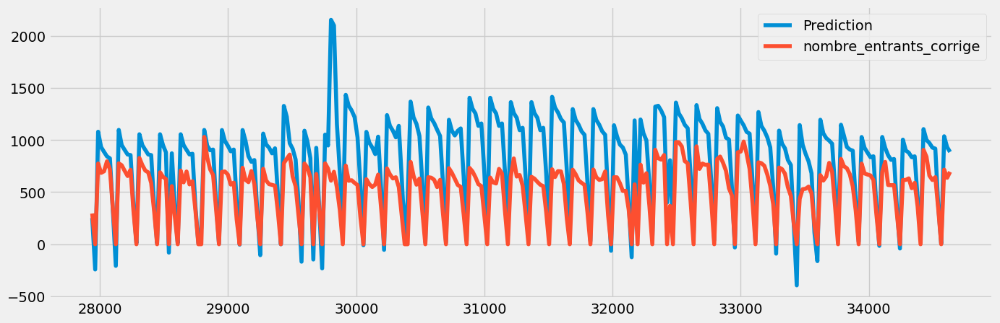

Les noms des features les plus importants pour la famille_entite 'Entite 5_F6':
R2:  -0.8656536076862247
MAE:  313.12527309479356
MAPE:  7.397394952382054e+16
MSE:  141005.1833701496
Meilleurs paramètres :  {'regressor__max_depth': 2, 'regressor__n_estimators': 100}


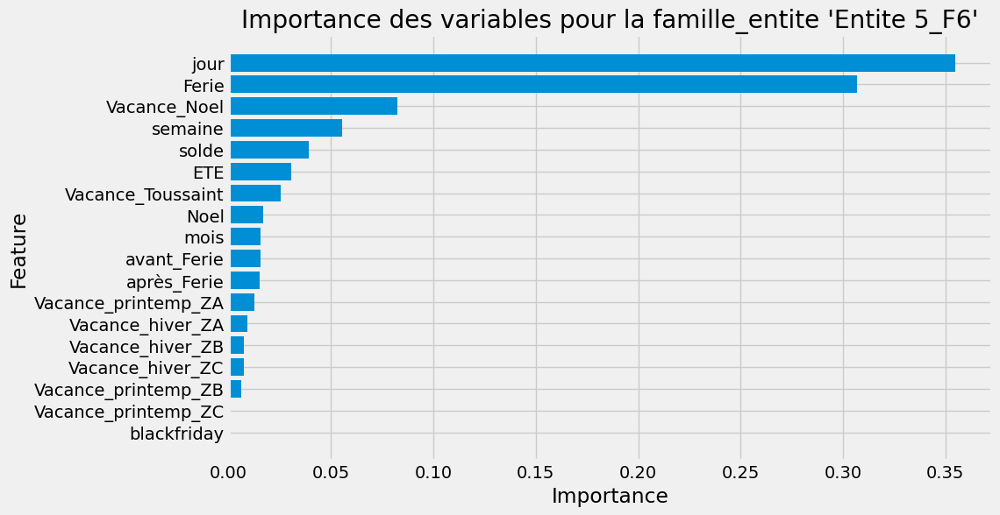

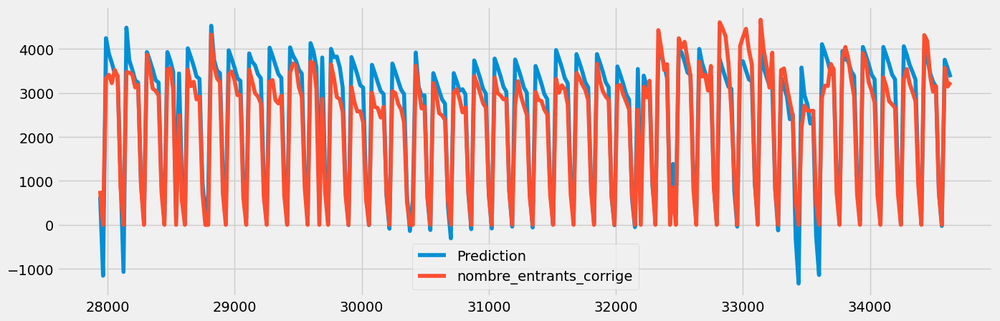

Les noms des features les plus importants pour la famille_entite 'Entite 5_F7':
R2:  0.8970675523155351
MAE:  360.13806605989527
MAPE:  1.7337723164295885e+17
MSE:  201412.78442954057
Meilleurs paramètres :  {'regressor__max_depth': 2, 'regressor__n_estimators': 100}


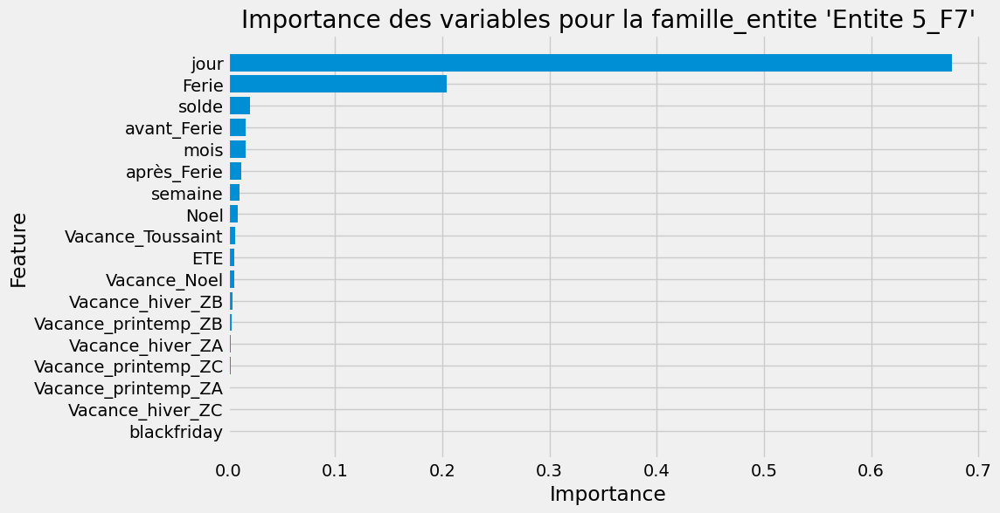

In [ ]:
import datetime
import pandas as pd
import xgboost as xgb
import matplotlib.pyplot as plt
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import OneHotEncoder, OrdinalEncoder
from sklearn.model_selection import TimeSeriesSplit, GridSearchCV
from sklearn.metrics import accuracy_score, r2_score
from sklearn.metrics import mean_squared_error, mean_absolute_error, mean_absolute_percentage_error



# Convertir la colonne "date" en objets datetime
df_all_data['date'] = pd.to_datetime(df_all_data['date'])
# Définir la date initiale
date_initiale = datetime.datetime(2022, 4, 29)

# Parcourir chaque groupe de famille_entite
for famille_entite, group_df in df_all_data.groupby('famille_entite'):
    # Séparer les données en ensemble d'entraînement et ensemble de test
    train_df = group_df.loc[group_df['date'] <= date_initiale]
    test_df = group_df.loc[group_df['date'] > date_initiale]
    
    # Séparer les caractéristiques et la variable cible
    X_train = train_df.drop(['date','nombre_entrants_corrige','famille_entite','annee'], axis=1)
    X_test = test_df.drop(['date','nombre_entrants_corrige','famille_entite','annee'], axis=1)
    y_train = train_df['nombre_entrants_corrige']
    y_test = test_df['nombre_entrants_corrige']

    # Définir les colonnes catégorielles
    cols = X_train.columns  # Ajoutez d'autres colonnes catégorielles si nécessaire

    # Créer un pipeline pour l'encodage des colonnes catégorielles et l'entraînement du modèle
    pipeline = Pipeline([
        ('encoding', ColumnTransformer([
            ('onehot', OrdinalEncoder(), cols)
        ], remainder='passthrough')),
        ('regressor', xgb.XGBRegressor())
    ])

    # Définir les paramètres de la recherche de grille
    param_grid = {
        'regressor__n_estimators': [100],
        'regressor__max_depth': [2,3],
        # 'regressor__learning_rate': [0.3,0.4,0.5]
    }

    # Créer l'objet TimeSeriesSplit
    tscv = TimeSeriesSplit(n_splits=5)

    # Créer l'objet GridSearchCV
    grid_search = GridSearchCV(pipeline, param_grid, cv=tscv, scoring='r2')

    # Entraîner le modèle avec la recherche de grille
    grid_search.fit(X_train, y_train)

    # Obtenir le meilleur modèle
    best_model = grid_search.best_estimator_

    # Prédire les valeurs pour l'ensemble de test
    y_pred = best_model.predict(X_test)

    # Tracer les prédictions et les valeurs réelles
    test_df['Prediction'] = y_pred
    test_df[['Prediction', 'nombre_entrants_corrige']].plot(figsize=(15, 5))
    plt.show()

    # Obtenir l'importance des caractéristiques
    importance = best_model.named_steps['regressor'].feature_importances_

    # Obtenir les noms des features après l'encodage
    encoded_feature_names = best_model.named_steps['encoding'].transformers_[0][1].get_feature_names_out(cols)

    # Créer un DataFrame avec les noms des features et leur importance
    feature_importance_df = pd.DataFrame({'Feature': encoded_feature_names, 'Importance': importance})

    # Trier les features par importance décroissante
    feature_importance_df = feature_importance_df.sort_values('Importance', ascending=True).reset_index(drop=True)

    # Afficher les noms des features les plus importants
    print(f"Les noms des features les plus importants pour la famille_entite '{famille_entite}':")
   # Afficher le meilleur score
    print('R2: ', r2_score(y_pred = y_pred, y_true = y_test ))

    print('MAE: ', mean_absolute_error(y_pred = y_pred, y_true = y_test ))
    print('MAPE: ', mean_absolute_percentage_error(y_pred =  y_pred, y_true = y_test ))
    print('MSE: ', mean_squared_error(y_pred = y_pred, y_true = y_test ))
    # Afficher les meilleurs paramètres
    print("Meilleurs paramètres : ", grid_search.best_params_)

    # Tracer le barplot des features les plus importants
    plt.figure(figsize=(10, 6))
    plt.barh(feature_importance_df['Feature'], feature_importance_df['Importance'])
    plt.xlabel('Importance')
    plt.ylabel('Feature')
    plt.title(f"Importance des variables pour la famille_entite '{famille_entite}'")
    plt.show()

### catboost

In [ ]:
# import datetime
# import pandas as pd
# import catboost as cb
# import matplotlib.pyplot as plt
# from sklearn.compose import ColumnTransformer
# from sklearn.pipeline import Pipeline
# from sklearn.preprocessing import OrdinalEncoder
# from sklearn.model_selection import TimeSeriesSplit, GridSearchCV
# from sklearn.metrics import r2_score

# # Convertir la colonne "date" en objets datetime
# df_all_data['date'] = pd.to_datetime(df_all_data['date'])
# # Définir la date initiale
# date_initiale = datetime.datetime(2022, 4, 29)

# # Parcourir chaque groupe de famille_entite
# for famille_entite, group_df in df_all_data.groupby('famille_entite'):
#     # Séparer les données en ensemble d'entraînement et ensemble de test
#     train_df = group_df.loc[group_df['date'] <= date_initiale]
#     test_df = group_df.loc[group_df['date'] > date_initiale]
    
#     # Séparer les caractéristiques et la variable cible
#     X_train = train_df.drop(['date', 'nombre_entrants_corrige', 'famille_entite', 'annee'], axis=1)
#     X_test = test_df.drop(['date', 'nombre_entrants_corrige', 'famille_entite', 'annee'], axis=1)
#     y_train = train_df['nombre_entrants_corrige']
#     y_test = test_df['nombre_entrants_corrige']

#     # Définir les colonnes catégorielles
#     cols = X_train.columns  # Ajoutez d'autres colonnes catégorielles si nécessaire

#     # Créer un pipeline pour l'encodage des colonnes catégorielles et l'entraînement du modèle
#     pipeline = Pipeline([
#         ('encoding', ColumnTransformer([
#             ('ordinal', OrdinalEncoder(), cols)
#         ], remainder='passthrough')),
#         ('regressor', cb.CatBoostRegressor())
#     ])

#     # Définir les paramètres de la recherche de grille
#     param_grid = {
#         'regressor__n_estimators': [100, 200, 250],
#         'regressor__max_depth': [2,3, 5, 7],
#         'regressor__learning_rate': [0.1, 0.01, 0.001]
#     }

#     # Créer l'objet TimeSeriesSplit
#     tscv = TimeSeriesSplit(n_splits=5)

#     # Créer l'objet GridSearchCV
#     grid_search = GridSearchCV(pipeline, param_grid, cv=tscv, scoring='r2')

#     # Entraîner le modèle avec la recherche de grille
#     grid_search.fit(X_train, y_train)

#     # Obtenir le meilleur modèle
#     best_model = grid_search.best_estimator_

#     # Prédire les valeurs pour l'ensemble de test
#     y_pred = best_model.predict(X_test)

#     # Tracer les prédictions et les valeurs réelles
#     test_df['Prediction'] = y_pred
#     test_df[['Prediction', 'nombre_entrants_corrige']].plot(figsize=(15, 5))
#     plt.show()

#     # Obtenir l'importance des caractéristiques
#     importance = best_model.named_steps['regressor'].get_feature_importance()

#     # Créer un DataFrame avec les noms des features et leur importance
#     feature_importance_df = pd.DataFrame({'Feature': cols, 'Importance': importance})

#     # Trier les features par importance décroissante
#     feature_importance_df = feature_importance_df.sort_values('Importance', ascending=True).reset_index(drop=True)

#     # Afficher les noms des features les plus importants
#     print(f"Les noms des features les plus importants pour la famille_entite '{famille_entite}':")

#     # Afficher le score R2
#     print('R2:', r2_score(y_pred=y_pred, y_true=y_test))

#     # Afficher les meilleurs paramètres
#     print("Meilleurs paramètres:", grid_search.best_params_)

#     # Tracer le barplot des features les plus importants
#     plt.figure(figsize=(10, 6))
#     plt.barh(feature_importance_df['Feature'], feature_importance_df['Importance'])
#     plt.xlabel('Importance')
#     plt.ylabel('Feature')
#     plt.title(f"Importance des variables pour la famille_entite '{famille_entite}'")
#     plt.show()


## sans jour ferier et dimanche 

In [ ]:
import pandas as pd
df_df=df_all_data.copy()

In [ ]:

# import pandas as pd

# # Supprimer les lignes correspondant à la plage de dates spécifique
# df_all_data = df_all_data[~df_all_data['date'].between('2019-01-02', '2020-12-31')]
# df_all_data
df_all= df_all_data.drop(df_all_data[(df_all_data['jour'] == 'Dimanche') | (df_all_data['nombre_entrants_corrige'] < 1)].index)

df_all.drop('Ferie', axis=1, inplace=True)

KeyError: "['Ferie'] not found in axis"

In [ ]:
df_all

,date,famille_entite,nombre_entrants_corrige,jour,mois,avant_Ferie,après_Ferie,Noel,ETE,Vacance_Noel,Vacance_Toussaint,Vacance_hiver_ZA,Vacance_hiver_ZB,Vacance_hiver_ZC,Vacance_printemp_ZA,Vacance_printemp_ZB,Vacance_printemp_ZC
0,2019-01-02,Entite 1_F2,165.000000,mercredi,janvier,False,False,None,None,deuxieme_semaine,None,None,None,None,None,None,None
1,2019-01-02,Entite 1_F3,54.000000,mercredi,janvier,False,False,None,None,deuxieme_semaine,None,None,None,None,None,None,None
2,2019-01-02,Entite 1_F4,1.000000,mercredi,janvier,False,False,None,None,deuxieme_semaine,None,None,None,None,None,None,None
3,2019-01-02,Entite 1_F5,99.000000,mercredi,janvier,False,False,None,None,deuxieme_semaine,None,None,None,None,None,None,None
4,2019-01-02,Entite 1_F6,1487.000000,mercredi,janvier,False,False,None,None,deuxieme_semaine,None,None,None,None,None,None,None
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
34631,2023-02-15,Entite 5_F3,738.935876,mercredi,février,False,False,None,None,None,None,deuxieme_semaine,premiere_semaine,None,None,None,None
34632,2023-02-15,Entite 5_F5,463.642180,mercredi,février,False,False,None,None,None,None,deuxieme_semaine,premiere_semaine,None,None,None,None
34633,2023-02-15,Entite 5_F6,694.321440,mercredi,février,False,False,None,None,None,None,deuxieme_semaine,premiere_semaine,None,None,None,None
34634,2023-02-15,Entite 5_F7,3248.480370,mercredi,février,False,False,None,None,None,None,deuxieme_semaine,premiere_semaine,None,None,None,None


/home/ha-brek/miniconda3/envs/env_Data_Analyst/lib/python3.10/site-packages/sklearn/model_selection/_validation.py:776: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/home/ha-brek/miniconda3/envs/env_Data_Analyst/lib/python3.10/site-packages/sklearn/model_selection/_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/home/ha-brek/miniconda3/envs/env_Data_Analyst/lib/python3.10/site-packages/sklearn/metrics/_scorer.py", line 220, in __call__
    return self._score(
  File "/home/ha-brek/miniconda3/envs/env_Data_Analyst/lib/python3.10/site-packages/sklearn/metrics/_scorer.py", line 262, in _score
    y_pred = method_caller(estimator, "predict", X)
  File "/home/ha-brek/miniconda3/envs/env_Data_Analyst/lib/python3.10/site-packages/sklearn/metrics/_scorer.py", line 72, in _cached_call
    return getattr(estimator, method)(*args, **kwarg

['False' 'True']


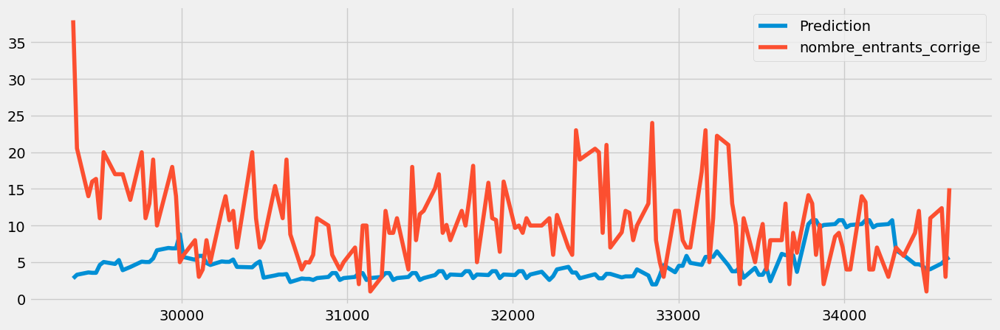

Les noms des features les plus importants pour la famille_entite 'Entite 1_F1':
R2:  -1.367737549890165
MAE:  6.916101276604718
MAPE:  0.6691616625299301
MSE:  74.76934304839297
Meilleurs paramètres :  {'regressor__max_depth': 2, 'regressor__n_estimators': 100}


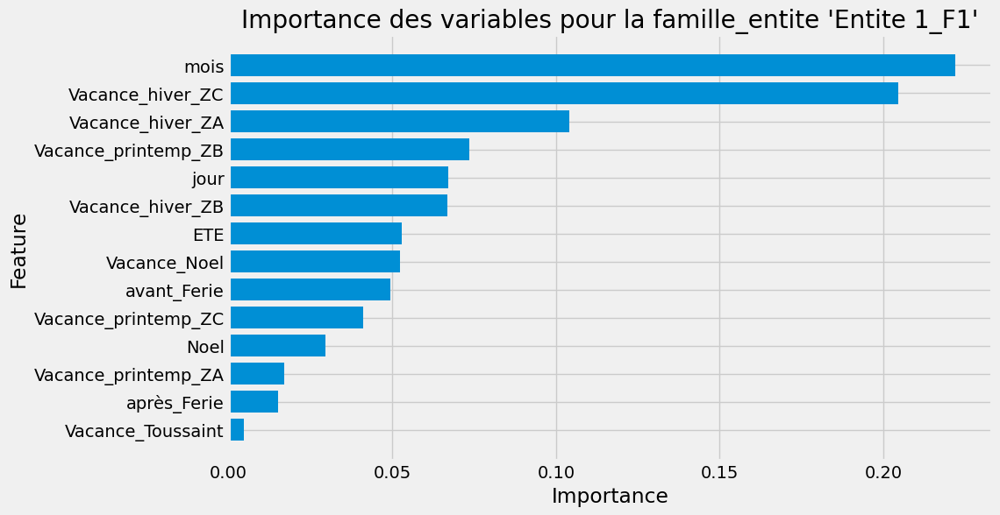

/home/ha-brek/miniconda3/envs/env_Data_Analyst/lib/python3.10/site-packages/sklearn/model_selection/_validation.py:776: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/home/ha-brek/miniconda3/envs/env_Data_Analyst/lib/python3.10/site-packages/sklearn/model_selection/_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/home/ha-brek/miniconda3/envs/env_Data_Analyst/lib/python3.10/site-packages/sklearn/metrics/_scorer.py", line 220, in __call__
    return self._score(
  File "/home/ha-brek/miniconda3/envs/env_Data_Analyst/lib/python3.10/site-packages/sklearn/metrics/_scorer.py", line 262, in _score
    y_pred = method_caller(estimator, "predict", X)
  File "/home/ha-brek/miniconda3/envs/env_Data_Analyst/lib/python3.10/site-packages/sklearn/metrics/_scorer.py", line 72, in _cached_call
    return getattr(estimator, method)(*args, **kwarg

['False' 'True']


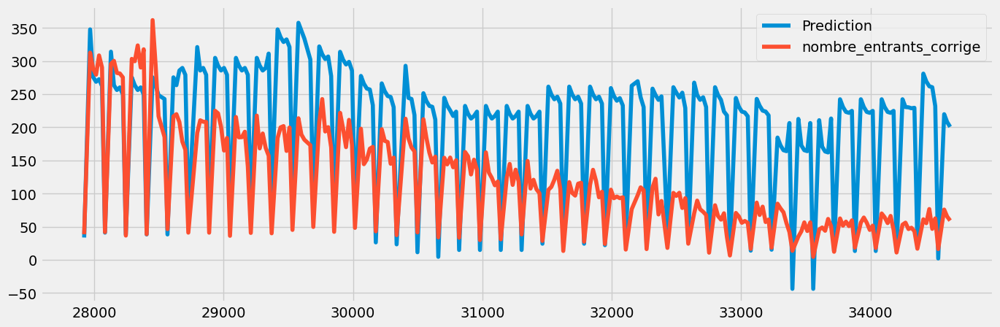

Les noms des features les plus importants pour la famille_entite 'Entite 1_F2':
R2:  -1.1895178946166332
MAE:  101.0833248787929
MAPE:  1.2940502575796218
MSE:  13559.612243098325
Meilleurs paramètres :  {'regressor__max_depth': 2, 'regressor__n_estimators': 100}


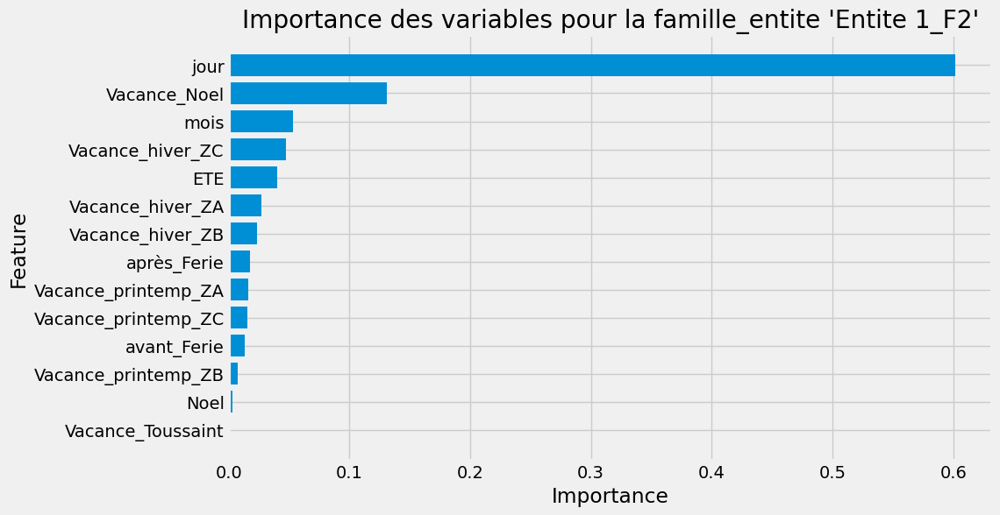

/home/ha-brek/miniconda3/envs/env_Data_Analyst/lib/python3.10/site-packages/sklearn/model_selection/_validation.py:776: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/home/ha-brek/miniconda3/envs/env_Data_Analyst/lib/python3.10/site-packages/sklearn/model_selection/_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/home/ha-brek/miniconda3/envs/env_Data_Analyst/lib/python3.10/site-packages/sklearn/metrics/_scorer.py", line 220, in __call__
    return self._score(
  File "/home/ha-brek/miniconda3/envs/env_Data_Analyst/lib/python3.10/site-packages/sklearn/metrics/_scorer.py", line 262, in _score
    y_pred = method_caller(estimator, "predict", X)
  File "/home/ha-brek/miniconda3/envs/env_Data_Analyst/lib/python3.10/site-packages/sklearn/metrics/_scorer.py", line 72, in _cached_call
    return getattr(estimator, method)(*args, **kwarg

['False' 'True']


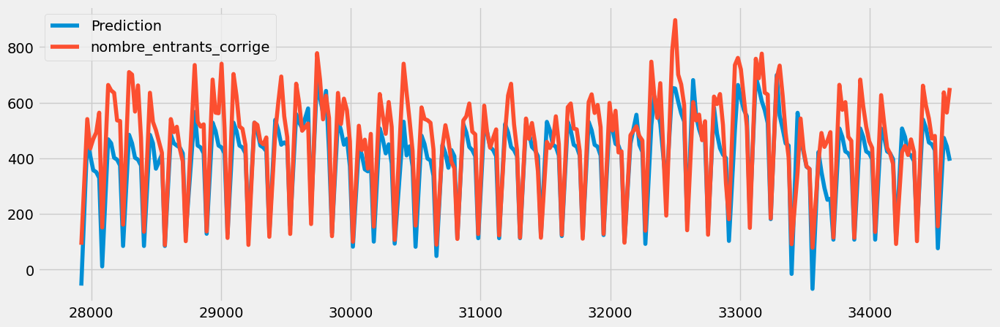

Les noms des features les plus importants pour la famille_entite 'Entite 1_F3':
R2:  0.6815020265624249
MAE:  80.53411404937344
MAPE:  0.18557733906467808
MSE:  10722.484605208152
Meilleurs paramètres :  {'regressor__max_depth': 2, 'regressor__n_estimators': 100}


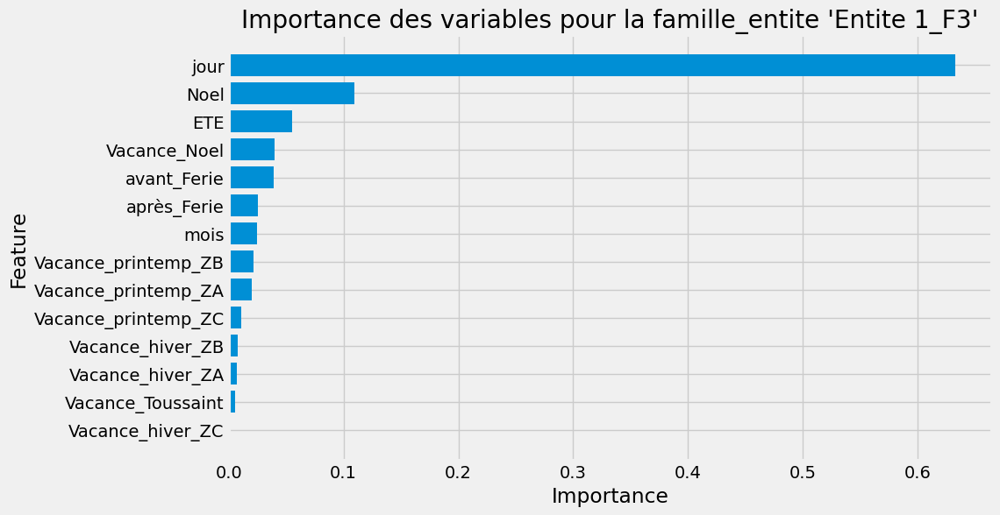

/home/ha-brek/miniconda3/envs/env_Data_Analyst/lib/python3.10/site-packages/sklearn/model_selection/_validation.py:776: UserWarning: Scoring failed. The score on this train-test partition for these parameters will be set to nan. Details: 
Traceback (most recent call last):
  File "/home/ha-brek/miniconda3/envs/env_Data_Analyst/lib/python3.10/site-packages/sklearn/model_selection/_validation.py", line 767, in _score
    scores = scorer(estimator, X_test, y_test)
  File "/home/ha-brek/miniconda3/envs/env_Data_Analyst/lib/python3.10/site-packages/sklearn/metrics/_scorer.py", line 220, in __call__
    return self._score(
  File "/home/ha-brek/miniconda3/envs/env_Data_Analyst/lib/python3.10/site-packages/sklearn/metrics/_scorer.py", line 262, in _score
    y_pred = method_caller(estimator, "predict", X)
  File "/home/ha-brek/miniconda3/envs/env_Data_Analyst/lib/python3.10/site-packages/sklearn/metrics/_scorer.py", line 72, in _cached_call
    return getattr(estimator, method)(*args, **kwarg

['False' 'True']


ValueError: Found unknown categories ['deuxieme_semaine', 'setieme_semaine'] in column 4 during transform

In [ ]:
import datetime
import pandas as pd
import xgboost as xgb
import matplotlib.pyplot as plt
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import OneHotEncoder, OrdinalEncoder
from sklearn.model_selection import TimeSeriesSplit, GridSearchCV
from sklearn.metrics import accuracy_score, r2_score
from sklearn.metrics import mean_squared_error, mean_absolute_error, mean_absolute_percentage_error



# Convertir la colonne "date" en objets datetime
df_all['date'] = pd.to_datetime(df_all['date'])
# Définir la date initiale
date_initiale = datetime.datetime(2022, 4, 29)

# Parcourir chaque groupe de famille_entite
for famille_entite, group_df in df_all.groupby('famille_entite'):
    # Séparer les données en ensemble d'entraînement et ensemble de test
    train_df = group_df.loc[group_df['date'] <= date_initiale]
    test_df = group_df.loc[group_df['date'] > date_initiale]
    
    # Séparer les caractéristiques et la variable cible
    X_train = train_df.drop(['date','nombre_entrants_corrige','famille_entite'], axis=1)
    X_test = test_df.drop(['date','nombre_entrants_corrige','famille_entite'], axis=1)
    y_train = train_df['nombre_entrants_corrige']
    y_test = test_df['nombre_entrants_corrige']

    # Définir les colonnes catégorielles
    cols = X_train.columns  # Ajoutez d'autres colonnes catégorielles si nécessaire

    # Créer un pipeline pour l'encodage des colonnes catégorielles et l'entraînement du modèle
    pipeline = Pipeline([
        ('encoding', ColumnTransformer([
            ('onehot', OrdinalEncoder(), cols)
        ], remainder='passthrough')),
        ('regressor', xgb.XGBRegressor())
    ])

    # Définir les paramètres de la recherche de grille
    param_grid = {
        'regressor__n_estimators': [100],
        'regressor__max_depth': [2,3],
        # 'regressor__learning_rate': [0.3,0.4,0.5]
    }

    # Créer l'objet TimeSeriesSplit
    tscv = TimeSeriesSplit(n_splits=5)

    # Créer l'objet GridSearchCV
    grid_search = GridSearchCV(pipeline, param_grid, cv=tscv, scoring='neg_mean_absolute_percentage_error', n_jobs=-1)

    # Entraîner le modèle avec la recherche de grille
    grid_search.fit(X_train, y_train)

    # Obtenir le meilleur modèle
    best_model = grid_search.best_estimator_
    print(X_test.après_Ferie.unique())
    # Prédire les valeurs pour l'ensemble de test
    y_pred = best_model.predict(X_test)

    # Tracer les prédictions et les valeurs réelles
    test_df['Prediction'] = y_pred
    test_df[['Prediction', 'nombre_entrants_corrige']].plot(figsize=(15, 5))
    plt.show()

    # Obtenir l'importance des caractéristiques
    importance = best_model.named_steps['regressor'].feature_importances_

    # Obtenir les noms des features après l'encodage
    encoded_feature_names = best_model.named_steps['encoding'].transformers_[0][1].get_feature_names_out(cols)

    # Créer un DataFrame avec les noms des features et leur importance
    feature_importance_df = pd.DataFrame({'Feature': encoded_feature_names, 'Importance': importance})

    # Trier les features par importance décroissante
    feature_importance_df = feature_importance_df.sort_values('Importance', ascending=True).reset_index(drop=True)

    # Afficher les noms des features les plus importants
    print(f"Les noms des features les plus importants pour la famille_entite '{famille_entite}':")
   # Afficher le meilleur score
    print('R2: ', r2_score(y_test,  y_pred  ))

    print('MAE: ', mean_absolute_error(y_test,  y_pred  ))
    print('MAPE: ', mean_absolute_percentage_error(y_test,  y_pred  ))
    print('MSE: ', mean_squared_error(y_test,  y_pred  ))
    # Afficher les meilleurs paramètres
    print("Meilleurs paramètres : ", grid_search.best_params_)

    # Tracer le barplot des features les plus importants
    plt.figure(figsize=(10, 6))
    plt.barh(feature_importance_df['Feature'], feature_importance_df['Importance'])
    plt.xlabel('Importance')
    plt.ylabel('Feature')
    plt.title(f"Importance des variables pour la famille_entite '{famille_entite}'")
    plt.show()